#### Author: Adam Van Etten - June 2021

# Notebook for training, testing a model for SkyScan with YOLTv4

Apply YOLTv4 (https://github.com/cosmiq/yoltv4) to SkyScan data. 


The dataset used here has only aircraft type labels, no bounding boxes.  So we will use our  pre-trained binary aircraft detector (see yoltv4_skyscan_initial_pipeline.ipynb) to extract bounding boxes.  Then add the aircraft type label to the data and train a multi-class detector.

This notebook is assumed to be running in a the yoltv4 docker environment

Download YOLO data from AWS instance:

    scp -i /xxx/skyscan.pem ubuntu@xxx.xxx.xxx.xxx:/home/ubuntu/SkyScan-Private/ml-model/dataset-export/322images-training.tar.gz .
 
    scp -i /ccc/skyscan.pem ubuntu@xxx.xxx.xxx.xxx:/home/ubuntu/SkyScan-Private/ml-model/dataset-export/24287images-norm-model.tar.gz .

Run notebooks on gpu server with yoltv4_image

    cd /local_data/cosmiq/src/avanetten/yoltv4/docker
    nvidia-docker build -t yoltv4_image2 .
    nvidia-docker run -it -v /local_data/cosmiq/wdata/avanetten/skyscan/:/local_data/cosmiq/wdata/avanetten/skyscan/ -v /local_data/cosmiq/src/avanetten/yoltv4:/local_data/cosmiq/src/avanetten/yoltv4  -p 9119:9119 -ti --ipc=host --name yoltv4_skyscan yoltv4_image2

within docker on gpu server

    conda activate yoltv4
    cd /local_data/cosmiq/wdata/avanetten/skyscan/
    jupyter notebook --ip 0.0.0.0 --port=9119 --no-browser --allow-root &
    # locally in browser
    http://xxx.xxx.xxx.xxx:9119

In [2]:
from shapely.affinity import translate
from shapely.geometry import box
import matplotlib.pyplot as plt
from shapely.wkt import loads
from imp import reload
import geopandas as gpd
from tqdm import tqdm
import pandas as pd
import numpy as np
import collections
import skimage.io
import operator
import shapely
import random
import shutil
import time
import imp
import cv2
import sys
import os

yoltv4_path = '/local_data/cosmiq/src/avanetten/yoltv4/'
sys.path.append(os.path.join(yoltv4_path, 'yoltv4'))
import prep_train
import tile_ims_labels
import post_process
import eval
import eval_errors

# set dataset path
data_root = '/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model'

------
# Data Explore

In [3]:
# copy object names into output directory
objnames = os.path.join(data_root, 'raw_init', 'obj.names')

d0 = os.path.join(data_root, 'phase2', 'test', 'txt')
d1 = os.path.join(data_root, 'phase2', 'train', 'txt')
os.makedirs(d0, exist_ok=True)
os.makedirs(d1, exist_ok=True)
outpath0 = os.path.join(d0, 'skyscan_phase2_23cat.names')
outpath1 = os.path.join(d1, 'skyscan_phase2_23cat.names')
outpath_yolt = os.path.join(yoltv4_path, 'darknet', 'data', 'skyscan_phase2_23cat.names')

shutil.copyfile(objnames, outpath0)
shutil.copyfile(objnames, outpath1)
shutil.copyfile(objnames, outpath_yolt)
# !cp {objnames} {outpath0}
# !cp {objnames} {outpath1}
# !cp {objnames} {outpath1}

# create dict of integer to names
name_dict = {}
with open(objnames) as f:
    for i,line in enumerate(f):
        name_dict[int(i)] = line.strip()
print("name_dict:", name_dict)

print("\noutpath_yolt:", outpath_yolt)
!cat {outpath_yolt}

name_dict: {0: 'Cessna_Jet', 1: '737-700', 2: 'A321', 3: '737-900', 4: 'ERJ-170', 5: '737-800', 6: 'A320', 7: 'EMB-505', 8: 'CRJ900', 9: '757-200', 10: 'CRJ550', 11: 'EMB-135', 12: 'Gulfstream', 13: 'A319', 14: 'Bombardier_Challanger', 15: 'CRJ700', 16: 'Learjet_45slash60', 17: 'Pilatus_PC-12', 18: '787-800', 19: 'Hawker', 20: 'Falcon', 21: '777-200', 22: 'King_Air'}

outpath_yolt: /local_data/cosmiq/src/avanetten/yoltv4/darknet/data/skyscan_phase2_23cat.names
Cessna_Jet
737-700
A321
737-900
ERJ-170
737-800
A320
EMB-505
CRJ900
757-200
CRJ550
EMB-135
Gulfstream
A319
Bombardier_Challanger
CRJ700
Learjet_45slash60
Pilatus_PC-12
787-800
Hawker
Falcon
777-200
King_Air


In [4]:
# First make a csv of the category labels  for each image in the new, larger dataset
raw_dir = os.path.join(data_root, 'raw_init', 'data')
dir_csv = os.path.join(data_root, 'phase1', 'csvs')
os.makedirs(dir_csv, exist_ok=True)
outfile = os.path.join(dir_csv, 'df_image_cats.csv')

if not os.path.exists(outfile):
    label_list = []
    txt_files = sorted([z for z in os.listdir(raw_dir) if z.endswith('.txt')])
    for i,txt_file in enumerate(txt_files):
        name_root = txt_file.split('.')[0]
        df_tmp = pd.read_csv(os.path.join(raw_dir, txt_file), sep=' ')
        # get category
        cat = int(df_tmp.columns[0])
        label_list.append([name_root, cat])

    # save to csv
    df = pd.DataFrame(label_list, columns=['file', 'category'])
    prefixes = [z.split('_')[0] for z in df['file']]
    df['prefix'] = prefixes
    cat_str = [name_dict[z] for z in df['category']]
    df['category_str'] = cat_str
    df.to_csv(outfile, index=False)
else:
    df = pd.read_csv(outfile)
    
print("outfile:", outfile)
print("N images:", len(df))

!head {outfile}

outfile: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase1/csvs/df_image_cats.csv
N images: 24596
file,category,prefix,category_str
0C2068_2021-03-30-15-04-19,5,0C2068,737-800
0C2068_2021-03-30-15-04-20,5,0C2068,737-800
0C2068_2021-03-30-15-04-21,5,0C2068,737-800
0C2068_2021-03-30-15-04-22,5,0C2068,737-800
0C2068_2021-03-30-15-04-23,5,0C2068,737-800
0C2068_2021-03-30-15-04-24,5,0C2068,737-800
0C2068_2021-03-30-15-04-25,5,0C2068,737-800
0C2068_2021-03-30-15-04-26,5,0C2068,737-800
0C2068_2021-03-30-15-04-27,5,0C2068,737-800


In [5]:
# get stats
# get unique tracks
unique_tracks = np.unique(df['prefix'].values)
print("N unique tracks:", len(unique_tracks))
print("mean obs per track:", 1.0 * len(df) / len(unique_tracks))

print("\nprefixes")
display(df['prefix'].value_counts())

# print("categories")
# display(df['category'].value_counts())

print("categories_str")
display(df['category_str'].value_counts())

N unique tracks: 284
mean obs per track: 86.6056338028169

prefixes


AA3226    221
A967AE    193
AAC3F4    191
A70F88    189
A3F133    188
         ... 
A8996B     17
a14ad1     10
A9739C      9
A85185      9
a2925a      4
Name: prefix, Length: 284, dtype: int64

categories_str


A320                     6210
ERJ-170                  5384
A321                     2247
737-800                  1998
A319                     1269
Cessna_Jet               1243
737-900                  1033
CRJ900                    871
737-700                   731
Bombardier_Challanger     581
EMB-135                   526
Gulfstream                367
CRJ700                    314
787-800                   274
EMB-505                   269
Learjet_45slash60         221
Hawker                    217
757-200                   189
CRJ550                    186
Pilatus_PC-12             176
777-200                   172
King_Air                   62
Falcon                     56
Name: category_str, dtype: int64

In [6]:
# get counts of unique prefixes per category_str
pd.set_option('display.max_rows', 400)
df.groupby(['category_str', 'prefix']).agg('count')

file  category
category_str          prefix                
737-700               A2536F   109       109
                      A2C336    60        60
                      A302A0    90        90
                      A5540C   109       109
                      A5F976    79        79
                      A9807D    76        76
                      AD5817   112       112
                      aa9ef9    96        96
737-800               0C2068   115       115
                      A03618    46        46
                      A28928   155       155
                      A43EA6   116       116
                      AAA616   100       100
                      AB8112    71        71
                      ABAE2C    67        67
                      ABC292    82        82
                      ABF29F   111       111
                      AC0A22   102       102
                      ACBF63    64        64
                      ACD964    97        97
                      ACF975   100       100
                      AD34B3    42        42
                      ADAB31   109       109
                      a14ad1    10        10
                      a3ef1b    77        77
                      a43ee5    86        86
                      a4417d    96        96
                      a9d5e5    65        65
                      aa5691    57        57
                      aa56b6    70        70
                      abd5bb    87        87
                      abe3c8    73        73
737-900               A3CF6D    94        94
                      A41E90   112       112
                      A81006   112       112
                      A85F29    78        78
                      A8AD4E    94        94
                      A92362    75        75
                      A923A7    86        86
                      A94BFF    58        58
                      AA2BA4   187       187
                      AC85CE    95        95
                      abf6ae    42        42
757-200               A70F88   189       189
777-200               AA8A83    76        76
                      AA9801    96        96
787-800               406F3B    97        97
                      4071C0   177       177
A319                  A33325    71        71
                      A4AFBE   110       110
                      A9653D    84        84
                      A9819B   101       101
                      A9854E   185       185
                      A997E5    99        99
                      A9A91A   100       100
                      A9D44C    84        84
                      AA3226   221       221
                      ac760d    73        73
                      ac791d    72        72
                      ac79c7    69        69
A320                  A011AC    72        72
                      A01567    77        77
                      A027FA    61        61
                      A02E0A    37        37
                      A031BD    53        53
                      A0480B    99        99
                      A04BBE   187       187
                      A060AE    72        72
                      A0681C    97        97
                      A1D4C3   103       103
                      A1E18E    79        79
                      A24789    94        94
                      A287AB    82        82
                      A2DA60    64        64
                      A3475E    96        96
                      A34B15    92        92
                      A36A13   104       104
                      A39E7E    77        77
                      A3C5FD    94        94
                      A3D425    96        96
                      A3DB93    91        91
                      A3ECC8    91        91
                      A3F133   188       188
                      A3FBA4    56        56
                      A40CD9    81        81
                      A43C7A   102       102
                      A58A29    82        82
                      A61

In [7]:
# get counts of unique prefixes per category_str
pd.set_option('display.max_rows', 32)
print("Unique prefixes per category:")
df.groupby('category_str')['prefix'].nunique()

Unique prefixes per category:


category_str
737-700                   8
737-800                  24
737-900                  11
757-200                   1
777-200                   2
787-800                   2
A319                     12
A320                     71
A321                     25
Bombardier_Challanger     8
CRJ550                    2
CRJ700                    5
CRJ900                    9
Cessna_Jet               14
EMB-135                   8
EMB-505                   5
ERJ-170                  62
Falcon                    1
Gulfstream                6
Hawker                    2
King_Air                  1
Learjet_45slash60         3
Pilatus_PC-12             2
Name: prefix, dtype: int64

-------
# Phase 1

Assume a binary detection model has already been trained, see yoltv4_skyscan_initial_pipeline.ipynb

In [8]:
# get set of images used to train/validate the phase0 binary model (we don't want to test on these!)
phase1_train_ims_path = '/local_data/cosmiq/wdata/avanetten/skyscan/data/322images-training/txt/skyscan_binary_train.txt'
df_phase0_train = pd.read_csv(phase1_train_ims_path, names=['path'])
im_roots = [z.split('/')[-1].split('.')[0] for z in df_phase0_train['path']]
df_phase0_train['im_root'] = im_roots
display(df_phase0_train)
df_phase0_train_set = set(df_phase0_train['im_root'].values)
display(df_phase0_train_set)

,path,im_root
0,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,06a080_326_69_10665_2021-05-13-19-46-00
1,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,4850ad_114_72_7953_2021-05-13-17-31-31
2,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,4850ad_152_57_8986_2021-05-13-17-31-52
3,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,4850ad_156_52_9540_2021-05-13-17-32-00
4,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,4850ad_51_69_8090_2021-05-13-17-31-13
...,...,...
201,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,ac791d_317_72_9554_2021-05-13-13-44-15
202,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,ac791d_336_61_10382_2021-05-13-13-44-03
203,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,ac79c7_223_73_10105_2021-05-13-23-16-13
204,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,ac79c7_244_77_9930_2021-05-13-23-16-08


{'06a080_326_69_10665_2021-05-13-19-46-00',
 '4850ad_114_72_7953_2021-05-13-17-31-31',
 '4850ad_152_57_8986_2021-05-13-17-31-52',
 '4850ad_156_52_9540_2021-05-13-17-32-00',
 '4850ad_51_69_8090_2021-05-13-17-31-13',
 '4850ad_68_72_7939_2021-05-13-17-31-19',
 '4d010b_197_58_12808_2021-05-13-20-36-01',
 '4d010b_219_74_11328_2021-05-13-20-35-43',
 '4d010b_238_78_11146_2021-05-13-20-35-38',
 '4d010b_286_79_11096_2021-05-13-20-35-30',
 '4d010b_325_72_11438_2021-05-13-20-35-20',
 '4d010b_338_64_12108_2021-05-13-20-35-11',
 'a06bd3_201_63_12220_2021-05-13-12-29-43',
 'a06bd3_203_66_11989_2021-05-13-12-29-40',
 'a06bd3_205_67_11854_2021-05-13-12-29-38',
 'a06bd3_220_74_11378_2021-05-13-12-29-29',
 'a06bd3_280_79_11141_2021-05-13-12-29-15',
 'a06bd3_286_79_11148_2021-05-13-12-29-14',
 'a06bd3_321_73_11412_2021-05-13-12-29-04',
 'a06bd3_323_73_11456_2021-05-13-12-29-03',
 'a06bd3_338_63_12216_2021-05-13-12-28-51',
 'a10614_205_57_8635_2021-05-13-20-27-10',
 'a10614_217_65_7983_2021-05-13-20-27-03

In [22]:
# run all of this data through the binary aircraft detector to get estimated bounding boxes for aircraft.
# First, prepare testing data

test_ims = os.path.join(data_root, 'raw_init', 'data')

dir_phase = os.path.join(data_root, 'phase1')
dir_txt = os.path.join(dir_phase, 'txt')
os.makedirs(dir_txt, exist_ok=True)

outpath_test_list = os.path.join(dir_txt, 'skyscan_23cat_phase1_test_list.txt')

#################
# make list of test files
im_list_test = []
for f in sorted([z for z in os.listdir(test_ims) if z.endswith('.jpg')]):
    # ensure image is not in phase0
    if f.split('.')[0] not in df_phase0_train_set:
        im_list_test.append(os.path.join(test_ims, f))
    else:
        print("{} in phase0, skipping".format(f))
df_tmp = pd.DataFrame({'image': im_list_test})
df_tmp.to_csv(outpath_test_list, header=False, index=False)
print("N test ims:", len(df_tmp))
!head {outpath_test_list}

#################
# create .data file

outfile = '/local_data/cosmiq/src/avanetten/yoltv4/darknet/data/skyscan_23cat_phase1_test.data'
namefile = '/local_data/cosmiq/src/avanetten/yoltv4/darknet/data/skyscan_binary.name'
class_num = 1
outpath_train_list = ''
outpath_valid_list = outpath_test_list

!echo 'classes = ' {class_num} > {outfile}
!echo 'train = ' {outpath_train_list} >> {outfile}
!echo 'valid = ' {outpath_valid_list} >> {outfile}
!echo 'names = ' {namefile} >> {outfile}
!echo 'backup = backup/' >> {outfile}

print("\nhead:", outfile)
!cat {outfile}

a06bd3_201_63_12220_2021-05-13-12-29-43.jpg in phase0, skipping
a06bd3_203_66_11989_2021-05-13-12-29-40.jpg in phase0, skipping
a06bd3_205_67_11854_2021-05-13-12-29-38.jpg in phase0, skipping
a06bd3_220_74_11378_2021-05-13-12-29-29.jpg in phase0, skipping
a06bd3_280_79_11141_2021-05-13-12-29-15.jpg in phase0, skipping
a06bd3_286_79_11148_2021-05-13-12-29-14.jpg in phase0, skipping
a06bd3_321_73_11412_2021-05-13-12-29-04.jpg in phase0, skipping
a06bd3_323_73_11456_2021-05-13-12-29-03.jpg in phase0, skipping
a06bd3_338_63_12216_2021-05-13-12-28-51.jpg in phase0, skipping
a10614_205_57_8635_2021-05-13-20-27-10.jpg in phase0, skipping
a10614_217_65_7983_2021-05-13-20-27-03.jpg in phase0, skipping
a10614_254_74_7568_2021-05-13-20-26-54.jpg in phase0, skipping
a11eb7_215_69_9704_2021-05-13-11-17-48.jpg in phase0, skipping
a11eb7_224_72_9508_2021-05-13-11-17-44.jpg in phase0, skipping
a11eb7_275_77_9303_2021-05-13-11-17-33.jpg in phase0, skipping
a11eb7_321_68_8469_2021-05-13-18-31-13.jpg in 

/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-19.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-20.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-21.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-22.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-23.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-24.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-25.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/raw_init/data/0C2068_2021-03-30-15-04-26.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/r

In [25]:
# post process
reload(post_process)

detection_threshes = [0.6]
slice_size = 0
n_plots = 1000
im_ext='.jpg'
allow_nested_detections = True
raw_im_dir = os.path.join(data_root, 'raw_init/data')
sliced_im_dir = ''  
truth_file_name = ''
outnames = [
            'skyscan_23cat_phase1_test' 
           ]
print("N test images:", len([z for z in os.listdir(raw_im_dir) if z.endswith(im_ext)]))
for outname in outnames:
    for detection_thresh in detection_threshes:
        out_csv = 'preds_refine_' + str(detection_thresh).replace('.', 'p') + '.csv'
        out_geojson_geo_dir = 'geojsons_geo_' + str(detection_thresh).replace('.', 'p')
        out_geojson_pix_dir = 'geojsons_pix_' + str(detection_thresh).replace('.', 'p')
        plot_dir = 'pred_plots_' + str(detection_thresh).replace('.', 'p')
        pred_txt_prefix = outname + '_'
        out_dir_root = os.path.join(yoltv4_path, 'darknet', 'results', outname)
        pred_dir = os.path.join(out_dir_root, 'orig_txt')
        truth_file = '' # os.path.join(data_root, 'test', 'geojsons_pix_comb', truth_file_name)

        # move raw predictions to output dir
        os.makedirs(os.path.join(out_dir_root, 'orig_txt'), exist_ok=True)
        !mv {yoltv4_path}/darknet/results/{outname}*.txt {out_dir_root}/orig_txt/

        # post_process
        post_process.execute(
            pred_dir=pred_dir,
            truth_file=truth_file,
            raw_im_dir=raw_im_dir,
            sliced_im_dir=sliced_im_dir,
            out_dir_root=out_dir_root,
            im_ext=im_ext,
            out_csv=out_csv,
            out_geojson_geo_dir=out_geojson_geo_dir,
            out_geojson_pix_dir=out_geojson_pix_dir,
            plot_dir=plot_dir,
            allow_nested_detections=allow_nested_detections,
            slice_size=slice_size,
            sep='__',
            pred_txt_prefix=pred_txt_prefix,
            n_plots=n_plots,
            detection_thresh=detection_thresh)

N test images: 24596
mv: cannot stat '/local_data/cosmiq/src/avanetten/yoltv4//darknet/results/skyscan_23cat_phase1_test*.txt': No such file or directory
df_raw.head:                       im_name      prob        Xmin        Ymin         Xmax  \
0  0C2068_2021-03-30-15-04-38  0.993834  835.098083  527.095642   981.040344   
1  0C2068_2021-03-30-15-04-38  0.039477  856.436890  537.710022   955.343506   
2  0C2068_2021-03-30-15-04-39  0.291646  682.755737  711.975830   940.131592   
3  0C2068_2021-03-30-15-04-39  0.173374  817.946777  490.202942  1019.765869   
4  0C2068_2021-03-30-15-04-39  0.166279  870.741333  490.018280  1021.506836   

          Ymax  category  
0   685.618347  aircraft  
1   678.225647  aircraft  
2  1036.181152  aircraft  
3   757.782898  aircraft  
4   653.295471  aircraft  
Augmenting dataframe of initial length: 15036 ...
0
10000
Time to augment dataframe of length: 15036 = 0.09388923645019531 seconds
Running refine_df()...
Executing non-max suppression...
  n

  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 3
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 3
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 3
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup


Creating geojsons and plots...
0 / 24596 0C2068_2021-03-30-15-04-19
Making output plot...


/opt/conda/envs/yoltv4/lib/python3.7/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


1 / 24596 0C2068_2021-03-30-15-04-20
Making output plot...
2 / 24596 0C2068_2021-03-30-15-04-21
Making output plot...
3 / 24596 0C2068_2021-03-30-15-04-22
Making output plot...
4 / 24596 0C2068_2021-03-30-15-04-23
Making output plot...
5 / 24596 0C2068_2021-03-30-15-04-24
Making output plot...
6 / 24596 0C2068_2021-03-30-15-04-25
Making output plot...
7 / 24596 0C2068_2021-03-30-15-04-26
Making output plot...
8 / 24596 0C2068_2021-03-30-15-04-27
Making output plot...
9 / 24596 0C2068_2021-03-30-15-04-28
Making output plot...
10 / 24596 0C2068_2021-03-30-15-04-29
Making output plot...
11 / 24596 0C2068_2021-03-30-15-04-30
Making output plot...
12 / 24596 0C2068_2021-03-30-15-04-31
Making output plot...
13 / 24596 0C2068_2021-03-30-15-04-32
Making output plot...
14 / 24596 0C2068_2021-03-30-15-04-33
Making output plot...
15 / 24596 0C2068_2021-03-30-15-04-34
Making output plot...
16 / 24596 0C2068_2021-03-30-15-04-36
Making output plot...
17 / 24596 0C2068_2021-03-30-15-04-37
Making outp

Making output plot...
129 / 24596 406F3B_2021-03-30-18-25-39
 n boxes: 1
Making output plot...
130 / 24596 406F3B_2021-03-30-18-25-40
 n boxes: 1
Making output plot...
131 / 24596 406F3B_2021-03-30-18-25-41
 n boxes: 1
Making output plot...
132 / 24596 406F3B_2021-03-30-18-25-42
 n boxes: 1
Making output plot...
133 / 24596 406F3B_2021-03-30-18-25-43
 n boxes: 1
Making output plot...
134 / 24596 406F3B_2021-03-30-18-25-44
 n boxes: 1
Making output plot...
135 / 24596 406F3B_2021-03-30-18-25-45
 n boxes: 1
Making output plot...
136 / 24596 406F3B_2021-03-30-18-25-46
 n boxes: 1
Making output plot...
137 / 24596 406F3B_2021-03-30-18-25-47
 n boxes: 1
Making output plot...
138 / 24596 406F3B_2021-03-30-18-25-48
 n boxes: 1
Making output plot...
139 / 24596 406F3B_2021-03-30-18-25-49
 n boxes: 1
Making output plot...
140 / 24596 406F3B_2021-03-30-18-25-50
 n boxes: 1
Making output plot...
141 / 24596 406F3B_2021-03-30-18-25-51
 n boxes: 1
Making output plot...
142 / 24596 406F3B_2021-03-30

247 / 24596 4071C0_2021-03-29-21-52-25
 n boxes: 1
Making output plot...
248 / 24596 4071C0_2021-03-29-21-52-26
 n boxes: 1
Making output plot...
249 / 24596 4071C0_2021-03-29-21-52-27
 n boxes: 1
Making output plot...
250 / 24596 4071C0_2021-03-29-21-52-28
 n boxes: 1
Making output plot...
251 / 24596 4071C0_2021-03-29-21-52-29
 n boxes: 1
Making output plot...
252 / 24596 4071C0_2021-03-29-21-52-30
 n boxes: 1
Making output plot...
253 / 24596 4071C0_2021-03-29-21-52-31
 n boxes: 1
Making output plot...
254 / 24596 4071C0_2021-03-29-21-52-32
 n boxes: 1
Making output plot...
255 / 24596 4071C0_2021-03-29-21-52-33
 n boxes: 1
Making output plot...
256 / 24596 4071C0_2021-03-29-21-52-34
 n boxes: 1
Making output plot...
257 / 24596 4071C0_2021-03-29-21-52-35
 n boxes: 1
Making output plot...
258 / 24596 4071C0_2021-03-29-21-52-36
 n boxes: 1
Making output plot...
259 / 24596 4071C0_2021-03-29-21-52-37
 n boxes: 1
Making output plot...
260 / 24596 4071C0_2021-03-29-21-52-38
 n boxes: 1


364 / 24596 4071C0_2021-03-30-21-16-52
Making output plot...
365 / 24596 4071C0_2021-03-30-21-16-53
Making output plot...
366 / 24596 4071C0_2021-03-30-21-16-54
Making output plot...
367 / 24596 4071C0_2021-03-30-21-16-55
Making output plot...
368 / 24596 4071C0_2021-03-30-21-16-56
Making output plot...
369 / 24596 4071C0_2021-03-30-21-16-57
Making output plot...
370 / 24596 4071C0_2021-03-30-21-16-58
Making output plot...
371 / 24596 4071C0_2021-03-30-21-16-59
Making output plot...
372 / 24596 4071C0_2021-03-30-21-17-00
Making output plot...
373 / 24596 4071C0_2021-03-30-21-17-01
Making output plot...
374 / 24596 4071C0_2021-03-30-21-17-02
Making output plot...
375 / 24596 4071C0_2021-03-30-21-17-03
Making output plot...
376 / 24596 4071C0_2021-03-30-21-17-04
Making output plot...
377 / 24596 4071C0_2021-03-30-21-17-05
Making output plot...
378 / 24596 4071C0_2021-03-30-21-17-06
Making output plot...
379 / 24596 4071C0_2021-03-30-21-17-07
Making output plot...
380 / 24596 4071C0_2021-

Making output plot...
489 / 24596 A01097_2021-03-30-19-39-09
 n boxes: 1
Making output plot...
490 / 24596 A01097_2021-03-30-19-39-10
 n boxes: 1
Making output plot...
491 / 24596 A01097_2021-03-30-19-39-11
 n boxes: 1
Making output plot...
492 / 24596 A01097_2021-03-30-19-39-12
 n boxes: 1
Making output plot...
493 / 24596 A01097_2021-03-30-19-39-13
 n boxes: 1
Making output plot...
494 / 24596 A01097_2021-03-30-19-39-14
 n boxes: 1
Making output plot...
495 / 24596 A01097_2021-03-30-19-39-15
 n boxes: 1
Making output plot...
496 / 24596 A01097_2021-03-30-19-39-16
 n boxes: 1
Making output plot...
497 / 24596 A01097_2021-03-30-19-39-17
 n boxes: 1
Making output plot...
498 / 24596 A01097_2021-03-30-19-39-18
 n boxes: 1
Making output plot...
499 / 24596 A01097_2021-03-30-19-39-19
 n boxes: 1
Making output plot...
500 / 24596 A01097_2021-03-30-19-39-20
 n boxes: 1
Making output plot...
501 / 24596 A01097_2021-03-30-19-39-21
 n boxes: 1
Making output plot...
502 / 24596 A01097_2021-03-30

608 / 24596 A011AC_2021-03-30-18-19-26
Making output plot...
609 / 24596 A011AC_2021-03-30-18-19-27
Making output plot...
610 / 24596 A011AC_2021-03-30-18-19-28
Making output plot...
611 / 24596 A011AC_2021-03-30-18-19-29
Making output plot...
612 / 24596 A011AC_2021-03-30-18-19-30
Making output plot...
613 / 24596 A011AC_2021-03-30-18-19-31
Making output plot...
614 / 24596 A0144E_2021-03-30-22-12-16
Making output plot...
615 / 24596 A0144E_2021-03-30-22-12-17
Making output plot...
616 / 24596 A0144E_2021-03-30-22-12-18
Making output plot...
617 / 24596 A0144E_2021-03-30-22-12-19
Making output plot...
618 / 24596 A0144E_2021-03-30-22-12-20
Making output plot...
619 / 24596 A0144E_2021-03-30-22-12-21
Making output plot...
620 / 24596 A0144E_2021-03-30-22-12-22
 n boxes: 1
Making output plot...
621 / 24596 A0144E_2021-03-30-22-12-23
 n boxes: 1
Making output plot...
622 / 24596 A0144E_2021-03-30-22-12-24
 n boxes: 1
Making output plot...
623 / 24596 A0144E_2021-03-30-22-12-25
 n boxes: 

Making output plot...
730 / 24596 A014C9_2021-03-30-14-45-05
 n boxes: 2
Making output plot...
731 / 24596 A014C9_2021-03-30-14-45-06
 n boxes: 2
Making output plot...
732 / 24596 A014C9_2021-03-30-14-45-07
 n boxes: 2
Making output plot...
733 / 24596 A014C9_2021-03-30-14-45-08
 n boxes: 2
Making output plot...
734 / 24596 A014C9_2021-03-30-14-45-09
 n boxes: 2
Making output plot...
735 / 24596 A014C9_2021-03-30-14-45-10
 n boxes: 2
Making output plot...
736 / 24596 A014C9_2021-03-30-14-45-11
 n boxes: 2
Making output plot...
737 / 24596 A014C9_2021-03-30-14-45-12
 n boxes: 2
Making output plot...
738 / 24596 A014C9_2021-03-30-14-45-13
 n boxes: 2
Making output plot...
739 / 24596 A014C9_2021-03-30-14-45-14
 n boxes: 2
Making output plot...
740 / 24596 A014C9_2021-03-30-14-45-15
 n boxes: 2
Making output plot...
741 / 24596 A014C9_2021-03-30-14-45-16
 n boxes: 2
Making output plot...
742 / 24596 A014C9_2021-03-30-14-45-17
 n boxes: 1
Making output plot...
743 / 24596 A014C9_2021-03-30

846 / 24596 A01567_2021-03-30-22-15-31
Making output plot...
847 / 24596 A01567_2021-03-30-22-15-32
Making output plot...
848 / 24596 A01567_2021-03-30-22-15-33
Making output plot...
849 / 24596 A01567_2021-03-30-22-15-34
Making output plot...
850 / 24596 A01567_2021-03-30-22-15-35
Making output plot...
851 / 24596 A01567_2021-03-30-22-15-36
Making output plot...
852 / 24596 A01567_2021-03-30-22-15-37
Making output plot...
853 / 24596 A01567_2021-03-30-22-15-38
Making output plot...
854 / 24596 A01567_2021-03-30-22-15-39
Making output plot...
855 / 24596 A01567_2021-03-30-22-15-40
Making output plot...
856 / 24596 A01567_2021-03-30-22-15-41
Making output plot...
857 / 24596 A01567_2021-03-30-22-15-42
Making output plot...
858 / 24596 A01567_2021-03-30-22-15-43
Making output plot...
859 / 24596 A01567_2021-03-30-22-15-44
Making output plot...
860 / 24596 A01567_2021-03-30-22-15-45
Making output plot...
861 / 24596 A01567_2021-03-30-22-15-46
Making output plot...
862 / 24596 A01567_2021-

973 / 24596 A01BBC_2021-03-29-20-48-02
 n boxes: 1
Making output plot...
974 / 24596 A01BBC_2021-03-29-20-48-03
 n boxes: 1
Making output plot...
975 / 24596 A01BBC_2021-03-29-20-48-04
 n boxes: 1
Making output plot...
976 / 24596 A01BBC_2021-03-29-20-48-05
 n boxes: 1
Making output plot...
977 / 24596 A01BBC_2021-03-29-20-48-06
 n boxes: 1
Making output plot...
978 / 24596 A01BBC_2021-03-29-20-48-07
 n boxes: 1
Making output plot...
979 / 24596 A01BBC_2021-03-29-20-48-08
 n boxes: 1
Making output plot...
980 / 24596 A01BBC_2021-03-29-20-48-09
 n boxes: 1
Making output plot...
981 / 24596 A01BBC_2021-03-29-20-48-10
 n boxes: 1
Making output plot...
982 / 24596 A01BBC_2021-03-29-20-48-11
 n boxes: 1
Making output plot...
983 / 24596 A01BBC_2021-03-29-20-48-12
 n boxes: 1
Making output plot...
984 / 24596 A01BBC_2021-03-29-20-48-13
 n boxes: 1
Making output plot...
985 / 24596 A01BBC_2021-03-29-20-48-14
 n boxes: 1
Making output plot...
986 / 24596 A01BBC_2021-03-29-20-48-15
 n boxes: 1


1132 / 24596 A027FA_2021-03-30-12-22-27
1133 / 24596 A027FA_2021-03-30-12-22-28
1134 / 24596 A027FA_2021-03-30-12-22-29
1135 / 24596 A027FA_2021-03-30-12-22-30
1136 / 24596 A027FA_2021-03-30-12-22-31
1137 / 24596 A027FA_2021-03-30-12-22-32
1138 / 24596 A027FA_2021-03-30-12-22-33
1139 / 24596 A027FA_2021-03-30-12-22-34
1140 / 24596 A027FA_2021-03-30-12-22-35
1141 / 24596 A027FA_2021-03-30-12-22-36
1142 / 24596 A027FA_2021-03-30-12-22-37
1143 / 24596 A027FA_2021-03-30-12-22-38
 n boxes: 1
1144 / 24596 A027FA_2021-03-30-12-22-39
1145 / 24596 A027FA_2021-03-30-12-22-40
1146 / 24596 A027FA_2021-03-30-12-22-41
 n boxes: 1
1147 / 24596 A027FA_2021-03-30-12-22-42
1148 / 24596 A027FA_2021-03-30-12-22-43
 n boxes: 1
1149 / 24596 A027FA_2021-03-30-12-22-44
1150 / 24596 A027FA_2021-03-30-12-22-45
1151 / 24596 A027FA_2021-03-30-12-22-46
1152 / 24596 A027FA_2021-03-30-12-22-47
1153 / 24596 A027FA_2021-03-30-12-22-48
1154 / 24596 A027FA_2021-03-30-12-22-49
 n boxes: 1
1155 / 24596 A027FA_2021-03-30-1

1310 / 24596 A031BD_2021-03-30-14-47-03
 n boxes: 2
1311 / 24596 A031BD_2021-03-30-14-47-04
 n boxes: 1
1312 / 24596 A031BD_2021-03-30-14-47-05
 n boxes: 1
1313 / 24596 A031BD_2021-03-30-14-47-06
 n boxes: 1
1314 / 24596 A031BD_2021-03-30-14-47-07
 n boxes: 1
1315 / 24596 A031BD_2021-03-30-14-47-08
 n boxes: 1
1316 / 24596 A031BD_2021-03-30-14-47-09
 n boxes: 1
1317 / 24596 A031BD_2021-03-30-14-47-10
 n boxes: 1
1318 / 24596 A031BD_2021-03-30-14-47-11
 n boxes: 1
1319 / 24596 A031BD_2021-03-30-14-47-12
 n boxes: 1
1320 / 24596 A031BD_2021-03-30-14-47-13
 n boxes: 2
1321 / 24596 A031BD_2021-03-30-14-47-14
 n boxes: 2
1322 / 24596 A031BD_2021-03-30-14-47-15
 n boxes: 2
1323 / 24596 A031BD_2021-03-30-14-47-16
 n boxes: 1
1324 / 24596 A031BD_2021-03-30-14-47-17
 n boxes: 2
1325 / 24596 A031BD_2021-03-30-14-47-18
 n boxes: 1
1326 / 24596 A031BD_2021-03-30-14-47-19
 n boxes: 2
1327 / 24596 A031BD_2021-03-30-14-47-20
 n boxes: 1
1328 / 24596 A031BD_2021-03-30-14-47-21
 n boxes: 1
1329 / 24596

1486 / 24596 A0480B_2021-03-30-16-35-21
1487 / 24596 A0480B_2021-03-30-16-35-22
1488 / 24596 A0480B_2021-03-30-16-35-23
 n boxes: 1
1489 / 24596 A0480B_2021-03-30-16-35-24
 n boxes: 2
1490 / 24596 A0480B_2021-03-30-16-35-25
 n boxes: 2
1491 / 24596 A0480B_2021-03-30-16-35-26
 n boxes: 2
1492 / 24596 A0480B_2021-03-30-16-35-27
 n boxes: 2
1493 / 24596 A0480B_2021-03-30-16-35-28
 n boxes: 1
1494 / 24596 A0480B_2021-03-30-16-35-29
 n boxes: 1
1495 / 24596 A0480B_2021-03-30-16-35-30
 n boxes: 1
1496 / 24596 A0480B_2021-03-30-16-35-31
 n boxes: 1
1497 / 24596 A0480B_2021-03-30-16-35-32
 n boxes: 1
1498 / 24596 A0480B_2021-03-30-16-35-33
 n boxes: 2
1499 / 24596 A0480B_2021-03-30-16-35-34
 n boxes: 2
1500 / 24596 A0480B_2021-03-30-16-35-35
 n boxes: 1
1501 / 24596 A0480B_2021-03-30-16-35-36
 n boxes: 1
1502 / 24596 A0480B_2021-03-30-16-35-37
 n boxes: 1
1503 / 24596 A0480B_2021-03-30-16-35-38
 n boxes: 2
1504 / 24596 A0480B_2021-03-30-16-35-39
 n boxes: 1
1505 / 24596 A0480B_2021-03-30-16-35

1672 / 24596 A04BBE_2021-03-30-22-10-19
1673 / 24596 A04BBE_2021-03-30-22-10-20
1674 / 24596 A04BBE_2021-03-30-22-10-21
 n boxes: 1
1675 / 24596 A04BBE_2021-03-30-22-10-22
 n boxes: 1
1676 / 24596 A04BBE_2021-03-30-22-10-23
 n boxes: 1
1677 / 24596 A04BBE_2021-03-30-22-10-24
 n boxes: 1
1678 / 24596 A04BBE_2021-03-30-22-10-25
 n boxes: 1
1679 / 24596 A04BBE_2021-03-30-22-10-26
 n boxes: 1
1680 / 24596 A04BBE_2021-03-30-22-10-27
 n boxes: 1
1681 / 24596 A04BBE_2021-03-30-22-10-28
 n boxes: 1
1682 / 24596 A04BBE_2021-03-30-22-10-29
 n boxes: 1
1683 / 24596 A04BBE_2021-03-30-22-10-30
 n boxes: 1
1684 / 24596 A04BBE_2021-03-30-22-10-31
 n boxes: 1
1685 / 24596 A04BBE_2021-03-30-22-10-32
 n boxes: 1
1686 / 24596 A04BBE_2021-03-30-22-10-33
 n boxes: 2
1687 / 24596 A04BBE_2021-03-30-22-10-34
 n boxes: 1
1688 / 24596 A04BBE_2021-03-30-22-10-35
 n boxes: 1
1689 / 24596 A04BBE_2021-03-30-22-10-36
 n boxes: 1
1690 / 24596 A04BBE_2021-03-30-22-10-37
 n boxes: 1
1691 / 24596 A04BBE_2021-03-30-22-10

1854 / 24596 A0681C_2021-03-30-14-29-19
 n boxes: 2
1855 / 24596 A0681C_2021-03-30-14-29-20
 n boxes: 2
1856 / 24596 A0681C_2021-03-30-14-29-21
 n boxes: 1
1857 / 24596 A0681C_2021-03-30-14-29-22
 n boxes: 1
1858 / 24596 A0681C_2021-03-30-14-29-23
 n boxes: 1
1859 / 24596 A0681C_2021-03-30-14-29-24
 n boxes: 2
1860 / 24596 A0681C_2021-03-30-14-29-25
 n boxes: 1
1861 / 24596 A0681C_2021-03-30-14-29-26
 n boxes: 1
1862 / 24596 A0681C_2021-03-30-14-29-27
 n boxes: 2
1863 / 24596 A0681C_2021-03-30-14-29-28
 n boxes: 1
1864 / 24596 A0681C_2021-03-30-14-29-29
 n boxes: 1
1865 / 24596 A0681C_2021-03-30-14-29-30
 n boxes: 2
1866 / 24596 A0681C_2021-03-30-14-29-31
 n boxes: 2
1867 / 24596 A0681C_2021-03-30-14-29-32
 n boxes: 2
1868 / 24596 A0681C_2021-03-30-14-29-33
 n boxes: 2
1869 / 24596 A0681C_2021-03-30-14-29-34
 n boxes: 1
1870 / 24596 A0681C_2021-03-30-14-29-35
 n boxes: 1
1871 / 24596 A0681C_2021-03-30-14-29-36
 n boxes: 1
1872 / 24596 A0681C_2021-03-30-14-29-37
 n boxes: 1
1873 / 24596

2035 / 24596 A06E71_2021-03-30-16-43-51
2036 / 24596 A06E71_2021-03-30-16-43-52
2037 / 24596 A06E71_2021-03-30-16-43-53
2038 / 24596 A06E71_2021-03-30-16-43-54
2039 / 24596 A06E71_2021-03-30-16-43-55
 n boxes: 1
2040 / 24596 A06E71_2021-03-30-16-43-56
2041 / 24596 A06E71_2021-03-30-16-43-57
2042 / 24596 A06E71_2021-03-30-16-43-58
2043 / 24596 A06E71_2021-03-30-16-43-59
2044 / 24596 A06E71_2021-03-30-16-44-00
 n boxes: 1
2045 / 24596 A06E71_2021-03-30-16-44-01
2046 / 24596 A06E71_2021-03-30-16-44-02
2047 / 24596 A06E71_2021-03-30-16-44-03
2048 / 24596 A06E71_2021-03-30-16-44-04
2049 / 24596 A06E71_2021-03-30-16-44-05
 n boxes: 1
2050 / 24596 A06E71_2021-03-30-16-44-06
2051 / 24596 A06E71_2021-03-30-16-44-07
2052 / 24596 A06E71_2021-03-30-16-44-08
2053 / 24596 A06E71_2021-03-30-16-44-09
 n boxes: 1
2054 / 24596 A06E71_2021-03-30-16-44-10
2055 / 24596 A06E71_2021-03-30-16-44-11
2056 / 24596 A06E71_2021-03-30-16-44-12
2057 / 24596 A06E71_2021-03-30-16-44-13
 n boxes: 1
2058 / 24596 A06E71_

2223 / 24596 A07FA6_2021-03-30-20-11-47
 n boxes: 1
2224 / 24596 A07FA6_2021-03-30-20-11-48
 n boxes: 1
2225 / 24596 A07FA6_2021-03-30-20-11-49
 n boxes: 1
2226 / 24596 A07FA6_2021-03-30-20-11-50
 n boxes: 1
2227 / 24596 A07FA6_2021-03-30-20-11-51
 n boxes: 1
2228 / 24596 A07FA6_2021-03-30-20-11-52
 n boxes: 1
2229 / 24596 A07FA6_2021-03-30-20-11-53
 n boxes: 1
2230 / 24596 A07FA6_2021-03-30-20-11-54
 n boxes: 1
2231 / 24596 A07FA6_2021-03-30-20-11-55
 n boxes: 1
2232 / 24596 A07FA6_2021-03-30-20-11-56
 n boxes: 1
2233 / 24596 A07FA6_2021-03-30-20-11-57
 n boxes: 1
2234 / 24596 A07FA6_2021-03-30-20-11-58
 n boxes: 1
2235 / 24596 A07FA6_2021-03-30-20-11-59
 n boxes: 1
2236 / 24596 A07FA6_2021-03-30-20-12-00
 n boxes: 1
2237 / 24596 A07FA6_2021-03-30-20-12-01
 n boxes: 1
2238 / 24596 A07FA6_2021-03-30-20-12-02
 n boxes: 1
2239 / 24596 A07FA6_2021-03-30-20-12-03
 n boxes: 1
2240 / 24596 A07FA6_2021-03-30-20-12-04
 n boxes: 1
2241 / 24596 A07FA6_2021-03-30-20-12-05
 n boxes: 1
2242 / 24596

2408 / 24596 A0DAE2_2021-03-29-19-47-36
2409 / 24596 A0DAE2_2021-03-29-19-47-37
2410 / 24596 A0DAE2_2021-03-29-19-47-38
2411 / 24596 A0DAE2_2021-03-29-19-47-39
2412 / 24596 A0DAE2_2021-03-29-19-47-40
2413 / 24596 A0DAE2_2021-03-29-19-47-41
 n boxes: 1
2414 / 24596 A0DAE2_2021-03-29-19-47-42
 n boxes: 1
2415 / 24596 A0DAE2_2021-03-29-19-47-43
 n boxes: 1
2416 / 24596 A0DAE2_2021-03-29-19-47-44
 n boxes: 1
2417 / 24596 A0DAE2_2021-03-29-19-47-45
 n boxes: 1
2418 / 24596 A0DAE2_2021-03-29-19-47-46
 n boxes: 1
2419 / 24596 A0DAE2_2021-03-29-19-47-47
 n boxes: 1
2420 / 24596 A0DAE2_2021-03-29-19-47-48
 n boxes: 1
2421 / 24596 A0DAE2_2021-03-29-19-47-49
 n boxes: 1
2422 / 24596 A0DAE2_2021-03-29-19-47-50
 n boxes: 1
2423 / 24596 A0DAE2_2021-03-29-19-47-51
 n boxes: 1
2424 / 24596 A0DAE2_2021-03-29-19-47-52
 n boxes: 1
2425 / 24596 A0DAE2_2021-03-29-19-47-53
 n boxes: 1
2426 / 24596 A0DAE2_2021-03-29-19-47-54
 n boxes: 1
2427 / 24596 A0DAE2_2021-03-29-19-47-55
 n boxes: 1
2428 / 24596 A0DAE2_

2586 / 24596 A15052_2021-03-30-19-46-50
2587 / 24596 A15052_2021-03-30-19-46-51
 n boxes: 1
2588 / 24596 A15052_2021-03-30-19-46-52
 n boxes: 1
2589 / 24596 A15052_2021-03-30-19-46-53
2590 / 24596 A15052_2021-03-30-19-46-54
2591 / 24596 A15052_2021-03-30-19-46-55
 n boxes: 1
2592 / 24596 A15052_2021-03-30-19-46-56
2593 / 24596 A15052_2021-03-30-19-46-57
2594 / 24596 A15052_2021-03-30-19-46-58
2595 / 24596 A15052_2021-03-30-19-46-59
2596 / 24596 A15052_2021-03-30-19-47-00
2597 / 24596 A15052_2021-03-30-19-47-01
2598 / 24596 A15052_2021-03-30-19-47-02
2599 / 24596 A15052_2021-03-30-19-47-03
2600 / 24596 A15052_2021-03-30-19-47-04
2601 / 24596 A15052_2021-03-30-19-47-05
2602 / 24596 A15052_2021-03-30-19-47-06
2603 / 24596 A15052_2021-03-30-19-47-07
2604 / 24596 A15052_2021-03-30-19-47-08
2605 / 24596 A15052_2021-03-30-19-47-09
2606 / 24596 A1515B_2021-03-30-12-24-14
2607 / 24596 A1515B_2021-03-30-12-24-15
2608 / 24596 A1515B_2021-03-30-12-24-16
2609 / 24596 A1515B_2021-03-30-12-24-17
2610

2769 / 24596 A17063_2021-03-29-16-45-32
 n boxes: 1
2770 / 24596 A17063_2021-03-29-16-45-33
 n boxes: 1
2771 / 24596 A17063_2021-03-29-16-45-34
 n boxes: 1
2772 / 24596 A17063_2021-03-29-16-45-35
2773 / 24596 A17063_2021-03-29-16-45-36
2774 / 24596 A17063_2021-03-29-16-45-37
2775 / 24596 A17063_2021-03-29-16-45-38
2776 / 24596 A17063_2021-03-29-16-45-39
2777 / 24596 A17063_2021-03-29-16-45-40
2778 / 24596 A17063_2021-03-29-16-45-41
2779 / 24596 A17063_2021-03-29-16-45-42
2780 / 24596 A17063_2021-03-29-16-45-43
2781 / 24596 A17063_2021-03-29-16-45-44
2782 / 24596 A17063_2021-03-29-16-45-45
2783 / 24596 A17063_2021-03-29-16-45-46
2784 / 24596 A17063_2021-03-29-16-45-47
2785 / 24596 A17063_2021-03-29-16-45-48
2786 / 24596 A17063_2021-03-29-16-45-49
2787 / 24596 A19910_2021-03-29-17-00-11
2788 / 24596 A19910_2021-03-29-17-00-12
2789 / 24596 A19910_2021-03-29-17-00-13
2790 / 24596 A19910_2021-03-29-17-00-14
2791 / 24596 A19910_2021-03-29-17-00-15
2792 / 24596 A19910_2021-03-29-17-00-16
2793

2950 / 24596 A19D0D_2021-03-29-21-32-51
 n boxes: 1
2951 / 24596 A19D0D_2021-03-29-21-32-52
2952 / 24596 A19D0D_2021-03-29-21-32-53
2953 / 24596 A19D0D_2021-03-29-21-32-54
2954 / 24596 A19D0D_2021-03-29-21-32-55
2955 / 24596 A19D0D_2021-03-29-21-32-56
2956 / 24596 A19D0D_2021-03-29-21-32-57
2957 / 24596 A19D0D_2021-03-29-21-32-58
2958 / 24596 A19D0D_2021-03-29-21-32-59
2959 / 24596 A19D0D_2021-03-29-21-33-00
2960 / 24596 A19D0D_2021-03-29-21-33-01
2961 / 24596 A19D0D_2021-03-29-21-33-02
2962 / 24596 A19D0D_2021-03-29-21-33-03
2963 / 24596 A19D0D_2021-03-29-21-33-04
2964 / 24596 A19D0D_2021-03-29-21-33-05
2965 / 24596 A19D0D_2021-03-29-21-33-06
2966 / 24596 A19D0D_2021-03-29-21-33-07
2967 / 24596 A19D0D_2021-03-29-21-33-08
2968 / 24596 A19D0D_2021-03-29-21-33-09
2969 / 24596 A19D0D_2021-03-29-21-33-10
2970 / 24596 A19D0D_2021-03-29-21-33-11
2971 / 24596 A19D0D_2021-03-29-21-33-12
2972 / 24596 A19D0D_2021-03-29-21-33-13
2973 / 24596 A19D0D_2021-03-29-21-33-14
2974 / 24596 A19D0D_2021-03-

3134 / 24596 A1D4C3_2021-03-30-21-21-33
3135 / 24596 A1D4C3_2021-03-30-21-21-34
3136 / 24596 A1D4C3_2021-03-30-21-21-35
3137 / 24596 A1D4C3_2021-03-30-21-21-36
3138 / 24596 A1D4C3_2021-03-30-21-21-37
3139 / 24596 A1D4C3_2021-03-30-21-21-38
3140 / 24596 A1D4C3_2021-03-30-21-21-39
3141 / 24596 A1D4C3_2021-03-30-21-21-40
3142 / 24596 A1D4C3_2021-03-30-21-21-41
3143 / 24596 A1D4C3_2021-03-30-21-21-42
3144 / 24596 A1D4C3_2021-03-30-21-21-43
3145 / 24596 A1D4C3_2021-03-30-21-21-44
3146 / 24596 A1D4C3_2021-03-30-21-21-45
3147 / 24596 A1D4C3_2021-03-30-21-21-46
3148 / 24596 A1D4C3_2021-03-30-21-21-47
3149 / 24596 A1D4C3_2021-03-30-21-21-48
3150 / 24596 A1D4C3_2021-03-30-21-21-49
3151 / 24596 A1D4C3_2021-03-30-21-21-50
3152 / 24596 A1D4C3_2021-03-30-21-21-51
3153 / 24596 A1D4C3_2021-03-30-21-21-52
3154 / 24596 A1D4C3_2021-03-30-21-21-53
3155 / 24596 A1D4C3_2021-03-30-21-21-54
3156 / 24596 A1D4C3_2021-03-30-21-21-55
3157 / 24596 A1D4C3_2021-03-30-21-21-56
3158 / 24596 A1D4C3_2021-03-30-21-21-57


3322 / 24596 A21BEA_2021-03-29-23-14-35
3323 / 24596 A21BEA_2021-03-29-23-14-36
3324 / 24596 A21BEA_2021-03-29-23-14-37
3325 / 24596 A21BEA_2021-03-29-23-14-38
3326 / 24596 A21BEA_2021-03-29-23-14-39
3327 / 24596 A21BEA_2021-03-29-23-14-40
3328 / 24596 A21BEA_2021-03-29-23-14-41
3329 / 24596 A21BEA_2021-03-29-23-14-42
3330 / 24596 A21BEA_2021-03-29-23-14-43
3331 / 24596 A21BEA_2021-03-29-23-14-44
3332 / 24596 A21BEA_2021-03-29-23-14-45
3333 / 24596 A21BEA_2021-03-29-23-14-46
3334 / 24596 A21BEA_2021-03-29-23-14-47
3335 / 24596 A21BEA_2021-03-29-23-14-48
3336 / 24596 A21BEA_2021-03-29-23-14-49
3337 / 24596 A21BEA_2021-03-29-23-14-50
3338 / 24596 A21BEA_2021-03-29-23-14-51
3339 / 24596 A21FA1_2021-03-30-14-52-46
3340 / 24596 A21FA1_2021-03-30-14-52-47
3341 / 24596 A21FA1_2021-03-30-14-52-48
3342 / 24596 A21FA1_2021-03-30-14-52-49
3343 / 24596 A21FA1_2021-03-30-14-52-50
3344 / 24596 A21FA1_2021-03-30-14-52-51
3345 / 24596 A21FA1_2021-03-30-14-52-52
3346 / 24596 A21FA1_2021-03-30-14-52-53


3501 / 24596 A22702_2021-03-29-20-08-24
3502 / 24596 A22702_2021-03-29-20-08-25
3503 / 24596 A22702_2021-03-29-20-08-26
3504 / 24596 A22702_2021-03-29-20-08-27
3505 / 24596 A24789_2021-03-29-15-45-40
3506 / 24596 A24789_2021-03-29-15-45-41
 n boxes: 1
3507 / 24596 A24789_2021-03-29-15-45-42
 n boxes: 1
3508 / 24596 A24789_2021-03-29-15-45-43
 n boxes: 1
3509 / 24596 A24789_2021-03-29-15-45-44
 n boxes: 1
3510 / 24596 A24789_2021-03-29-15-45-45
 n boxes: 1
3511 / 24596 A24789_2021-03-29-15-45-46
 n boxes: 1
3512 / 24596 A24789_2021-03-29-15-45-47
 n boxes: 1
3513 / 24596 A24789_2021-03-29-15-45-48
 n boxes: 1
3514 / 24596 A24789_2021-03-29-15-45-49
 n boxes: 1
3515 / 24596 A24789_2021-03-29-15-45-50
 n boxes: 1
3516 / 24596 A24789_2021-03-29-15-45-51
 n boxes: 1
3517 / 24596 A24789_2021-03-29-15-45-52
 n boxes: 1
3518 / 24596 A24789_2021-03-29-15-45-53
 n boxes: 1
3519 / 24596 A24789_2021-03-29-15-45-54
 n boxes: 1
3520 / 24596 A24789_2021-03-29-15-45-55
 n boxes: 1
3521 / 24596 A24789_

3688 / 24596 A24BF9_2021-03-29-14-04-24
3689 / 24596 A24BF9_2021-03-29-14-04-25
3690 / 24596 A24BF9_2021-03-29-14-04-26
3691 / 24596 A24BF9_2021-03-29-14-04-27
3692 / 24596 A24BF9_2021-03-29-14-04-28
3693 / 24596 A24BF9_2021-03-29-14-04-29
3694 / 24596 A24BF9_2021-03-29-14-04-30
3695 / 24596 A24BF9_2021-03-29-14-04-31
3696 / 24596 A24BF9_2021-03-29-14-04-32
3697 / 24596 A24BF9_2021-03-29-14-04-33
3698 / 24596 A24BF9_2021-03-29-14-04-34
3699 / 24596 A24BF9_2021-03-29-14-04-35
3700 / 24596 A2536F_2021-03-30-18-21-14
3701 / 24596 A2536F_2021-03-30-18-21-15
3702 / 24596 A2536F_2021-03-30-18-21-16
3703 / 24596 A2536F_2021-03-30-18-21-17
3704 / 24596 A2536F_2021-03-30-18-21-18
3705 / 24596 A2536F_2021-03-30-18-21-19
3706 / 24596 A2536F_2021-03-30-18-21-20
3707 / 24596 A2536F_2021-03-30-18-21-21
3708 / 24596 A2536F_2021-03-30-18-21-22
3709 / 24596 A2536F_2021-03-30-18-21-23
3710 / 24596 A2536F_2021-03-30-18-21-24
 n boxes: 1
3711 / 24596 A2536F_2021-03-30-18-21-25
3712 / 24596 A2536F_2021-03-

3877 / 24596 A287AB_2021-03-29-16-10-38
 n boxes: 1
3878 / 24596 A287AB_2021-03-29-16-10-39
 n boxes: 2
3879 / 24596 A287AB_2021-03-29-16-10-40
 n boxes: 1
3880 / 24596 A287AB_2021-03-29-16-10-41
 n boxes: 1
3881 / 24596 A287AB_2021-03-29-16-10-42
 n boxes: 1
3882 / 24596 A287AB_2021-03-29-16-10-43
 n boxes: 1
3883 / 24596 A287AB_2021-03-29-16-10-44
 n boxes: 1
3884 / 24596 A287AB_2021-03-29-16-10-45
 n boxes: 1
3885 / 24596 A287AB_2021-03-29-16-10-46
 n boxes: 1
3886 / 24596 A287AB_2021-03-29-16-10-47
 n boxes: 1
3887 / 24596 A287AB_2021-03-29-16-10-48
 n boxes: 1
3888 / 24596 A287AB_2021-03-29-16-10-49
 n boxes: 1
3889 / 24596 A287AB_2021-03-29-16-10-50
 n boxes: 1
3890 / 24596 A287AB_2021-03-29-16-10-51
 n boxes: 1
3891 / 24596 A287AB_2021-03-29-16-10-52
 n boxes: 1
3892 / 24596 A287AB_2021-03-29-16-10-53
 n boxes: 1
3893 / 24596 A287AB_2021-03-29-16-10-54
 n boxes: 1
3894 / 24596 A287AB_2021-03-29-16-10-55
 n boxes: 1
3895 / 24596 A287AB_2021-03-29-16-10-56
 n boxes: 1
3896 / 24596

4060 / 24596 A28928_2021-03-30-14-09-36
4061 / 24596 A28928_2021-03-30-14-09-37
 n boxes: 1
4062 / 24596 A28928_2021-03-30-14-09-38
 n boxes: 1
4063 / 24596 A28928_2021-03-30-14-09-39
 n boxes: 1
4064 / 24596 A28928_2021-03-30-14-09-40
 n boxes: 1
4065 / 24596 A28928_2021-03-30-14-09-41
 n boxes: 2
4066 / 24596 A28928_2021-03-30-14-09-42
4067 / 24596 A28928_2021-03-30-14-09-43
 n boxes: 1
4068 / 24596 A28928_2021-03-30-14-09-44
 n boxes: 1
4069 / 24596 A28928_2021-03-30-14-09-45
 n boxes: 1
4070 / 24596 A28928_2021-03-30-14-09-46
 n boxes: 1
4071 / 24596 A28928_2021-03-30-14-09-47
 n boxes: 1
4072 / 24596 A28928_2021-03-30-14-09-48
 n boxes: 1
4073 / 24596 A28928_2021-03-30-14-09-49
 n boxes: 1
4074 / 24596 A28928_2021-03-30-14-09-50
 n boxes: 1
4075 / 24596 A28928_2021-03-30-14-09-51
 n boxes: 1
4076 / 24596 A28928_2021-03-30-14-09-52
 n boxes: 1
4077 / 24596 A28928_2021-03-30-14-09-53
 n boxes: 1
4078 / 24596 A28928_2021-03-30-14-09-54
4079 / 24596 A28928_2021-03-30-14-09-55
4080 / 2

4244 / 24596 A2D9EA_2021-03-29-22-45-26
4245 / 24596 A2D9EA_2021-03-29-22-45-27
 n boxes: 1
4246 / 24596 A2D9EA_2021-03-29-22-45-28
 n boxes: 1
4247 / 24596 A2D9EA_2021-03-29-22-45-29
 n boxes: 1
4248 / 24596 A2D9EA_2021-03-29-22-45-30
4249 / 24596 A2D9EA_2021-03-29-22-45-31
 n boxes: 1
4250 / 24596 A2D9EA_2021-03-29-22-45-32
 n boxes: 1
4251 / 24596 A2D9EA_2021-03-29-22-45-33
4252 / 24596 A2D9EA_2021-03-29-22-45-34
4253 / 24596 A2D9EA_2021-03-29-22-45-35
4254 / 24596 A2D9EA_2021-03-29-22-45-36
4255 / 24596 A2D9EA_2021-03-29-22-45-37
 n boxes: 1
4256 / 24596 A2D9EA_2021-03-29-22-45-38
4257 / 24596 A2D9EA_2021-03-29-22-45-39
4258 / 24596 A2D9EA_2021-03-29-22-45-40
4259 / 24596 A2D9EA_2021-03-29-22-45-41
4260 / 24596 A2D9EA_2021-03-29-22-45-42
 n boxes: 1
4261 / 24596 A2D9EA_2021-03-29-22-45-43
4262 / 24596 A2D9EA_2021-03-29-22-45-44
4263 / 24596 A2D9EA_2021-03-29-22-45-45
 n boxes: 1
4264 / 24596 A2D9EA_2021-03-29-22-45-46
 n boxes: 1
4265 / 24596 A2D9EA_2021-03-29-22-45-47
 n boxes: 1


4429 / 24596 A302A0_2021-03-30-19-30-46
 n boxes: 1
4430 / 24596 A302A0_2021-03-30-19-30-47
 n boxes: 1
4431 / 24596 A302A0_2021-03-30-19-30-48
 n boxes: 1
4432 / 24596 A302A0_2021-03-30-19-30-49
 n boxes: 1
4433 / 24596 A302A0_2021-03-30-19-30-50
4434 / 24596 A302A0_2021-03-30-19-30-51
 n boxes: 1
4435 / 24596 A302A0_2021-03-30-19-30-52
4436 / 24596 A302A0_2021-03-30-19-30-53
 n boxes: 1
4437 / 24596 A302A0_2021-03-30-19-30-54
4438 / 24596 A302A0_2021-03-30-19-30-55
 n boxes: 1
4439 / 24596 A302A0_2021-03-30-19-30-56
4440 / 24596 A302A0_2021-03-30-19-30-57
 n boxes: 1
4441 / 24596 A302A0_2021-03-30-19-30-58
4442 / 24596 A302A0_2021-03-30-19-30-59
 n boxes: 1
4443 / 24596 A302A0_2021-03-30-19-31-00
 n boxes: 1
4444 / 24596 A302A0_2021-03-30-19-31-01
4445 / 24596 A302A0_2021-03-30-19-31-02
 n boxes: 1
4446 / 24596 A302A0_2021-03-30-19-31-03
 n boxes: 1
4447 / 24596 A302A0_2021-03-30-19-31-04
 n boxes: 1
4448 / 24596 A302A0_2021-03-30-19-31-05
4449 / 24596 A302A0_2021-03-30-19-31-06
4450

4616 / 24596 A33A1D_2021-03-30-18-56-01
4617 / 24596 A33A1D_2021-03-30-18-56-02
 n boxes: 1
4618 / 24596 A33A1D_2021-03-30-18-56-03
4619 / 24596 A33A1D_2021-03-30-18-56-04
 n boxes: 1
4620 / 24596 A33A1D_2021-03-30-18-56-05
 n boxes: 1
4621 / 24596 A33A1D_2021-03-30-18-56-06
4622 / 24596 A33A1D_2021-03-30-18-56-07
 n boxes: 1
4623 / 24596 A33A1D_2021-03-30-18-56-08
 n boxes: 1
4624 / 24596 A33A1D_2021-03-30-18-56-09
 n boxes: 1
4625 / 24596 A33A1D_2021-03-30-18-56-10
4626 / 24596 A33A1D_2021-03-30-18-56-11
4627 / 24596 A33A1D_2021-03-30-18-56-12
 n boxes: 1
4628 / 24596 A33A1D_2021-03-30-18-56-13
4629 / 24596 A33A1D_2021-03-30-18-56-14
4630 / 24596 A33A1D_2021-03-30-18-56-15
 n boxes: 1
4631 / 24596 A33A1D_2021-03-30-18-56-16
4632 / 24596 A33A1D_2021-03-30-18-56-17
4633 / 24596 A33A1D_2021-03-30-18-56-18
4634 / 24596 A33A1D_2021-03-30-18-56-19
4635 / 24596 A33A1D_2021-03-30-18-56-20
4636 / 24596 A33A1D_2021-03-30-18-56-21
4637 / 24596 A33A1D_2021-03-30-18-56-22
4638 / 24596 A33A1D_2021

 n boxes: 1
4803 / 24596 A34B15_2021-03-29-19-52-27
 n boxes: 1
4804 / 24596 A34B15_2021-03-29-19-52-28
 n boxes: 1
4805 / 24596 A34B15_2021-03-29-19-52-29
 n boxes: 1
4806 / 24596 A34B15_2021-03-29-19-52-30
 n boxes: 2
4807 / 24596 A34B15_2021-03-29-19-52-31
4808 / 24596 A34B15_2021-03-29-19-52-32
4809 / 24596 A34B15_2021-03-29-19-52-33
4810 / 24596 A34B15_2021-03-29-19-52-35
4811 / 24596 A34B15_2021-03-29-19-52-36
4812 / 24596 A34B15_2021-03-29-19-52-37
4813 / 24596 A34B15_2021-03-29-19-52-38
4814 / 24596 A34B15_2021-03-29-19-52-39
4815 / 24596 A34B15_2021-03-29-19-52-40
4816 / 24596 A34B15_2021-03-29-19-52-41
4817 / 24596 A34B15_2021-03-29-19-52-42
4818 / 24596 A34B15_2021-03-29-19-52-43
4819 / 24596 A34B15_2021-03-29-19-52-44
4820 / 24596 A34B15_2021-03-29-19-52-45
4821 / 24596 A34B15_2021-03-29-19-52-46
4822 / 24596 A34B15_2021-03-29-19-52-47
4823 / 24596 A34B15_2021-03-29-19-52-48
4824 / 24596 A34B15_2021-03-29-19-52-49
4825 / 24596 A34B15_2021-03-29-19-52-50
4826 / 24596 A34B15_

4999 / 24596 A37DF6_2021-03-29-19-31-04
5000 / 24596 A37DF6_2021-03-29-19-31-05
5001 / 24596 A37DF6_2021-03-29-19-31-06
5002 / 24596 A37DF6_2021-03-29-19-31-07
5003 / 24596 A37DF6_2021-03-29-19-31-08
5004 / 24596 A37DF6_2021-03-29-19-31-09
5005 / 24596 A37DF6_2021-03-29-19-31-10
5006 / 24596 A37DF6_2021-03-29-19-31-11
5007 / 24596 A37DF6_2021-03-29-19-31-14
5008 / 24596 A37DF6_2021-03-29-19-31-16
5009 / 24596 A37DF6_2021-03-29-19-31-18
 n boxes: 1
5010 / 24596 A37DF6_2021-03-29-19-31-19
 n boxes: 1
5011 / 24596 A37DF6_2021-03-29-19-31-20
 n boxes: 1
5012 / 24596 A37DF6_2021-03-29-19-31-21
 n boxes: 1
5013 / 24596 A37DF6_2021-03-29-19-31-22
 n boxes: 1
5014 / 24596 A37DF6_2021-03-29-19-31-23
 n boxes: 1
5015 / 24596 A37DF6_2021-03-29-19-31-24
 n boxes: 1
5016 / 24596 A37DF6_2021-03-29-19-31-26
 n boxes: 1
5017 / 24596 A37DF6_2021-03-29-19-31-27
 n boxes: 1
5018 / 24596 A37DF6_2021-03-29-19-31-28
 n boxes: 1
5019 / 24596 A37DF6_2021-03-29-19-31-30
 n boxes: 1
5020 / 24596 A37DF6_2021-03-

5178 / 24596 A39E7E_2021-03-29-15-15-17
 n boxes: 1
5179 / 24596 A39E7E_2021-03-29-15-15-18
 n boxes: 1
5180 / 24596 A39E7E_2021-03-29-15-15-19
 n boxes: 1
5181 / 24596 A39E7E_2021-03-29-15-15-20
 n boxes: 1
5182 / 24596 A39E7E_2021-03-29-15-15-21
 n boxes: 1
5183 / 24596 A39E7E_2021-03-29-15-15-22
 n boxes: 1
5184 / 24596 A39E7E_2021-03-29-15-15-23
 n boxes: 1
5185 / 24596 A39E7E_2021-03-29-15-15-24
 n boxes: 1
5186 / 24596 A39E7E_2021-03-29-15-15-25
 n boxes: 1
5187 / 24596 A39E7E_2021-03-29-15-15-26
 n boxes: 1
5188 / 24596 A39E7E_2021-03-29-15-15-27
 n boxes: 1
5189 / 24596 A39E7E_2021-03-29-15-15-28
 n boxes: 1
5190 / 24596 A39E7E_2021-03-29-15-15-29
 n boxes: 1
5191 / 24596 A39E7E_2021-03-29-15-15-30
 n boxes: 1
5192 / 24596 A39E7E_2021-03-29-15-15-31
 n boxes: 1
5193 / 24596 A39E7E_2021-03-29-15-15-32
 n boxes: 1
5194 / 24596 A39E7E_2021-03-29-15-15-33
 n boxes: 1
5195 / 24596 A39E7E_2021-03-29-15-15-34
 n boxes: 1
5196 / 24596 A39E7E_2021-03-29-15-15-35
 n boxes: 1
5197 / 24596

5363 / 24596 A3C5FD_2021-03-30-15-14-44
 n boxes: 1
5364 / 24596 A3C5FD_2021-03-30-15-14-45
 n boxes: 1
5365 / 24596 A3C5FD_2021-03-30-15-14-46
 n boxes: 2
5366 / 24596 A3C5FD_2021-03-30-15-14-47
 n boxes: 1
5367 / 24596 A3C5FD_2021-03-30-15-14-48
 n boxes: 1
5368 / 24596 A3C5FD_2021-03-30-15-14-49
 n boxes: 1
5369 / 24596 A3C5FD_2021-03-30-15-14-50
 n boxes: 1
5370 / 24596 A3C5FD_2021-03-30-15-14-51
 n boxes: 1
5371 / 24596 A3C5FD_2021-03-30-15-14-52
 n boxes: 1
5372 / 24596 A3C5FD_2021-03-30-15-14-53
 n boxes: 1
5373 / 24596 A3C5FD_2021-03-30-15-14-54
 n boxes: 1
5374 / 24596 A3C5FD_2021-03-30-15-14-55
 n boxes: 1
5375 / 24596 A3C5FD_2021-03-30-15-14-56
 n boxes: 1
5376 / 24596 A3C5FD_2021-03-30-15-14-57
 n boxes: 1
5377 / 24596 A3C5FD_2021-03-30-15-14-58
 n boxes: 1
5378 / 24596 A3C5FD_2021-03-30-15-14-59
 n boxes: 1
5379 / 24596 A3C5FD_2021-03-30-15-15-00
 n boxes: 1
5380 / 24596 A3C5FD_2021-03-30-15-15-01
 n boxes: 1
5381 / 24596 A3C5FD_2021-03-30-15-15-02
5382 / 24596 A3C5FD_2021

 n boxes: 1
5543 / 24596 A3D425_2021-03-29-17-09-09
 n boxes: 1
5544 / 24596 A3D425_2021-03-29-17-09-10
 n boxes: 1
5545 / 24596 A3D425_2021-03-29-17-09-11
 n boxes: 1
5546 / 24596 A3D425_2021-03-29-17-09-12
 n boxes: 1
5547 / 24596 A3D425_2021-03-29-17-09-13
 n boxes: 1
5548 / 24596 A3D425_2021-03-29-17-09-14
 n boxes: 1
5549 / 24596 A3D425_2021-03-29-17-09-15
 n boxes: 1
5550 / 24596 A3D425_2021-03-29-17-09-16
5551 / 24596 A3D425_2021-03-29-17-09-17
 n boxes: 1
5552 / 24596 A3D425_2021-03-29-17-09-18
 n boxes: 1
5553 / 24596 A3D425_2021-03-29-17-09-19
 n boxes: 1
5554 / 24596 A3D425_2021-03-29-17-09-20
 n boxes: 1
5555 / 24596 A3D425_2021-03-29-17-09-21
 n boxes: 1
5556 / 24596 A3D425_2021-03-29-17-09-22
 n boxes: 1
5557 / 24596 A3D425_2021-03-29-17-09-23
 n boxes: 1
5558 / 24596 A3D425_2021-03-29-17-09-24
 n boxes: 1
5559 / 24596 A3D425_2021-03-29-17-09-25
 n boxes: 1
5560 / 24596 A3D425_2021-03-29-17-09-26
 n boxes: 1
5561 / 24596 A3D425_2021-03-29-17-09-27
 n boxes: 1
5562 / 24596

5725 / 24596 A3DB93_2021-03-30-14-19-34
5726 / 24596 A3DB93_2021-03-30-14-19-35
 n boxes: 2
5727 / 24596 A3DB93_2021-03-30-14-19-36
 n boxes: 1
5728 / 24596 A3DB93_2021-03-30-14-19-37
 n boxes: 1
5729 / 24596 A3DB93_2021-03-30-14-19-38
5730 / 24596 A3DB93_2021-03-30-14-19-39
 n boxes: 1
5731 / 24596 A3DB93_2021-03-30-14-19-40
 n boxes: 1
5732 / 24596 A3DB93_2021-03-30-14-19-41
 n boxes: 1
5733 / 24596 A3DB93_2021-03-30-14-19-42
 n boxes: 1
5734 / 24596 A3DB93_2021-03-30-14-19-43
 n boxes: 1
5735 / 24596 A3DB93_2021-03-30-14-19-44
5736 / 24596 A3DB93_2021-03-30-14-19-45
 n boxes: 2
5737 / 24596 A3DB93_2021-03-30-14-19-46
 n boxes: 1
5738 / 24596 A3DB93_2021-03-30-14-19-47
 n boxes: 1
5739 / 24596 A3DB93_2021-03-30-14-19-48
 n boxes: 1
5740 / 24596 A3DB93_2021-03-30-14-19-49
 n boxes: 1
5741 / 24596 A3DB93_2021-03-30-14-19-50
 n boxes: 1
5742 / 24596 A3DB93_2021-03-30-14-19-51
 n boxes: 1
5743 / 24596 A3DB93_2021-03-30-14-19-52
 n boxes: 1
5744 / 24596 A3DB93_2021-03-30-14-19-53
 n boxes

5906 / 24596 A3F133_2021-03-30-12-27-36
 n boxes: 1
5907 / 24596 A3F133_2021-03-30-12-27-37
 n boxes: 1
5908 / 24596 A3F133_2021-03-30-12-27-38
 n boxes: 1
5909 / 24596 A3F133_2021-03-30-12-27-39
 n boxes: 1
5910 / 24596 A3F133_2021-03-30-12-27-40
 n boxes: 1
5911 / 24596 A3F133_2021-03-30-12-27-41
 n boxes: 1
5912 / 24596 A3F133_2021-03-30-12-27-42
 n boxes: 1
5913 / 24596 A3F133_2021-03-30-12-27-43
 n boxes: 1
5914 / 24596 A3F133_2021-03-30-12-27-45
 n boxes: 1
5915 / 24596 A3F133_2021-03-30-12-27-46
 n boxes: 1
5916 / 24596 A3F133_2021-03-30-12-27-47
 n boxes: 1
5917 / 24596 A3F133_2021-03-30-12-27-48
 n boxes: 1
5918 / 24596 A3F133_2021-03-30-12-27-49
 n boxes: 1
5919 / 24596 A3F133_2021-03-30-12-27-50
 n boxes: 1
5920 / 24596 A3F133_2021-03-30-12-27-51
 n boxes: 1
5921 / 24596 A3F133_2021-03-30-12-27-52
 n boxes: 1
5922 / 24596 A3F133_2021-03-30-12-27-53
 n boxes: 1
5923 / 24596 A3F133_2021-03-30-12-27-54
 n boxes: 1
5924 / 24596 A3F133_2021-03-30-12-27-55
 n boxes: 1
5925 / 24596

6096 / 24596 A3FBA4_2021-03-30-12-23-43
 n boxes: 1
6097 / 24596 A3FBA4_2021-03-30-12-23-44
 n boxes: 1
6098 / 24596 A3FBA4_2021-03-30-12-23-45
 n boxes: 1
6099 / 24596 A3FBA4_2021-03-30-12-23-46
 n boxes: 1
6100 / 24596 A3FBA4_2021-03-30-12-23-47
 n boxes: 1
6101 / 24596 A3FBA4_2021-03-30-12-23-48
 n boxes: 1
6102 / 24596 A3FBA4_2021-03-30-12-23-49
 n boxes: 1
6103 / 24596 A3FBA4_2021-03-30-12-23-50
 n boxes: 1
6104 / 24596 A3FBA4_2021-03-30-12-23-51
 n boxes: 1
6105 / 24596 A3FBA4_2021-03-30-12-23-52
 n boxes: 1
6106 / 24596 A3FBA4_2021-03-30-12-23-53
 n boxes: 1
6107 / 24596 A3FBA4_2021-03-30-12-23-54
 n boxes: 1
6108 / 24596 A3FBA4_2021-03-30-12-23-55
 n boxes: 1
6109 / 24596 A3FBA4_2021-03-30-12-23-56
 n boxes: 1
6110 / 24596 A3FBA4_2021-03-30-12-23-57
 n boxes: 1
6111 / 24596 A3FBA4_2021-03-30-12-23-58
 n boxes: 1
6112 / 24596 A3FBA4_2021-03-30-12-23-59
 n boxes: 1
6113 / 24596 A3FBA4_2021-03-30-12-24-00
6114 / 24596 A3FBA4_2021-03-30-12-24-01
6115 / 24596 A3FBA4_2021-03-30-12-24

6279 / 24596 A41E90_2021-03-30-13-48-27
 n boxes: 1
6280 / 24596 A41E90_2021-03-30-13-48-28
 n boxes: 1
6281 / 24596 A41E90_2021-03-30-13-48-29
6282 / 24596 A41E90_2021-03-30-13-48-30
6283 / 24596 A41E90_2021-03-30-13-48-31
6284 / 24596 A41E90_2021-03-30-13-48-32
6285 / 24596 A41E90_2021-03-30-13-48-33
6286 / 24596 A41E90_2021-03-30-13-48-34
6287 / 24596 A41E90_2021-03-30-13-48-35
6288 / 24596 A41E90_2021-03-30-13-48-36
6289 / 24596 A41E90_2021-03-30-13-48-37
6290 / 24596 A41E90_2021-03-30-13-48-38
6291 / 24596 A41E90_2021-03-30-13-48-39
6292 / 24596 A41E90_2021-03-30-13-48-40
6293 / 24596 A41E90_2021-03-30-13-48-41
6294 / 24596 A41E90_2021-03-30-13-48-42
6295 / 24596 A41E90_2021-03-30-13-48-43
6296 / 24596 A41E90_2021-03-30-13-48-44
6297 / 24596 A41E90_2021-03-30-13-48-45
6298 / 24596 A41E90_2021-03-30-13-48-46
6299 / 24596 A41E90_2021-03-30-13-48-47
6300 / 24596 A41E90_2021-03-30-13-48-48
6301 / 24596 A41E90_2021-03-30-13-48-49
6302 / 24596 A41E90_2021-03-30-13-48-50
6303 / 24596 A41

6468 / 24596 A43EA6_2021-03-30-19-44-27
 n boxes: 1
6469 / 24596 A43EA6_2021-03-30-19-44-28
 n boxes: 1
6470 / 24596 A43EA6_2021-03-30-19-44-29
 n boxes: 1
6471 / 24596 A43EA6_2021-03-30-19-44-30
 n boxes: 1
6472 / 24596 A43EA6_2021-03-30-19-44-31
 n boxes: 1
6473 / 24596 A43EA6_2021-03-30-19-44-32
 n boxes: 1
6474 / 24596 A43EA6_2021-03-30-19-44-33
 n boxes: 1
6475 / 24596 A43EA6_2021-03-30-19-44-34
 n boxes: 1
6476 / 24596 A43EA6_2021-03-30-19-44-35
 n boxes: 1
6477 / 24596 A43EA6_2021-03-30-19-44-36
6478 / 24596 A43EA6_2021-03-30-19-44-37
 n boxes: 1
6479 / 24596 A43EA6_2021-03-30-19-44-38
 n boxes: 1
6480 / 24596 A43EA6_2021-03-30-19-44-39
 n boxes: 1
6481 / 24596 A43EA6_2021-03-30-19-44-40
 n boxes: 1
6482 / 24596 A43EA6_2021-03-30-19-44-41
 n boxes: 1
6483 / 24596 A43EA6_2021-03-30-19-44-42
 n boxes: 1
6484 / 24596 A43EA6_2021-03-30-19-44-43
 n boxes: 1
6485 / 24596 A43EA6_2021-03-30-19-44-44
 n boxes: 1
6486 / 24596 A43EA6_2021-03-30-19-44-45
 n boxes: 1
6487 / 24596 A43EA6_2021

 n boxes: 1
6658 / 24596 A49A82_2021-03-29-23-24-08
6659 / 24596 A49A82_2021-03-29-23-24-09
6660 / 24596 A49A82_2021-03-29-23-24-10
6661 / 24596 A49A82_2021-03-29-23-24-11
 n boxes: 1
6662 / 24596 A49A82_2021-03-29-23-24-12
6663 / 24596 A49A82_2021-03-29-23-24-13
6664 / 24596 A49A82_2021-03-29-23-24-14
6665 / 24596 A49A82_2021-03-29-23-24-15
6666 / 24596 A49A82_2021-03-29-23-24-16
6667 / 24596 A49A82_2021-03-29-23-24-17
6668 / 24596 A49A82_2021-03-29-23-24-18
6669 / 24596 A49A82_2021-03-29-23-24-19
6670 / 24596 A49A82_2021-03-29-23-24-20
6671 / 24596 A49A82_2021-03-29-23-24-21
 n boxes: 1
6672 / 24596 A49A82_2021-03-29-23-24-22
6673 / 24596 A49A82_2021-03-29-23-24-23
6674 / 24596 A49A82_2021-03-29-23-24-24
6675 / 24596 A49A82_2021-03-29-23-24-25
6676 / 24596 A49A82_2021-03-29-23-24-26
6677 / 24596 A49A82_2021-03-29-23-24-27
6678 / 24596 A49A82_2021-03-29-23-24-28
6679 / 24596 A49A82_2021-03-29-23-24-29
6680 / 24596 A49A82_2021-03-29-23-24-30
 n boxes: 1
6681 / 24596 A49A82_2021-03-29-2

6851 / 24596 A4BDB9_2021-03-30-16-51-03
 n boxes: 1
6852 / 24596 A4BDB9_2021-03-30-16-51-04
 n boxes: 1
6853 / 24596 A4BDB9_2021-03-30-16-51-05
 n boxes: 1
6854 / 24596 A4BDB9_2021-03-30-16-51-06
 n boxes: 1
6855 / 24596 A4BDB9_2021-03-30-16-51-07
 n boxes: 1
6856 / 24596 A4BDB9_2021-03-30-16-51-08
 n boxes: 1
6857 / 24596 A4BDB9_2021-03-30-16-51-09
 n boxes: 1
6858 / 24596 A4BDB9_2021-03-30-16-51-10
 n boxes: 1
6859 / 24596 A4BDB9_2021-03-30-16-51-11
 n boxes: 1
6860 / 24596 A4BDB9_2021-03-30-16-51-12
 n boxes: 1
6861 / 24596 A4BDB9_2021-03-30-16-51-13
 n boxes: 1
6862 / 24596 A4BDB9_2021-03-30-16-51-14
 n boxes: 1
6863 / 24596 A4BDB9_2021-03-30-16-51-15
 n boxes: 1
6864 / 24596 A4BDB9_2021-03-30-16-51-16
 n boxes: 1
6865 / 24596 A4BDB9_2021-03-30-16-51-17
 n boxes: 1
6866 / 24596 A4BDB9_2021-03-30-16-51-18
 n boxes: 1
6867 / 24596 A4BDB9_2021-03-30-16-51-19
 n boxes: 1
6868 / 24596 A4BDB9_2021-03-30-16-51-20
 n boxes: 1
6869 / 24596 A4BDB9_2021-03-30-16-51-21
 n boxes: 1
6870 / 24596

7032 / 24596 A4C8DE_2021-03-29-19-12-33
 n boxes: 1
7033 / 24596 A4C8DE_2021-03-29-19-12-34
 n boxes: 1
7034 / 24596 A4C8DE_2021-03-29-19-12-35
 n boxes: 1
7035 / 24596 A4C8DE_2021-03-29-19-12-36
 n boxes: 1
7036 / 24596 A4C8DE_2021-03-29-19-12-37
 n boxes: 1
7037 / 24596 A4C8DE_2021-03-29-19-12-38
 n boxes: 1
7038 / 24596 A4C8DE_2021-03-29-19-12-39
 n boxes: 1
7039 / 24596 A4C8DE_2021-03-29-19-12-40
 n boxes: 1
7040 / 24596 A4C8DE_2021-03-29-19-12-41
 n boxes: 1
7041 / 24596 A4C8DE_2021-03-29-19-12-42
 n boxes: 1
7042 / 24596 A4C8DE_2021-03-29-19-12-43
 n boxes: 1
7043 / 24596 A4C8DE_2021-03-29-19-12-44
 n boxes: 1
7044 / 24596 A4C8DE_2021-03-29-19-12-45
 n boxes: 1
7045 / 24596 A4C8DE_2021-03-29-19-12-46
 n boxes: 1
7046 / 24596 A4C8DE_2021-03-29-19-12-47
 n boxes: 1
7047 / 24596 A4C8DE_2021-03-29-19-12-48
 n boxes: 1
7048 / 24596 A4C8DE_2021-03-29-19-12-49
 n boxes: 1
7049 / 24596 A4C8DE_2021-03-29-19-12-50
 n boxes: 1
7050 / 24596 A4C8DE_2021-03-29-19-12-51
 n boxes: 1
7051 / 24596

7211 / 24596 A52CC8_2021-03-30-14-15-17
 n boxes: 1
7212 / 24596 A52CC8_2021-03-30-14-15-18
 n boxes: 1
7213 / 24596 A52CC8_2021-03-30-14-15-19
 n boxes: 1
7214 / 24596 A52CC8_2021-03-30-14-15-20
 n boxes: 1
7215 / 24596 A52CC8_2021-03-30-14-15-21
 n boxes: 1
7216 / 24596 A52CC8_2021-03-30-14-15-22
 n boxes: 1
7217 / 24596 A52CC8_2021-03-30-14-15-23
 n boxes: 1
7218 / 24596 A52CC8_2021-03-30-14-15-24
 n boxes: 1
7219 / 24596 A52CC8_2021-03-30-14-15-25
 n boxes: 1
7220 / 24596 A52CC8_2021-03-30-14-15-26
 n boxes: 1
7221 / 24596 A52CC8_2021-03-30-14-15-27
 n boxes: 1
7222 / 24596 A52CC8_2021-03-30-14-15-28
 n boxes: 1
7223 / 24596 A52CC8_2021-03-30-14-15-29
 n boxes: 1
7224 / 24596 A52CC8_2021-03-30-14-15-30
 n boxes: 1
7225 / 24596 A52CC8_2021-03-30-14-15-31
 n boxes: 1
7226 / 24596 A52CC8_2021-03-30-14-15-32
 n boxes: 1
7227 / 24596 A52CC8_2021-03-30-14-15-33
 n boxes: 1
7228 / 24596 A52CC8_2021-03-30-14-15-34
 n boxes: 1
7229 / 24596 A52CC8_2021-03-30-14-15-35
 n boxes: 1
7230 / 24596

7392 / 24596 A53F5B_2021-03-29-16-53-40
 n boxes: 1
7393 / 24596 A53F5B_2021-03-29-16-53-41
 n boxes: 1
7394 / 24596 A53F5B_2021-03-29-16-53-42
 n boxes: 1
7395 / 24596 A53F5B_2021-03-29-16-53-43
 n boxes: 1
7396 / 24596 A53F5B_2021-03-29-16-53-44
 n boxes: 1
7397 / 24596 A53F5B_2021-03-29-16-53-45
 n boxes: 1
7398 / 24596 A53F5B_2021-03-29-16-53-46
 n boxes: 1
7399 / 24596 A53F5B_2021-03-29-16-53-47
 n boxes: 1
7400 / 24596 A53F5B_2021-03-29-16-53-48
 n boxes: 1
7401 / 24596 A53F5B_2021-03-29-16-53-49
 n boxes: 1
7402 / 24596 A53F5B_2021-03-29-16-53-50
 n boxes: 1
7403 / 24596 A53F5B_2021-03-29-16-53-51
 n boxes: 1
7404 / 24596 A53F5B_2021-03-29-16-53-52
 n boxes: 1
7405 / 24596 A53F5B_2021-03-29-16-53-53
 n boxes: 1
7406 / 24596 A53F5B_2021-03-29-16-53-54
 n boxes: 1
7407 / 24596 A53F5B_2021-03-29-16-53-55
 n boxes: 1
7408 / 24596 A53F5B_2021-03-29-16-53-56
 n boxes: 1
7409 / 24596 A53F5B_2021-03-29-16-53-57
 n boxes: 1
7410 / 24596 A53F5B_2021-03-29-16-53-58
 n boxes: 1
7411 / 24596

7576 / 24596 A56323_2021-03-30-17-44-25
 n boxes: 1
7577 / 24596 A56323_2021-03-30-17-44-26
 n boxes: 1
7578 / 24596 A56323_2021-03-30-17-44-27
 n boxes: 1
7579 / 24596 A56323_2021-03-30-17-44-28
 n boxes: 1
7580 / 24596 A56323_2021-03-30-17-44-29
 n boxes: 1
7581 / 24596 A56323_2021-03-30-17-44-30
 n boxes: 1
7582 / 24596 A56323_2021-03-30-17-44-31
 n boxes: 1
7583 / 24596 A56323_2021-03-30-17-44-32
 n boxes: 1
7584 / 24596 A56323_2021-03-30-17-44-33
 n boxes: 1
7585 / 24596 A56323_2021-03-30-17-44-34
 n boxes: 1
7586 / 24596 A56323_2021-03-30-17-44-35
 n boxes: 1
7587 / 24596 A56323_2021-03-30-17-44-36
 n boxes: 1
7588 / 24596 A56323_2021-03-30-17-44-37
 n boxes: 1
7589 / 24596 A56323_2021-03-30-17-44-38
 n boxes: 1
7590 / 24596 A56323_2021-03-30-17-44-39
 n boxes: 1
7591 / 24596 A56323_2021-03-30-17-44-40
 n boxes: 1
7592 / 24596 A56323_2021-03-30-17-44-41
 n boxes: 1
7593 / 24596 A56323_2021-03-30-17-44-42
 n boxes: 1
7594 / 24596 A56323_2021-03-30-17-44-43
 n boxes: 1
7595 / 24596

7760 / 24596 A5C173_2021-03-30-15-59-15
7761 / 24596 A5C173_2021-03-30-15-59-16
7762 / 24596 A5C173_2021-03-30-15-59-17
7763 / 24596 A5C173_2021-03-30-15-59-18
7764 / 24596 A5C173_2021-03-30-15-59-19
7765 / 24596 A5C173_2021-03-30-15-59-20
7766 / 24596 A5C173_2021-03-30-15-59-21
7767 / 24596 A5C173_2021-03-30-15-59-22
7768 / 24596 A5C173_2021-03-30-15-59-23
7769 / 24596 A5C173_2021-03-30-15-59-24
7770 / 24596 A5C173_2021-03-30-15-59-25
7771 / 24596 A5C173_2021-03-30-15-59-26
7772 / 24596 A5C173_2021-03-30-15-59-27
7773 / 24596 A5C173_2021-03-30-15-59-28
 n boxes: 1
7774 / 24596 A5C173_2021-03-30-15-59-29
7775 / 24596 A5C173_2021-03-30-15-59-30
7776 / 24596 A5C173_2021-03-30-15-59-31
7777 / 24596 A5C173_2021-03-30-15-59-32
7778 / 24596 A5C173_2021-03-30-15-59-33
 n boxes: 2
7779 / 24596 A5C173_2021-03-30-15-59-34
7780 / 24596 A5C173_2021-03-30-15-59-35
7781 / 24596 A5C173_2021-03-30-15-59-36
7782 / 24596 A5C173_2021-03-30-15-59-37
 n boxes: 1
7783 / 24596 A5C173_2021-03-30-15-59-38
7784

7953 / 24596 A61D00_2021-03-30-14-40-21
 n boxes: 1
7954 / 24596 A61D00_2021-03-30-14-40-22
7955 / 24596 A61D00_2021-03-30-14-40-23
 n boxes: 1
7956 / 24596 A61D00_2021-03-30-14-40-24
 n boxes: 1
7957 / 24596 A61D00_2021-03-30-14-40-25
 n boxes: 2
7958 / 24596 A61D00_2021-03-30-14-40-26
 n boxes: 2
7959 / 24596 A61D00_2021-03-30-14-40-27
 n boxes: 2
7960 / 24596 A61D00_2021-03-30-14-40-28
 n boxes: 1
7961 / 24596 A61D00_2021-03-30-14-40-29
 n boxes: 2
7962 / 24596 A61D00_2021-03-30-14-40-30
 n boxes: 2
7963 / 24596 A61D00_2021-03-30-14-40-31
 n boxes: 2
7964 / 24596 A61D00_2021-03-30-14-40-32
 n boxes: 2
7965 / 24596 A61D00_2021-03-30-14-40-33
 n boxes: 1
7966 / 24596 A61D00_2021-03-30-14-40-34
 n boxes: 1
7967 / 24596 A61D00_2021-03-30-14-40-35
 n boxes: 2
7968 / 24596 A61D00_2021-03-30-14-40-36
 n boxes: 2
7969 / 24596 A61D00_2021-03-30-14-40-37
 n boxes: 2
7970 / 24596 A61D00_2021-03-30-14-40-38
 n boxes: 1
7971 / 24596 A61D00_2021-03-30-14-40-39
 n boxes: 2
7972 / 24596 A61D00_2021

8131 / 24596 A6587B_2021-03-29-20-59-39
8132 / 24596 A6587B_2021-03-29-20-59-40
8133 / 24596 A6587B_2021-03-29-20-59-41
8134 / 24596 A6587B_2021-03-29-20-59-42
8135 / 24596 A6587B_2021-03-29-20-59-43
8136 / 24596 A6587B_2021-03-29-20-59-44
8137 / 24596 A6587B_2021-03-29-20-59-45
8138 / 24596 A6587B_2021-03-29-20-59-46
8139 / 24596 A6587B_2021-03-29-20-59-47
8140 / 24596 A6587B_2021-03-29-20-59-48
 n boxes: 1
8141 / 24596 A6587B_2021-03-29-20-59-49
8142 / 24596 A6587B_2021-03-29-20-59-50
 n boxes: 1
8143 / 24596 A6587B_2021-03-29-20-59-51
 n boxes: 1
8144 / 24596 A6587B_2021-03-29-20-59-52
 n boxes: 1
8145 / 24596 A6587B_2021-03-29-20-59-53
 n boxes: 1
8146 / 24596 A6587B_2021-03-29-20-59-54
 n boxes: 1
8147 / 24596 A6587B_2021-03-29-20-59-55
 n boxes: 1
8148 / 24596 A6587B_2021-03-29-20-59-56
 n boxes: 1
8149 / 24596 A6587B_2021-03-29-20-59-57
 n boxes: 1
8150 / 24596 A6587B_2021-03-29-20-59-58
 n boxes: 1
8151 / 24596 A6587B_2021-03-29-20-59-59
 n boxes: 1
8152 / 24596 A6587B_2021-03-

8316 / 24596 A65BA7_2021-03-30-13-09-24
8317 / 24596 A65BA7_2021-03-30-13-09-25
8318 / 24596 A65BA7_2021-03-30-13-09-26
8319 / 24596 A65BA7_2021-03-30-13-09-27
8320 / 24596 A65BA7_2021-03-30-13-09-28
8321 / 24596 A65BA7_2021-03-30-13-09-29
8322 / 24596 A65BA7_2021-03-30-13-09-30
8323 / 24596 A65BA7_2021-03-30-13-09-31
8324 / 24596 A65BA7_2021-03-30-13-09-32
8325 / 24596 A65BA7_2021-03-30-13-09-33
8326 / 24596 A65BA7_2021-03-30-13-09-34
8327 / 24596 A66C99_2021-03-30-20-12-58
8328 / 24596 A66C99_2021-03-30-20-12-59
8329 / 24596 A66C99_2021-03-30-20-13-00
8330 / 24596 A66C99_2021-03-30-20-13-01
8331 / 24596 A66C99_2021-03-30-20-13-02
8332 / 24596 A66C99_2021-03-30-20-13-03
8333 / 24596 A66C99_2021-03-30-20-13-04
8334 / 24596 A66C99_2021-03-30-20-13-05
8335 / 24596 A66C99_2021-03-30-20-13-06
8336 / 24596 A66C99_2021-03-30-20-13-07
8337 / 24596 A66C99_2021-03-30-20-13-08
 n boxes: 1
8338 / 24596 A66C99_2021-03-30-20-13-09
 n boxes: 2
8339 / 24596 A66C99_2021-03-30-20-13-10
 n boxes: 1
8340

8496 / 24596 A67D7C_2021-03-30-16-34-45
 n boxes: 1
8497 / 24596 A67D7C_2021-03-30-16-34-46
 n boxes: 1
8498 / 24596 A67D7C_2021-03-30-16-34-47
8499 / 24596 A67D7C_2021-03-30-16-34-48
 n boxes: 1
8500 / 24596 A67D7C_2021-03-30-16-34-49
 n boxes: 1
8501 / 24596 A67D7C_2021-03-30-16-34-50
 n boxes: 1
8502 / 24596 A67D7C_2021-03-30-16-34-51
8503 / 24596 A67D7C_2021-03-30-16-34-52
8504 / 24596 A67D7C_2021-03-30-16-34-53
8505 / 24596 A67D7C_2021-03-30-16-34-54
8506 / 24596 A67D7C_2021-03-30-16-34-55
 n boxes: 1
8507 / 24596 A67D7C_2021-03-30-16-34-56
 n boxes: 1
8508 / 24596 A67D7C_2021-03-30-16-34-57
8509 / 24596 A67D7C_2021-03-30-16-34-58
8510 / 24596 A67D7C_2021-03-30-16-34-59
8511 / 24596 A67D7C_2021-03-30-16-35-00
8512 / 24596 A67D7C_2021-03-30-16-35-01
 n boxes: 1
8513 / 24596 A67D7C_2021-03-30-16-35-02
8514 / 24596 A67D7C_2021-03-30-16-35-03
8515 / 24596 A67D7C_2021-03-30-16-35-04
8516 / 24596 A67D7C_2021-03-30-16-35-05
8517 / 24596 A67D7C_2021-03-30-16-35-06
8518 / 24596 A67D7C_2021

8675 / 24596 A699A1_2021-03-29-14-41-05
8676 / 24596 A699A1_2021-03-29-14-41-06
8677 / 24596 A699A1_2021-03-29-14-41-07
8678 / 24596 A6A354_2021-03-29-14-41-08
8679 / 24596 A6A354_2021-03-29-14-41-09
8680 / 24596 A6A354_2021-03-29-14-41-10
8681 / 24596 A6A354_2021-03-29-14-41-11
8682 / 24596 A6A354_2021-03-29-14-41-12
8683 / 24596 A6A354_2021-03-29-14-41-13
8684 / 24596 A6A354_2021-03-29-14-41-14
8685 / 24596 A6A354_2021-03-29-14-41-15
8686 / 24596 A6A354_2021-03-29-14-41-16
 n boxes: 1
8687 / 24596 A6A354_2021-03-29-14-41-17
 n boxes: 1
8688 / 24596 A6A354_2021-03-29-14-41-18
 n boxes: 1
8689 / 24596 A6A354_2021-03-29-14-41-19
 n boxes: 1
8690 / 24596 A6A354_2021-03-29-14-41-20
 n boxes: 1
8691 / 24596 A6A354_2021-03-29-14-41-21
 n boxes: 1
8692 / 24596 A6A354_2021-03-29-14-41-22
 n boxes: 1
8693 / 24596 A6A354_2021-03-29-14-41-23
 n boxes: 1
8694 / 24596 A6A354_2021-03-29-14-41-24
 n boxes: 1
8695 / 24596 A6A354_2021-03-29-14-41-25
 n boxes: 1
8696 / 24596 A6A354_2021-03-29-14-41-26


8850 / 24596 A6C39F_2021-03-30-13-52-15
 n boxes: 1
8851 / 24596 A6C39F_2021-03-30-13-52-16
 n boxes: 2
8852 / 24596 A6C39F_2021-03-30-13-52-17
 n boxes: 2
8853 / 24596 A6C39F_2021-03-30-13-52-18
 n boxes: 1
8854 / 24596 A6C39F_2021-03-30-13-52-19
 n boxes: 1
8855 / 24596 A6C39F_2021-03-30-13-52-20
 n boxes: 1
8856 / 24596 A6C39F_2021-03-30-13-52-21
 n boxes: 1
8857 / 24596 A6C39F_2021-03-30-13-52-22
 n boxes: 1
8858 / 24596 A6C39F_2021-03-30-13-52-23
 n boxes: 2
8859 / 24596 A6C39F_2021-03-30-13-52-24
8860 / 24596 A6C39F_2021-03-30-13-52-25
8861 / 24596 A6C39F_2021-03-30-13-52-26
8862 / 24596 A6C39F_2021-03-30-13-52-27
8863 / 24596 A6C39F_2021-03-30-13-52-28
8864 / 24596 A6C39F_2021-03-30-13-52-29
8865 / 24596 A6C39F_2021-03-30-13-52-30
8866 / 24596 A6C39F_2021-03-30-13-52-31
8867 / 24596 A6C39F_2021-03-30-13-52-32
8868 / 24596 A6C39F_2021-03-30-13-52-33
8869 / 24596 A6C39F_2021-03-30-13-52-34
8870 / 24596 A6C39F_2021-03-30-13-52-35
8871 / 24596 A6C39F_2021-03-30-13-52-36
8872 / 24596

9032 / 24596 A6EBC6_2021-03-29-19-47-01
9033 / 24596 A6EBC6_2021-03-29-19-47-02
9034 / 24596 A6EBC6_2021-03-29-19-47-03
9035 / 24596 A6EBC6_2021-03-29-19-47-04
9036 / 24596 A6EBC6_2021-03-29-19-47-05
9037 / 24596 A7045B_2021-03-30-16-54-08
9038 / 24596 A7045B_2021-03-30-16-54-09
9039 / 24596 A7045B_2021-03-30-16-54-10
9040 / 24596 A7045B_2021-03-30-16-54-11
9041 / 24596 A7045B_2021-03-30-16-54-12
9042 / 24596 A7045B_2021-03-30-16-54-13
9043 / 24596 A7045B_2021-03-30-16-54-14
9044 / 24596 A7045B_2021-03-30-16-54-15
9045 / 24596 A7045B_2021-03-30-16-54-16
9046 / 24596 A7045B_2021-03-30-16-54-17
9047 / 24596 A7045B_2021-03-30-16-54-18
9048 / 24596 A7045B_2021-03-30-16-54-19
 n boxes: 2
9049 / 24596 A7045B_2021-03-30-16-54-20
 n boxes: 1
9050 / 24596 A7045B_2021-03-30-16-54-21
 n boxes: 1
9051 / 24596 A7045B_2021-03-30-16-54-22
 n boxes: 2
9052 / 24596 A7045B_2021-03-30-16-54-23
 n boxes: 2
9053 / 24596 A7045B_2021-03-30-16-54-24
 n boxes: 2
9054 / 24596 A7045B_2021-03-30-16-54-25
 n boxes

9212 / 24596 A70F88_2021-03-29-13-59-28
9213 / 24596 A70F88_2021-03-29-13-59-29
9214 / 24596 A70F88_2021-03-29-13-59-30
9215 / 24596 A70F88_2021-03-29-13-59-31
9216 / 24596 A70F88_2021-03-29-13-59-32
9217 / 24596 A70F88_2021-03-29-13-59-33
9218 / 24596 A70F88_2021-03-29-13-59-34
9219 / 24596 A70F88_2021-03-30-14-01-56
9220 / 24596 A70F88_2021-03-30-14-01-57
9221 / 24596 A70F88_2021-03-30-14-01-58
9222 / 24596 A70F88_2021-03-30-14-01-59
9223 / 24596 A70F88_2021-03-30-14-02-00
9224 / 24596 A70F88_2021-03-30-14-02-01
9225 / 24596 A70F88_2021-03-30-14-02-02
9226 / 24596 A70F88_2021-03-30-14-02-03
9227 / 24596 A70F88_2021-03-30-14-02-04
 n boxes: 1
9228 / 24596 A70F88_2021-03-30-14-02-05
 n boxes: 1
9229 / 24596 A70F88_2021-03-30-14-02-06
 n boxes: 1
9230 / 24596 A70F88_2021-03-30-14-02-07
 n boxes: 2
9231 / 24596 A70F88_2021-03-30-14-02-08
 n boxes: 2
9232 / 24596 A70F88_2021-03-30-14-02-09
 n boxes: 2
9233 / 24596 A70F88_2021-03-30-14-02-10
 n boxes: 2
9234 / 24596 A70F88_2021-03-30-14-02

9385 / 24596 A71B43_2021-03-30-14-24-44
 n boxes: 1
9386 / 24596 A71B43_2021-03-30-14-24-45
 n boxes: 1
9387 / 24596 A71B43_2021-03-30-14-24-46
 n boxes: 1
9388 / 24596 A71B43_2021-03-30-14-24-47
 n boxes: 1
9389 / 24596 A71B43_2021-03-30-14-24-48
 n boxes: 1
9390 / 24596 A71B43_2021-03-30-14-24-49
9391 / 24596 A71B43_2021-03-30-14-24-50
9392 / 24596 A71B43_2021-03-30-14-24-51
9393 / 24596 A71B43_2021-03-30-14-24-52
9394 / 24596 A71B43_2021-03-30-14-24-53
9395 / 24596 A71B43_2021-03-30-14-24-54
9396 / 24596 A71B43_2021-03-30-14-24-55
9397 / 24596 A71B43_2021-03-30-14-24-56
 n boxes: 1
9398 / 24596 A71B43_2021-03-30-14-24-57
9399 / 24596 A71B43_2021-03-30-14-24-58
9400 / 24596 A71B43_2021-03-30-14-24-59
9401 / 24596 A71B43_2021-03-30-14-25-00
9402 / 24596 A71B43_2021-03-30-14-25-01
9403 / 24596 A71B43_2021-03-30-14-25-02
9404 / 24596 A71B43_2021-03-30-14-25-03
9405 / 24596 A71B43_2021-03-30-14-25-04
9406 / 24596 A71B43_2021-03-30-14-25-05
9407 / 24596 A71B43_2021-03-30-14-25-06
9408 / 2

9560 / 24596 A722B1_2021-03-29-14-42-58
9561 / 24596 A722B1_2021-03-29-14-42-59
9562 / 24596 A722B1_2021-03-29-14-43-00
9563 / 24596 A722B1_2021-03-29-14-43-01
9564 / 24596 A722B1_2021-03-29-14-43-02
9565 / 24596 A722B1_2021-03-29-14-43-03
9566 / 24596 A722B1_2021-03-29-14-43-04
 n boxes: 1
9567 / 24596 A722B1_2021-03-29-14-43-05
 n boxes: 1
9568 / 24596 A722B1_2021-03-29-14-43-06
 n boxes: 2
9569 / 24596 A722B1_2021-03-29-14-43-07
 n boxes: 1
9570 / 24596 A722B1_2021-03-29-14-43-08
 n boxes: 1
9571 / 24596 A722B1_2021-03-29-14-43-09
 n boxes: 1
9572 / 24596 A722B1_2021-03-29-14-43-10
 n boxes: 1
9573 / 24596 A722B1_2021-03-29-14-43-11
 n boxes: 1
9574 / 24596 A722B1_2021-03-29-14-43-12
 n boxes: 1
9575 / 24596 A722B1_2021-03-29-14-43-13
 n boxes: 1
9576 / 24596 A722B1_2021-03-29-14-43-14
 n boxes: 1
9577 / 24596 A722B1_2021-03-29-14-43-15
 n boxes: 1
9578 / 24596 A722B1_2021-03-29-14-43-16
 n boxes: 1
9579 / 24596 A722B1_2021-03-29-14-43-17
 n boxes: 1
9580 / 24596 A722B1_2021-03-29-1

9743 / 24596 A72C10_2021-03-30-16-04-59
 n boxes: 1
9744 / 24596 A72C10_2021-03-30-16-05-00
 n boxes: 1
9745 / 24596 A72C10_2021-03-30-16-05-01
 n boxes: 1
9746 / 24596 A72C10_2021-03-30-16-05-02
 n boxes: 1
9747 / 24596 A72C10_2021-03-30-16-05-03
 n boxes: 2
9748 / 24596 A72C10_2021-03-30-16-05-04
 n boxes: 1
9749 / 24596 A72C10_2021-03-30-16-05-05
 n boxes: 1
9750 / 24596 A72C10_2021-03-30-16-05-06
 n boxes: 1
9751 / 24596 A72C10_2021-03-30-16-05-07
 n boxes: 1
9752 / 24596 A72C10_2021-03-30-16-05-08
 n boxes: 1
9753 / 24596 A72C10_2021-03-30-16-05-09
 n boxes: 1
9754 / 24596 A72C10_2021-03-30-16-05-10
 n boxes: 1
9755 / 24596 A72C10_2021-03-30-16-05-11
 n boxes: 1
9756 / 24596 A72C10_2021-03-30-16-05-12
 n boxes: 1
9757 / 24596 A72C10_2021-03-30-16-05-13
 n boxes: 1
9758 / 24596 A72C10_2021-03-30-16-05-14
 n boxes: 1
9759 / 24596 A72C10_2021-03-30-16-05-15
 n boxes: 1
9760 / 24596 A72C10_2021-03-30-16-05-16
 n boxes: 2
9761 / 24596 A72C10_2021-03-30-16-05-17
 n boxes: 1
9762 / 24596

9919 / 24596 A74992_2021-03-29-21-42-32
 n boxes: 2
9920 / 24596 A74992_2021-03-29-21-42-33
 n boxes: 1
9921 / 24596 A74992_2021-03-29-21-42-34
 n boxes: 2
9922 / 24596 A74992_2021-03-29-21-42-35
 n boxes: 1
9923 / 24596 A74992_2021-03-29-21-42-36
 n boxes: 2
9924 / 24596 A74992_2021-03-29-21-42-37
 n boxes: 1
9925 / 24596 A74992_2021-03-29-21-42-38
 n boxes: 1
9926 / 24596 A74992_2021-03-29-21-42-39
 n boxes: 2
9927 / 24596 A74992_2021-03-29-21-42-40
 n boxes: 2
9928 / 24596 A74992_2021-03-29-21-42-41
 n boxes: 2
9929 / 24596 A74992_2021-03-29-21-42-42
 n boxes: 2
9930 / 24596 A74992_2021-03-29-21-42-43
 n boxes: 1
9931 / 24596 A74992_2021-03-29-21-42-44
 n boxes: 1
9932 / 24596 A74992_2021-03-29-21-42-45
 n boxes: 1
9933 / 24596 A74992_2021-03-29-21-42-46
 n boxes: 1
9934 / 24596 A74992_2021-03-29-21-42-47
 n boxes: 2
9935 / 24596 A74992_2021-03-29-21-42-48
 n boxes: 1
9936 / 24596 A74992_2021-03-29-21-42-49
9937 / 24596 A74992_2021-03-29-21-42-50
9938 / 24596 A74992_2021-03-29-21-42

10102 / 24596 A77B76_2021-03-30-13-10-42
 n boxes: 1
10103 / 24596 A77B76_2021-03-30-13-10-43
10104 / 24596 A77B76_2021-03-30-13-10-44
10105 / 24596 A77B76_2021-03-30-13-10-45
10106 / 24596 A77B76_2021-03-30-13-10-46
10107 / 24596 A77B76_2021-03-30-13-10-47
10108 / 24596 A77B76_2021-03-30-13-10-48
10109 / 24596 A77B76_2021-03-30-13-10-49
10110 / 24596 A77B76_2021-03-30-13-10-50
10111 / 24596 A77B76_2021-03-30-13-10-51
10112 / 24596 A77B76_2021-03-30-13-10-52
10113 / 24596 A77B76_2021-03-30-13-10-53
10114 / 24596 A77B76_2021-03-30-13-10-54
10115 / 24596 A77B76_2021-03-30-13-10-55
10116 / 24596 A77B76_2021-03-30-13-10-56
10117 / 24596 A77B76_2021-03-30-13-10-57
10118 / 24596 A77B76_2021-03-30-13-10-58
10119 / 24596 A77B76_2021-03-30-13-10-59
10120 / 24596 A77B76_2021-03-30-13-11-00
10121 / 24596 A77B76_2021-03-30-13-11-01
10122 / 24596 A77B76_2021-03-30-13-11-02
10123 / 24596 A77B76_2021-03-30-13-11-03
10124 / 24596 A77B76_2021-03-30-13-11-04
10125 / 24596 A78945_2021-03-30-12-31-07
1012

10286 / 24596 A794D9_2021-03-29-19-39-14
10287 / 24596 A794D9_2021-03-29-19-39-15
10288 / 24596 A794D9_2021-03-29-19-39-16
10289 / 24596 A794D9_2021-03-29-19-39-17
10290 / 24596 A794D9_2021-03-29-19-39-18
10291 / 24596 A794D9_2021-03-29-19-39-19
10292 / 24596 A794D9_2021-03-29-19-39-20
10293 / 24596 A794D9_2021-03-29-19-39-21
10294 / 24596 A794D9_2021-03-29-19-39-22
10295 / 24596 A794D9_2021-03-29-19-39-24
10296 / 24596 A794D9_2021-03-29-19-39-25
10297 / 24596 A794D9_2021-03-29-19-39-27
10298 / 24596 A794D9_2021-03-29-19-39-28
10299 / 24596 A794D9_2021-03-29-19-39-29
10300 / 24596 A794D9_2021-03-29-19-39-30
10301 / 24596 A794D9_2021-03-29-19-39-31
10302 / 24596 A794D9_2021-03-29-19-39-32
10303 / 24596 A794D9_2021-03-29-19-39-33
10304 / 24596 A794D9_2021-03-29-19-39-34
10305 / 24596 A794D9_2021-03-29-19-39-35
10306 / 24596 A79537_2021-03-29-15-37-21
10307 / 24596 A79537_2021-03-29-15-37-22
10308 / 24596 A79537_2021-03-29-15-37-23
10309 / 24596 A79537_2021-03-29-15-37-24
10310 / 24596 A7

10470 / 24596 A7A1E8_2021-03-29-17-42-43
 n boxes: 1
10471 / 24596 A7A1E8_2021-03-29-17-42-44
 n boxes: 1
10472 / 24596 A7A1E8_2021-03-29-17-42-45
 n boxes: 1
10473 / 24596 A7A1E8_2021-03-29-17-42-46
 n boxes: 1
10474 / 24596 A7A1E8_2021-03-29-17-42-47
 n boxes: 1
10475 / 24596 A7A1E8_2021-03-29-17-42-48
 n boxes: 1
10476 / 24596 A7A1E8_2021-03-29-17-42-49
 n boxes: 1
10477 / 24596 A7A1E8_2021-03-29-17-42-50
 n boxes: 2
10478 / 24596 A7A1E8_2021-03-29-17-42-51
 n boxes: 1
10479 / 24596 A7A1E8_2021-03-29-17-42-52
 n boxes: 1
10480 / 24596 A7A1E8_2021-03-29-17-42-53
10481 / 24596 A7A1E8_2021-03-29-17-42-54
10482 / 24596 A7A1E8_2021-03-29-17-42-55
10483 / 24596 A7A1E8_2021-03-29-17-42-56
10484 / 24596 A7A1E8_2021-03-29-17-42-57
10485 / 24596 A7A1E8_2021-03-29-17-42-58
10486 / 24596 A7A1E8_2021-03-29-17-42-59
10487 / 24596 A7A1E8_2021-03-29-17-43-00
10488 / 24596 A7A1E8_2021-03-29-17-43-01
10489 / 24596 A7A1E8_2021-03-29-17-43-02
10490 / 24596 A7A1E8_2021-03-29-17-43-03
10491 / 24596 A7A1E

10637 / 24596 A7BC58_2021-03-29-17-53-27
 n boxes: 1
10638 / 24596 A7BC58_2021-03-29-17-53-28
 n boxes: 2
10639 / 24596 A7BC58_2021-03-29-17-53-29
 n boxes: 2
10640 / 24596 A7BC58_2021-03-29-17-53-30
 n boxes: 1
10641 / 24596 A7BC58_2021-03-29-17-53-31
 n boxes: 1
10642 / 24596 A7BC58_2021-03-29-17-53-32
 n boxes: 1
10643 / 24596 A7BC58_2021-03-29-17-53-33
 n boxes: 2
10644 / 24596 A7BC58_2021-03-29-17-53-34
 n boxes: 2
10645 / 24596 A7BC58_2021-03-29-17-53-35
 n boxes: 1
10646 / 24596 A7BC58_2021-03-29-17-53-36
 n boxes: 2
10647 / 24596 A7BC58_2021-03-29-17-53-37
 n boxes: 1
10648 / 24596 A7BC58_2021-03-29-17-53-38
 n boxes: 1
10649 / 24596 A7BC58_2021-03-29-17-53-39
 n boxes: 1
10650 / 24596 A7BC58_2021-03-29-17-53-40
 n boxes: 1
10651 / 24596 A7BC58_2021-03-29-17-53-41
 n boxes: 1
10652 / 24596 A7BC58_2021-03-29-17-53-42
 n boxes: 1
10653 / 24596 A7BC58_2021-03-29-17-53-43
 n boxes: 2
10654 / 24596 A7BC58_2021-03-29-17-53-44
 n boxes: 2
10655 / 24596 A7BC58_2021-03-29-17-53-45
 n bo

10822 / 24596 A7C2CD_2021-03-29-18-58-08
 n boxes: 1
10823 / 24596 A7C2CD_2021-03-29-18-58-09
 n boxes: 1
10824 / 24596 A7C2CD_2021-03-29-18-58-10
 n boxes: 1
10825 / 24596 A7C2CD_2021-03-29-18-58-11
 n boxes: 1
10826 / 24596 A7C2CD_2021-03-29-18-58-12
 n boxes: 1
10827 / 24596 A7C2CD_2021-03-29-18-58-13
 n boxes: 1
10828 / 24596 A7C2CD_2021-03-29-18-58-14
 n boxes: 1
10829 / 24596 A7C2CD_2021-03-29-18-58-15
 n boxes: 1
10830 / 24596 A7C2CD_2021-03-29-18-58-16
 n boxes: 1
10831 / 24596 A7C2CD_2021-03-29-18-58-17
 n boxes: 1
10832 / 24596 A7C2CD_2021-03-29-18-58-18
 n boxes: 1
10833 / 24596 A7C2CD_2021-03-29-18-58-19
 n boxes: 1
10834 / 24596 A7C2CD_2021-03-29-18-58-20
 n boxes: 1
10835 / 24596 A7C2CD_2021-03-29-18-58-21
 n boxes: 1
10836 / 24596 A7C2CD_2021-03-29-18-58-22
 n boxes: 1
10837 / 24596 A7C2CD_2021-03-29-18-58-23
 n boxes: 1
10838 / 24596 A7C2CD_2021-03-29-18-58-24
 n boxes: 1
10839 / 24596 A7C2CD_2021-03-29-18-58-25
 n boxes: 1
10840 / 24596 A7C2CD_2021-03-29-18-58-26
 n bo

10995 / 24596 A7CB0B_2021-03-30-17-08-00
10996 / 24596 A7CB0B_2021-03-30-17-08-01
10997 / 24596 A7CB0B_2021-03-30-17-08-02
10998 / 24596 A7CB0B_2021-03-30-17-08-03
10999 / 24596 A7CB0B_2021-03-30-17-08-04
11000 / 24596 A7CB0B_2021-03-30-17-08-05
 n boxes: 1
11001 / 24596 A7CB0B_2021-03-30-17-08-06
11002 / 24596 A7CB0B_2021-03-30-17-08-07
11003 / 24596 A7CB0B_2021-03-30-17-08-08
 n boxes: 1
11004 / 24596 A7CB0B_2021-03-30-17-08-09
 n boxes: 1
11005 / 24596 A7CB0B_2021-03-30-17-08-10
 n boxes: 1
11006 / 24596 A7CB0B_2021-03-30-17-08-11
 n boxes: 1
11007 / 24596 A7CB0B_2021-03-30-17-08-12
 n boxes: 1
11008 / 24596 A7CB0B_2021-03-30-17-08-13
 n boxes: 1
11009 / 24596 A7CB0B_2021-03-30-17-08-14
 n boxes: 1
11010 / 24596 A7CB0B_2021-03-30-17-08-15
11011 / 24596 A7CB0B_2021-03-30-17-08-16
 n boxes: 1
11012 / 24596 A7CB0B_2021-03-30-17-08-17
 n boxes: 1
11013 / 24596 A7CB0B_2021-03-30-17-08-18
 n boxes: 1
11014 / 24596 A7CB0B_2021-03-30-17-08-19
 n boxes: 1
11015 / 24596 A7CB0B_2021-03-30-17-0

11173 / 24596 A7CFE6_2021-03-30-17-49-42
11174 / 24596 A7CFE6_2021-03-30-17-49-43
11175 / 24596 A7CFE6_2021-03-30-17-49-44
11176 / 24596 A7CFE6_2021-03-30-17-49-45
11177 / 24596 A7CFE6_2021-03-30-17-49-46
11178 / 24596 A7CFE6_2021-03-30-17-49-47
11179 / 24596 A7CFE6_2021-03-30-17-49-48
11180 / 24596 A7CFE6_2021-03-30-17-49-49
11181 / 24596 A7CFE6_2021-03-30-17-49-50
11182 / 24596 A7CFE6_2021-03-30-17-49-51
11183 / 24596 A7CFE6_2021-03-30-17-49-52
11184 / 24596 A7CFE6_2021-03-30-17-49-53
11185 / 24596 A7CFE6_2021-03-30-17-49-54
11186 / 24596 A7CFE6_2021-03-30-17-49-55
11187 / 24596 A7CFE6_2021-03-30-17-49-56
11188 / 24596 A7CFE6_2021-03-30-17-49-57
11189 / 24596 A7CFE6_2021-03-30-17-49-58
11190 / 24596 A7DEF8_2021-03-29-20-50-22
11191 / 24596 A7DEF8_2021-03-29-20-50-23
11192 / 24596 A7DEF8_2021-03-29-20-50-24
11193 / 24596 A7DEF8_2021-03-29-20-50-25
11194 / 24596 A7DEF8_2021-03-29-20-50-26
11195 / 24596 A7DEF8_2021-03-29-20-50-27
11196 / 24596 A7DEF8_2021-03-29-20-50-28
11197 / 24596 A7

11355 / 24596 A7E20A_2021-03-29-18-47-46
11356 / 24596 A7E20A_2021-03-29-18-47-47
11357 / 24596 A7E20A_2021-03-29-18-47-48
11358 / 24596 A7E20A_2021-03-29-18-47-49
11359 / 24596 A7E20A_2021-03-29-18-47-50
11360 / 24596 A7E20A_2021-03-29-18-47-51
11361 / 24596 A7E20A_2021-03-29-18-47-52
11362 / 24596 A7E20A_2021-03-29-18-47-53
11363 / 24596 A7E20A_2021-03-29-18-47-54
11364 / 24596 A7E20A_2021-03-29-18-47-55
11365 / 24596 A7E20A_2021-03-29-18-47-56
11366 / 24596 A7E20A_2021-03-29-18-47-57
11367 / 24596 A7E20A_2021-03-29-18-47-58
11368 / 24596 A7E20A_2021-03-29-18-47-59
11369 / 24596 A7E20A_2021-03-29-18-48-00
11370 / 24596 A7E279_2021-03-30-21-41-35
11371 / 24596 A7E279_2021-03-30-21-41-36
11372 / 24596 A7E279_2021-03-30-21-41-37
11373 / 24596 A7E279_2021-03-30-21-41-38
11374 / 24596 A7E279_2021-03-30-21-41-39
11375 / 24596 A7E279_2021-03-30-21-41-40
11376 / 24596 A7E279_2021-03-30-21-41-41
11377 / 24596 A7E279_2021-03-30-21-41-42
11378 / 24596 A7E279_2021-03-30-21-41-43
11379 / 24596 A7

11532 / 24596 A7E5C1_2021-03-30-14-17-45
 n boxes: 1
11533 / 24596 A7E5C1_2021-03-30-14-17-46
 n boxes: 1
11534 / 24596 A7E5C1_2021-03-30-14-17-47
 n boxes: 1
11535 / 24596 A7E5C1_2021-03-30-14-17-48
 n boxes: 1
11536 / 24596 A7E5C1_2021-03-30-14-17-49
11537 / 24596 A7E5C1_2021-03-30-14-17-50
11538 / 24596 A7E5C1_2021-03-30-14-17-51
11539 / 24596 A7E5C1_2021-03-30-14-17-52
11540 / 24596 A7E5C1_2021-03-30-14-17-53
11541 / 24596 A7E5C1_2021-03-30-14-17-54
11542 / 24596 A7E5C1_2021-03-30-14-17-55
11543 / 24596 A7E5C1_2021-03-30-14-17-56
11544 / 24596 A7E5C1_2021-03-30-14-17-57
11545 / 24596 A7E5C1_2021-03-30-14-17-59
11546 / 24596 A7E5C1_2021-03-30-14-18-00
11547 / 24596 A7E5C1_2021-03-30-14-18-01
11548 / 24596 A7E5C1_2021-03-30-14-18-02
11549 / 24596 A7E5C1_2021-03-30-14-18-03
11550 / 24596 A7E5C1_2021-03-30-14-18-04
11551 / 24596 A7E5C1_2021-03-30-14-18-05
11552 / 24596 A7E5C1_2021-03-30-14-18-06
11553 / 24596 A7E5C1_2021-03-30-14-18-07
11554 / 24596 A7E5C1_2021-03-30-14-18-08
11555 / 2

11709 / 24596 A7EA28_2021-03-30-13-58-06
 n boxes: 1
11710 / 24596 A7EA28_2021-03-30-13-58-07
 n boxes: 1
11711 / 24596 A7EA28_2021-03-30-13-58-08
 n boxes: 1
11712 / 24596 A7EA28_2021-03-30-13-58-09
11713 / 24596 A7EA28_2021-03-30-13-58-10
 n boxes: 1
11714 / 24596 A7EA28_2021-03-30-13-58-11
11715 / 24596 A7EA28_2021-03-30-13-58-12
 n boxes: 1
11716 / 24596 A7EA28_2021-03-30-13-58-13
 n boxes: 1
11717 / 24596 A7EA28_2021-03-30-13-58-14
11718 / 24596 A7EA28_2021-03-30-13-58-15
11719 / 24596 A7EA28_2021-03-30-13-58-16
11720 / 24596 A7EA28_2021-03-30-13-58-17
11721 / 24596 A7EA28_2021-03-30-13-58-18
11722 / 24596 A7EA28_2021-03-30-13-58-19
 n boxes: 1
11723 / 24596 A7EA28_2021-03-30-13-58-20
11724 / 24596 A7EA28_2021-03-30-13-58-21
11725 / 24596 A7EA28_2021-03-30-13-58-22
11726 / 24596 A7EA28_2021-03-30-13-58-23
 n boxes: 1
11727 / 24596 A7EA28_2021-03-30-13-58-24
11728 / 24596 A7EA28_2021-03-30-13-58-25
11729 / 24596 A7EA28_2021-03-30-13-58-26
11730 / 24596 A7EA28_2021-03-30-13-58-27
11

11894 / 24596 A8021B_2021-03-29-21-27-22
 n boxes: 1
11895 / 24596 A8021B_2021-03-29-21-27-23
11896 / 24596 A8021B_2021-03-29-21-27-24
 n boxes: 1
11897 / 24596 A8021B_2021-03-29-21-27-25
 n boxes: 1
11898 / 24596 A8021B_2021-03-29-21-27-26
 n boxes: 1
11899 / 24596 A8021B_2021-03-29-21-27-27
11900 / 24596 A8021B_2021-03-29-21-27-28
11901 / 24596 A8021B_2021-03-29-21-27-29
11902 / 24596 A8021B_2021-03-29-21-27-30
11903 / 24596 A8021B_2021-03-29-21-27-31
11904 / 24596 A8021B_2021-03-29-21-27-32
11905 / 24596 A8021B_2021-03-29-21-27-33
11906 / 24596 A8021B_2021-03-29-21-27-34
11907 / 24596 A8021B_2021-03-29-21-27-35
11908 / 24596 A8021B_2021-03-29-21-27-36
11909 / 24596 A8021B_2021-03-29-21-27-37
11910 / 24596 A8021B_2021-03-29-21-27-38
11911 / 24596 A8021B_2021-03-29-21-27-39
11912 / 24596 A8021B_2021-03-29-21-27-40
11913 / 24596 A8021B_2021-03-29-21-27-41
11914 / 24596 A8021B_2021-03-29-21-27-42
11915 / 24596 A8021B_2021-03-29-21-27-43
11916 / 24596 A809F5_2021-03-29-19-59-29
11917 / 2

12076 / 24596 A81006_2021-03-30-14-49-25
 n boxes: 1
12077 / 24596 A81006_2021-03-30-14-49-26
 n boxes: 1
12078 / 24596 A81006_2021-03-30-14-49-27
 n boxes: 1
12079 / 24596 A81006_2021-03-30-14-49-28
 n boxes: 1
12080 / 24596 A81006_2021-03-30-14-49-29
 n boxes: 1
12081 / 24596 A81006_2021-03-30-14-49-30
 n boxes: 1
12082 / 24596 A81006_2021-03-30-14-49-31
 n boxes: 1
12083 / 24596 A81006_2021-03-30-14-49-32
 n boxes: 1
12084 / 24596 A81006_2021-03-30-14-49-33
 n boxes: 1
12085 / 24596 A81006_2021-03-30-14-49-34
 n boxes: 1
12086 / 24596 A81006_2021-03-30-14-49-35
12087 / 24596 A81006_2021-03-30-14-49-36
12088 / 24596 A81006_2021-03-30-14-49-37
12089 / 24596 A81006_2021-03-30-14-49-38
12090 / 24596 A81006_2021-03-30-14-49-39
12091 / 24596 A81006_2021-03-30-14-49-40
12092 / 24596 A81006_2021-03-30-14-49-41
12093 / 24596 A81006_2021-03-30-14-49-42
12094 / 24596 A81006_2021-03-30-14-49-43
12095 / 24596 A81006_2021-03-30-14-49-44
12096 / 24596 A81006_2021-03-30-14-49-45
12097 / 24596 A8100

12272 / 24596 A825E3_2021-03-30-17-51-37
 n boxes: 1
12273 / 24596 A825E3_2021-03-30-17-51-38
12274 / 24596 A825E3_2021-03-30-17-51-39
12275 / 24596 A825E3_2021-03-30-17-51-40
12276 / 24596 A8264F_2021-03-29-15-19-39
12277 / 24596 A8264F_2021-03-29-15-19-40
12278 / 24596 A8264F_2021-03-29-15-19-41
12279 / 24596 A8264F_2021-03-29-15-19-42
12280 / 24596 A8264F_2021-03-29-15-19-43
12281 / 24596 A8264F_2021-03-29-15-19-44
12282 / 24596 A8264F_2021-03-29-15-19-45
12283 / 24596 A8264F_2021-03-29-15-19-46
12284 / 24596 A8264F_2021-03-29-15-19-47
12285 / 24596 A8264F_2021-03-29-15-19-48
 n boxes: 1
12286 / 24596 A8264F_2021-03-29-15-19-49
12287 / 24596 A8264F_2021-03-29-15-19-50
12288 / 24596 A8264F_2021-03-29-15-19-51
12289 / 24596 A8264F_2021-03-29-15-19-52
12290 / 24596 A8264F_2021-03-29-15-19-53
 n boxes: 1
12291 / 24596 A8264F_2021-03-29-15-19-54
 n boxes: 1
12292 / 24596 A8264F_2021-03-29-15-19-55
 n boxes: 1
12293 / 24596 A8264F_2021-03-29-15-19-56
 n boxes: 1
12294 / 24596 A8264F_2021-

12440 / 24596 A842FF_2021-03-29-15-28-03
 n boxes: 1
12441 / 24596 A842FF_2021-03-29-15-28-04
 n boxes: 1
12442 / 24596 A842FF_2021-03-29-15-28-05
 n boxes: 1
12443 / 24596 A842FF_2021-03-29-15-28-06
12444 / 24596 A842FF_2021-03-29-15-28-07
12445 / 24596 A842FF_2021-03-29-15-28-08
12446 / 24596 A842FF_2021-03-29-15-28-09
12447 / 24596 A842FF_2021-03-29-15-28-10
12448 / 24596 A842FF_2021-03-29-15-28-11
12449 / 24596 A842FF_2021-03-29-15-28-12
12450 / 24596 A842FF_2021-03-29-15-28-13
12451 / 24596 A842FF_2021-03-29-15-28-14
12452 / 24596 A842FF_2021-03-29-15-28-15
12453 / 24596 A842FF_2021-03-29-15-28-16
12454 / 24596 A842FF_2021-03-29-15-28-17
12455 / 24596 A842FF_2021-03-29-15-28-18
12456 / 24596 A842FF_2021-03-29-15-28-19
12457 / 24596 A842FF_2021-03-29-15-28-20
12458 / 24596 A842FF_2021-03-29-15-28-21
12459 / 24596 A842FF_2021-03-29-15-28-22
12460 / 24596 A842FF_2021-03-29-15-28-23
12461 / 24596 A842FF_2021-03-29-15-28-24
12462 / 24596 A842FF_2021-03-29-15-28-25
12463 / 24596 A842FF_

12623 / 24596 A845F4_2021-03-29-16-12-48
 n boxes: 1
12624 / 24596 A845F4_2021-03-29-16-12-49
 n boxes: 1
12625 / 24596 A845F4_2021-03-29-16-12-51
 n boxes: 1
12626 / 24596 A845F4_2021-03-29-16-12-52
 n boxes: 1
12627 / 24596 A845F4_2021-03-29-16-12-53
 n boxes: 1
12628 / 24596 A845F4_2021-03-29-16-12-54
 n boxes: 1
12629 / 24596 A845F4_2021-03-29-16-12-55
 n boxes: 1
12630 / 24596 A845F4_2021-03-29-16-12-56
 n boxes: 1
12631 / 24596 A845F4_2021-03-29-16-12-57
 n boxes: 1
12632 / 24596 A845F4_2021-03-29-16-12-58
 n boxes: 1
12633 / 24596 A845F4_2021-03-29-16-12-59
 n boxes: 1
12634 / 24596 A845F4_2021-03-29-16-13-00
 n boxes: 1
12635 / 24596 A845F4_2021-03-29-16-13-01
 n boxes: 1
12636 / 24596 A845F4_2021-03-29-16-13-02
 n boxes: 1
12637 / 24596 A845F4_2021-03-29-16-13-03
 n boxes: 1
12638 / 24596 A845F4_2021-03-29-16-13-04
 n boxes: 1
12639 / 24596 A845F4_2021-03-29-16-13-05
 n boxes: 1
12640 / 24596 A845F4_2021-03-29-16-13-06
 n boxes: 1
12641 / 24596 A845F4_2021-03-29-16-13-07
 n bo

12793 / 24596 A851DB_2021-03-29-19-22-22
 n boxes: 1
12794 / 24596 A851DB_2021-03-29-19-22-23
 n boxes: 1
12795 / 24596 A851DB_2021-03-29-19-22-24
 n boxes: 1
12796 / 24596 A851DB_2021-03-29-19-22-25
 n boxes: 1
12797 / 24596 A851DB_2021-03-29-19-22-26
 n boxes: 1
12798 / 24596 A851DB_2021-03-29-19-22-27
 n boxes: 1
12799 / 24596 A851DB_2021-03-29-19-22-28
 n boxes: 1
12800 / 24596 A851DB_2021-03-29-19-22-29
 n boxes: 1
12801 / 24596 A851DB_2021-03-29-19-22-30
 n boxes: 1
12802 / 24596 A851DB_2021-03-29-19-22-31
 n boxes: 1
12803 / 24596 A851DB_2021-03-29-19-22-32
 n boxes: 1
12804 / 24596 A851DB_2021-03-29-19-22-33
 n boxes: 1
12805 / 24596 A851DB_2021-03-29-19-22-34
 n boxes: 1
12806 / 24596 A851DB_2021-03-29-19-22-35
 n boxes: 1
12807 / 24596 A851DB_2021-03-29-19-22-36
 n boxes: 1
12808 / 24596 A851DB_2021-03-29-19-22-37
 n boxes: 1
12809 / 24596 A851DB_2021-03-29-19-22-38
 n boxes: 1
12810 / 24596 A851DB_2021-03-29-19-22-39
 n boxes: 1
12811 / 24596 A851DB_2021-03-29-19-22-40
 n bo

12970 / 24596 A86061_2021-03-29-19-43-38
 n boxes: 1
12971 / 24596 A86061_2021-03-29-19-43-39
 n boxes: 1
12972 / 24596 A86061_2021-03-29-19-43-40
 n boxes: 1
12973 / 24596 A86061_2021-03-29-19-43-41
 n boxes: 1
12974 / 24596 A86061_2021-03-29-19-43-42
 n boxes: 1
12975 / 24596 A86061_2021-03-29-19-43-43
 n boxes: 1
12976 / 24596 A86061_2021-03-29-19-43-44
 n boxes: 1
12977 / 24596 A86061_2021-03-29-19-43-46
12978 / 24596 A86061_2021-03-29-19-43-47
12979 / 24596 A86061_2021-03-29-19-43-48
 n boxes: 1
12980 / 24596 A86061_2021-03-29-19-43-49
 n boxes: 1
12981 / 24596 A86061_2021-03-29-19-43-50
 n boxes: 1
12982 / 24596 A86061_2021-03-29-19-43-51
 n boxes: 1
12983 / 24596 A86061_2021-03-29-19-43-52
 n boxes: 1
12984 / 24596 A86061_2021-03-29-19-43-53
12985 / 24596 A86061_2021-03-29-19-43-54
12986 / 24596 A86061_2021-03-29-19-43-55
 n boxes: 1
12987 / 24596 A86061_2021-03-29-19-43-56
 n boxes: 1
12988 / 24596 A86061_2021-03-29-19-43-57
 n boxes: 1
12989 / 24596 A86061_2021-03-29-19-43-58


13147 / 24596 A866C7_2021-03-29-20-16-49
 n boxes: 1
13148 / 24596 A866C7_2021-03-29-20-16-50
 n boxes: 1
13149 / 24596 A866C7_2021-03-29-20-16-51
 n boxes: 1
13150 / 24596 A866C7_2021-03-29-20-16-52
 n boxes: 1
13151 / 24596 A866C7_2021-03-29-20-16-53
 n boxes: 1
13152 / 24596 A866C7_2021-03-29-20-16-54
 n boxes: 1
13153 / 24596 A866C7_2021-03-29-20-16-55
 n boxes: 1
13154 / 24596 A866C7_2021-03-29-20-16-56
 n boxes: 1
13155 / 24596 A866C7_2021-03-29-20-16-57
 n boxes: 1
13156 / 24596 A866C7_2021-03-29-20-16-58
 n boxes: 1
13157 / 24596 A866C7_2021-03-29-20-16-59
 n boxes: 1
13158 / 24596 A866C7_2021-03-29-20-17-00
 n boxes: 1
13159 / 24596 A866C7_2021-03-29-20-17-01
 n boxes: 1
13160 / 24596 A866C7_2021-03-29-20-17-02
 n boxes: 1
13161 / 24596 A866C7_2021-03-29-20-17-03
 n boxes: 1
13162 / 24596 A866C7_2021-03-29-20-17-04
 n boxes: 1
13163 / 24596 A866C7_2021-03-29-20-17-05
 n boxes: 1
13164 / 24596 A866C7_2021-03-29-20-17-06
 n boxes: 1
13165 / 24596 A866C7_2021-03-29-20-17-07
 n bo

 n boxes: 1
13321 / 24596 A8712A_2021-03-30-16-31-17
 n boxes: 1
13322 / 24596 A8712A_2021-03-30-16-31-18
 n boxes: 1
13323 / 24596 A8712A_2021-03-30-16-31-19
13324 / 24596 A8712A_2021-03-30-16-31-20
 n boxes: 1
13325 / 24596 A8712A_2021-03-30-16-31-21
13326 / 24596 A8712A_2021-03-30-16-31-22
13327 / 24596 A8712A_2021-03-30-16-31-23
13328 / 24596 A8712A_2021-03-30-16-31-24
13329 / 24596 A8712A_2021-03-30-16-31-25
13330 / 24596 A8712A_2021-03-30-16-31-26
13331 / 24596 A8712A_2021-03-30-16-31-27
13332 / 24596 A8712A_2021-03-30-16-31-28
13333 / 24596 A8712A_2021-03-30-16-31-29
 n boxes: 1
13334 / 24596 A8712A_2021-03-30-16-31-30
13335 / 24596 A8712A_2021-03-30-16-31-31
 n boxes: 1
13336 / 24596 A8712A_2021-03-30-16-31-32
13337 / 24596 A8712A_2021-03-30-16-31-33
 n boxes: 1
13338 / 24596 A8712A_2021-03-30-16-31-34
13339 / 24596 A8712A_2021-03-30-16-31-35
13340 / 24596 A8712A_2021-03-30-16-31-36
13341 / 24596 A8712A_2021-03-30-16-31-37
 n boxes: 1
13342 / 24596 A8712A_2021-03-30-16-31-38
 n

13517 / 24596 A87D11_2021-03-29-15-11-11
 n boxes: 1
13518 / 24596 A87D11_2021-03-29-15-11-12
 n boxes: 1
13519 / 24596 A87D11_2021-03-29-15-11-13
 n boxes: 1
13520 / 24596 A87D11_2021-03-29-15-11-14
 n boxes: 1
13521 / 24596 A87D11_2021-03-29-15-11-15
 n boxes: 1
13522 / 24596 A87D11_2021-03-29-15-11-16
 n boxes: 1
13523 / 24596 A87D11_2021-03-29-15-11-17
 n boxes: 1
13524 / 24596 A87D11_2021-03-29-15-11-18
 n boxes: 1
13525 / 24596 A87D11_2021-03-29-15-11-19
 n boxes: 1
13526 / 24596 A87D11_2021-03-29-15-11-20
 n boxes: 1
13527 / 24596 A87D11_2021-03-29-15-11-21
 n boxes: 1
13528 / 24596 A87D11_2021-03-29-15-11-22
 n boxes: 1
13529 / 24596 A87D11_2021-03-29-15-11-23
 n boxes: 1
13530 / 24596 A87D11_2021-03-29-15-11-24
 n boxes: 1
13531 / 24596 A87D11_2021-03-29-15-11-25
 n boxes: 1
13532 / 24596 A87D11_2021-03-29-15-11-26
 n boxes: 1
13533 / 24596 A87D11_2021-03-29-15-11-27
 n boxes: 1
13534 / 24596 A87D11_2021-03-29-15-11-28
 n boxes: 1
13535 / 24596 A87D11_2021-03-29-15-11-29
 n bo

13686 / 24596 A8847F_2021-03-30-14-46-26
 n boxes: 1
13687 / 24596 A8847F_2021-03-30-14-46-27
 n boxes: 1
13688 / 24596 A8847F_2021-03-30-14-46-28
 n boxes: 1
13689 / 24596 A8847F_2021-03-30-14-46-29
 n boxes: 1
13690 / 24596 A8847F_2021-03-30-14-46-30
 n boxes: 1
13691 / 24596 A8847F_2021-03-30-14-46-31
 n boxes: 1
13692 / 24596 A8847F_2021-03-30-14-46-32
 n boxes: 1
13693 / 24596 A8847F_2021-03-30-14-46-33
 n boxes: 1
13694 / 24596 A8847F_2021-03-30-14-46-34
 n boxes: 1
13695 / 24596 A8847F_2021-03-30-14-46-35
 n boxes: 1
13696 / 24596 A8847F_2021-03-30-14-46-36
 n boxes: 1
13697 / 24596 A8847F_2021-03-30-14-46-37
 n boxes: 1
13698 / 24596 A8847F_2021-03-30-14-46-38
 n boxes: 1
13699 / 24596 A8847F_2021-03-30-14-46-39
 n boxes: 1
13700 / 24596 A8847F_2021-03-30-14-46-40
 n boxes: 1
13701 / 24596 A8847F_2021-03-30-14-46-41
 n boxes: 1
13702 / 24596 A8847F_2021-03-30-14-46-42
 n boxes: 1
13703 / 24596 A8847F_2021-03-30-14-46-43
 n boxes: 1
13704 / 24596 A8847F_2021-03-30-14-46-44
 n bo

13862 / 24596 A8913B_2021-03-30-13-22-31
 n boxes: 1
13863 / 24596 A8913B_2021-03-30-13-22-32
 n boxes: 1
13864 / 24596 A8913B_2021-03-30-13-22-33
 n boxes: 1
13865 / 24596 A8913B_2021-03-30-13-22-34
 n boxes: 1
13866 / 24596 A8943D_2021-03-30-12-49-09
13867 / 24596 A8943D_2021-03-30-12-49-10
13868 / 24596 A8943D_2021-03-30-12-49-11
13869 / 24596 A8943D_2021-03-30-12-49-12
13870 / 24596 A8943D_2021-03-30-12-49-13
13871 / 24596 A8943D_2021-03-30-12-49-14
13872 / 24596 A8943D_2021-03-30-12-49-15
13873 / 24596 A8943D_2021-03-30-12-49-16
13874 / 24596 A8943D_2021-03-30-12-49-17
13875 / 24596 A8943D_2021-03-30-12-49-18
13876 / 24596 A8943D_2021-03-30-12-49-19
 n boxes: 1
13877 / 24596 A8943D_2021-03-30-12-49-20
 n boxes: 1
13878 / 24596 A8943D_2021-03-30-12-49-21
 n boxes: 1
13879 / 24596 A8943D_2021-03-30-12-49-22
 n boxes: 2
13880 / 24596 A8943D_2021-03-30-12-49-23
 n boxes: 2
13881 / 24596 A8943D_2021-03-30-12-49-24
 n boxes: 1
13882 / 24596 A8943D_2021-03-30-12-49-25
 n boxes: 1
13883 /

14027 / 24596 A8943D_2021-03-30-19-43-16
14028 / 24596 A8943D_2021-03-30-19-43-17
14029 / 24596 A8943D_2021-03-30-19-43-18
14030 / 24596 A8943D_2021-03-30-19-43-19
14031 / 24596 A8943D_2021-03-30-19-43-20
14032 / 24596 A8943D_2021-03-30-19-43-21
14033 / 24596 A8943D_2021-03-30-19-43-22
14034 / 24596 A8943D_2021-03-30-19-43-23
14035 / 24596 A8943D_2021-03-30-19-43-24
14036 / 24596 A8943D_2021-03-30-19-43-25
14037 / 24596 A8943D_2021-03-30-19-43-26
14038 / 24596 A8943D_2021-03-30-19-43-27
14039 / 24596 A8943D_2021-03-30-19-43-28
14040 / 24596 A8943D_2021-03-30-19-43-29
14041 / 24596 A8943D_2021-03-30-19-43-30
14042 / 24596 A8943D_2021-03-30-19-43-31
14043 / 24596 A8943D_2021-03-30-19-43-32
14044 / 24596 A8943D_2021-03-30-19-43-33
14045 / 24596 A8943D_2021-03-30-19-43-34
14046 / 24596 A8943D_2021-03-30-19-43-35
14047 / 24596 A8943D_2021-03-30-19-43-36
14048 / 24596 A8943D_2021-03-30-19-43-37
14049 / 24596 A8943D_2021-03-30-19-43-38
14050 / 24596 A8943D_2021-03-30-19-43-39
14051 / 24596 A8

14197 / 24596 A89D22_2021-03-30-13-13-10
 n boxes: 1
14198 / 24596 A89D22_2021-03-30-13-13-11
 n boxes: 1
14199 / 24596 A89D22_2021-03-30-13-13-12
 n boxes: 1
14200 / 24596 A89D22_2021-03-30-13-13-13
 n boxes: 1
14201 / 24596 A89D22_2021-03-30-13-13-14
 n boxes: 1
14202 / 24596 A89D22_2021-03-30-13-13-15
 n boxes: 1
14203 / 24596 A89D22_2021-03-30-13-13-16
 n boxes: 1
14204 / 24596 A89D22_2021-03-30-13-13-17
 n boxes: 1
14205 / 24596 A89D22_2021-03-30-13-13-18
 n boxes: 1
14206 / 24596 A89D22_2021-03-30-13-13-19
 n boxes: 1
14207 / 24596 A89D22_2021-03-30-13-13-20
 n boxes: 1
14208 / 24596 A89D22_2021-03-30-13-13-21
 n boxes: 1
14209 / 24596 A89D22_2021-03-30-13-13-22
 n boxes: 1
14210 / 24596 A89D22_2021-03-30-13-13-23
 n boxes: 1
14211 / 24596 A89D22_2021-03-30-13-13-24
14212 / 24596 A89D22_2021-03-30-13-13-25
14213 / 24596 A89D22_2021-03-30-13-13-26
14214 / 24596 A89D22_2021-03-30-13-13-27
14215 / 24596 A89D22_2021-03-30-13-13-28
14216 / 24596 A89D22_2021-03-30-13-13-29
14217 / 2459

 n boxes: 1
14381 / 24596 A8A3CE_2021-03-30-19-27-31
 n boxes: 1
14382 / 24596 A8A3CE_2021-03-30-19-27-32
 n boxes: 1
14383 / 24596 A8A3CE_2021-03-30-19-27-33
 n boxes: 1
14384 / 24596 A8A3CE_2021-03-30-19-27-34
 n boxes: 1
14385 / 24596 A8A3CE_2021-03-30-19-27-35
 n boxes: 1
14386 / 24596 A8A3CE_2021-03-30-19-27-36
 n boxes: 1
14387 / 24596 A8A3CE_2021-03-30-19-27-37
 n boxes: 1
14388 / 24596 A8A3CE_2021-03-30-19-27-38
 n boxes: 1
14389 / 24596 A8A3CE_2021-03-30-19-27-39
 n boxes: 1
14390 / 24596 A8A3CE_2021-03-30-19-27-40
 n boxes: 1
14391 / 24596 A8A3CE_2021-03-30-19-27-41
 n boxes: 1
14392 / 24596 A8A3CE_2021-03-30-19-27-42
 n boxes: 2
14393 / 24596 A8A3CE_2021-03-30-19-27-43
 n boxes: 1
14394 / 24596 A8A3CE_2021-03-30-19-27-44
14395 / 24596 A8A3CE_2021-03-30-19-27-45
 n boxes: 1
14396 / 24596 A8A3CE_2021-03-30-19-27-46
 n boxes: 1
14397 / 24596 A8A3CE_2021-03-30-19-27-47
 n boxes: 1
14398 / 24596 A8A3CE_2021-03-30-19-27-48
14399 / 24596 A8A3CE_2021-03-30-19-27-49
 n boxes: 1
14400

14545 / 24596 A8C028_2021-03-29-14-47-40
 n boxes: 1
14546 / 24596 A8C028_2021-03-29-14-47-41
 n boxes: 1
14547 / 24596 A8C028_2021-03-29-14-47-42
 n boxes: 1
14548 / 24596 A8C028_2021-03-29-14-47-43
 n boxes: 1
14549 / 24596 A8C028_2021-03-29-14-47-44
 n boxes: 1
14550 / 24596 A8C028_2021-03-29-14-47-45
 n boxes: 1
14551 / 24596 A8C028_2021-03-29-14-47-46
 n boxes: 1
14552 / 24596 A8C028_2021-03-29-14-47-47
14553 / 24596 A8C028_2021-03-29-14-47-48
14554 / 24596 A8C028_2021-03-29-14-47-49
14555 / 24596 A8C028_2021-03-29-14-47-50
14556 / 24596 A8C028_2021-03-29-14-47-51
14557 / 24596 A8C028_2021-03-29-14-47-52
14558 / 24596 A8C028_2021-03-29-14-47-53
14559 / 24596 A8C028_2021-03-29-14-47-54
14560 / 24596 A8C028_2021-03-29-14-47-55
14561 / 24596 A8C028_2021-03-29-14-47-56
 n boxes: 1
14562 / 24596 A8C028_2021-03-29-14-47-57
14563 / 24596 A8C028_2021-03-29-14-47-58
14564 / 24596 A8C028_2021-03-29-14-47-59
14565 / 24596 A8C028_2021-03-29-14-48-00
14566 / 24596 A8C028_2021-03-29-14-48-01
14

14734 / 24596 A8C796_2021-03-30-17-52-38
14735 / 24596 A8C796_2021-03-30-17-52-40
14736 / 24596 A8C796_2021-03-30-17-52-41
14737 / 24596 A8C796_2021-03-30-17-52-42
14738 / 24596 A8C796_2021-03-30-17-52-43
14739 / 24596 A8C796_2021-03-30-17-52-44
14740 / 24596 A8C796_2021-03-30-17-52-45
14741 / 24596 A8C796_2021-03-30-17-52-46
14742 / 24596 A8C796_2021-03-30-17-52-47
14743 / 24596 A8C796_2021-03-30-17-52-48
14744 / 24596 A8C796_2021-03-30-17-52-49
14745 / 24596 A8C796_2021-03-30-17-52-50
14746 / 24596 A8C796_2021-03-30-17-52-51
14747 / 24596 A8C796_2021-03-30-17-52-52
14748 / 24596 A8C796_2021-03-30-17-52-53
14749 / 24596 A8C796_2021-03-30-17-52-54
14750 / 24596 A8C796_2021-03-30-17-52-55
14751 / 24596 A8C796_2021-03-30-17-52-56
14752 / 24596 A8C796_2021-03-30-17-52-57
14753 / 24596 A8C796_2021-03-30-17-52-58
14754 / 24596 A8C796_2021-03-30-17-52-59
14755 / 24596 A8CE4F_2021-03-29-19-39-57
14756 / 24596 A8CE4F_2021-03-29-19-39-58
14757 / 24596 A8CE4F_2021-03-29-19-39-59
14758 / 24596 A8

14907 / 24596 A8E45C_2021-03-29-15-57-34
 n boxes: 1
14908 / 24596 A8E45C_2021-03-29-15-57-35
 n boxes: 1
14909 / 24596 A8E45C_2021-03-29-15-57-36
 n boxes: 1
14910 / 24596 A8E45C_2021-03-29-15-57-37
 n boxes: 1
14911 / 24596 A8E45C_2021-03-29-15-57-38
14912 / 24596 A8E45C_2021-03-29-15-57-39
14913 / 24596 A8E45C_2021-03-29-15-57-40
14914 / 24596 A8E45C_2021-03-29-15-57-41
14915 / 24596 A8E45C_2021-03-29-15-57-42
14916 / 24596 A8E45C_2021-03-29-15-57-43
14917 / 24596 A8E45C_2021-03-29-15-57-44
14918 / 24596 A8E45C_2021-03-29-15-57-45
14919 / 24596 A8E45C_2021-03-29-15-57-46
14920 / 24596 A8E45C_2021-03-29-15-57-47
14921 / 24596 A8E45C_2021-03-29-15-57-48
14922 / 24596 A8E45C_2021-03-29-15-57-49
14923 / 24596 A8E45C_2021-03-29-15-57-50
14924 / 24596 A8E45C_2021-03-29-15-57-51
14925 / 24596 A8E45C_2021-03-29-15-57-52
14926 / 24596 A8E45C_2021-03-29-15-57-53
14927 / 24596 A8E45C_2021-03-29-15-57-54
14928 / 24596 A8E45C_2021-03-29-15-57-55
14929 / 24596 A8E45C_2021-03-29-15-57-56
14930 / 2

15097 / 24596 A923A7_2021-03-29-13-54-52
 n boxes: 1
15098 / 24596 A923A7_2021-03-29-13-54-53
 n boxes: 1
15099 / 24596 A923A7_2021-03-29-13-54-54
 n boxes: 1
15100 / 24596 A923A7_2021-03-29-13-54-55
 n boxes: 1
15101 / 24596 A923A7_2021-03-29-13-54-56
15102 / 24596 A923A7_2021-03-29-13-54-57
 n boxes: 1
15103 / 24596 A923A7_2021-03-29-13-54-58
 n boxes: 1
15104 / 24596 A923A7_2021-03-29-13-54-59
 n boxes: 1
15105 / 24596 A923A7_2021-03-29-13-55-00
 n boxes: 1
15106 / 24596 A923A7_2021-03-29-13-55-01
 n boxes: 1
15107 / 24596 A923A7_2021-03-29-13-55-02
 n boxes: 1
15108 / 24596 A923A7_2021-03-29-13-55-03
 n boxes: 1
15109 / 24596 A923A7_2021-03-29-13-55-04
 n boxes: 1
15110 / 24596 A923A7_2021-03-29-13-55-05
 n boxes: 1
15111 / 24596 A923A7_2021-03-29-13-55-06
 n boxes: 1
15112 / 24596 A923A7_2021-03-29-13-55-07
 n boxes: 1
15113 / 24596 A923A7_2021-03-29-13-55-08
 n boxes: 1
15114 / 24596 A923A7_2021-03-29-13-55-09
 n boxes: 1
15115 / 24596 A923A7_2021-03-29-13-55-10
 n boxes: 1
15116

15277 / 24596 A9464B_2021-03-30-14-00-31
15278 / 24596 A9464B_2021-03-30-14-00-32
15279 / 24596 A9464B_2021-03-30-14-00-33
15280 / 24596 A9464B_2021-03-30-14-00-34
15281 / 24596 A9464B_2021-03-30-14-00-35
15282 / 24596 A9464B_2021-03-30-14-00-36
15283 / 24596 A9464B_2021-03-30-14-00-37
15284 / 24596 A9464B_2021-03-30-14-00-38
15285 / 24596 A9464B_2021-03-30-14-00-39
15286 / 24596 A9464B_2021-03-30-14-00-40
15287 / 24596 A9464B_2021-03-30-14-00-41
15288 / 24596 A9464B_2021-03-30-14-00-42
15289 / 24596 A9464B_2021-03-30-14-00-43
 n boxes: 1
15290 / 24596 A9464B_2021-03-30-14-00-44
15291 / 24596 A9464B_2021-03-30-14-00-45
15292 / 24596 A9464B_2021-03-30-14-00-46
15293 / 24596 A9464B_2021-03-30-14-00-47
15294 / 24596 A9464B_2021-03-30-14-00-48
15295 / 24596 A9464B_2021-03-30-14-00-49
15296 / 24596 A9464B_2021-03-30-14-00-50
15297 / 24596 A9464B_2021-03-30-14-00-51
15298 / 24596 A9464B_2021-03-30-14-00-52
15299 / 24596 A9464B_2021-03-30-14-00-53
15300 / 24596 A9464B_2021-03-30-14-00-54
1530

15451 / 24596 A95C89_2021-03-30-20-32-50
 n boxes: 1
15452 / 24596 A95C89_2021-03-30-20-32-51
15453 / 24596 A95C89_2021-03-30-20-32-52
15454 / 24596 A95C89_2021-03-30-20-32-53
15455 / 24596 A95C89_2021-03-30-20-32-54
15456 / 24596 A95C89_2021-03-30-20-32-55
15457 / 24596 A95C89_2021-03-30-20-32-56
15458 / 24596 A95C89_2021-03-30-20-32-57
15459 / 24596 A95C89_2021-03-30-20-32-58
15460 / 24596 A95C89_2021-03-30-20-32-59
15461 / 24596 A95C89_2021-03-30-20-33-00
15462 / 24596 A95C89_2021-03-30-20-33-01
15463 / 24596 A95C89_2021-03-30-20-33-02
15464 / 24596 A95C89_2021-03-30-20-33-03
15465 / 24596 A95C89_2021-03-30-20-33-04
15466 / 24596 A95C89_2021-03-30-20-33-05
15467 / 24596 A95C89_2021-03-30-20-33-06
15468 / 24596 A95C89_2021-03-30-20-33-07
15469 / 24596 A95C89_2021-03-30-20-33-08
15470 / 24596 A95C89_2021-03-30-20-33-09
15471 / 24596 A95C89_2021-03-30-20-33-10
15472 / 24596 A95C89_2021-03-30-20-33-11
15473 / 24596 A95C89_2021-03-30-20-33-12
15474 / 24596 A95C89_2021-03-30-20-33-13
1547

15634 / 24596 A967AE_2021-03-29-22-21-00
 n boxes: 1
15635 / 24596 A967AE_2021-03-29-22-21-01
 n boxes: 1
15636 / 24596 A967AE_2021-03-29-22-21-02
 n boxes: 1
15637 / 24596 A967AE_2021-03-29-22-21-03
 n boxes: 1
15638 / 24596 A967AE_2021-03-29-22-21-04
15639 / 24596 A967AE_2021-03-29-22-21-05
15640 / 24596 A967AE_2021-03-29-22-21-06
 n boxes: 1
15641 / 24596 A967AE_2021-03-29-22-21-07
 n boxes: 1
15642 / 24596 A967AE_2021-03-29-22-21-08
15643 / 24596 A967AE_2021-03-29-22-21-09
 n boxes: 1
15644 / 24596 A967AE_2021-03-29-22-21-10
15645 / 24596 A967AE_2021-03-29-22-21-11
 n boxes: 1
15646 / 24596 A967AE_2021-03-29-22-21-12
 n boxes: 1
15647 / 24596 A967AE_2021-03-29-22-21-13
 n boxes: 1
15648 / 24596 A967AE_2021-03-29-22-21-14
 n boxes: 1
15649 / 24596 A967AE_2021-03-29-22-21-15
 n boxes: 1
15650 / 24596 A967AE_2021-03-29-22-21-16
 n boxes: 1
15651 / 24596 A967AE_2021-03-29-22-21-17
 n boxes: 1
15652 / 24596 A967AE_2021-03-29-22-21-18
 n boxes: 1
15653 / 24596 A967AE_2021-03-29-22-21-19


15813 / 24596 A96BA2_2021-03-30-20-00-33
15814 / 24596 A96BA2_2021-03-30-20-00-34
15815 / 24596 A96BA2_2021-03-30-20-00-35
15816 / 24596 A96BA2_2021-03-30-20-00-36
15817 / 24596 A96BA2_2021-03-30-20-00-37
15818 / 24596 A96BA2_2021-03-30-20-00-38
15819 / 24596 A96BA2_2021-03-30-20-00-39
15820 / 24596 A96BA2_2021-03-30-20-00-40
 n boxes: 1
15821 / 24596 A96BA2_2021-03-30-20-00-41
 n boxes: 1
15822 / 24596 A96BA2_2021-03-30-20-00-42
 n boxes: 1
15823 / 24596 A96BA2_2021-03-30-20-00-43
 n boxes: 2
15824 / 24596 A96BA2_2021-03-30-20-00-44
15825 / 24596 A96BA2_2021-03-30-20-00-45
 n boxes: 1
15826 / 24596 A96BA2_2021-03-30-20-00-46
 n boxes: 1
15827 / 24596 A96BA2_2021-03-30-20-00-47
 n boxes: 1
15828 / 24596 A96BA2_2021-03-30-20-00-48
 n boxes: 1
15829 / 24596 A96BA2_2021-03-30-20-00-49
 n boxes: 1
15830 / 24596 A96BA2_2021-03-30-20-00-50
 n boxes: 2
15831 / 24596 A96BA2_2021-03-30-20-00-51
 n boxes: 1
15832 / 24596 A96BA2_2021-03-30-20-00-52
 n boxes: 1
15833 / 24596 A96BA2_2021-03-30-20-0

16001 / 24596 A9819B_2021-03-29-18-02-33
 n boxes: 1
16002 / 24596 A9819B_2021-03-29-18-02-34
 n boxes: 1
16003 / 24596 A9819B_2021-03-29-18-02-35
 n boxes: 1
16004 / 24596 A9819B_2021-03-29-18-02-36
 n boxes: 1
16005 / 24596 A9819B_2021-03-29-18-02-37
 n boxes: 1
16006 / 24596 A9819B_2021-03-29-18-02-38
 n boxes: 1
16007 / 24596 A9819B_2021-03-29-18-02-39
 n boxes: 1
16008 / 24596 A9819B_2021-03-29-18-02-40
 n boxes: 1
16009 / 24596 A9819B_2021-03-29-18-02-41
 n boxes: 1
16010 / 24596 A9819B_2021-03-29-18-02-42
 n boxes: 1
16011 / 24596 A9819B_2021-03-29-18-02-43
 n boxes: 1
16012 / 24596 A9819B_2021-03-29-18-02-44
 n boxes: 1
16013 / 24596 A9819B_2021-03-29-18-02-45
 n boxes: 1
16014 / 24596 A9819B_2021-03-29-18-02-46
 n boxes: 1
16015 / 24596 A9819B_2021-03-29-18-02-47
 n boxes: 1
16016 / 24596 A9819B_2021-03-29-18-02-48
 n boxes: 1
16017 / 24596 A9819B_2021-03-29-18-02-49
 n boxes: 1
16018 / 24596 A9819B_2021-03-29-18-02-50
 n boxes: 1
16019 / 24596 A9819B_2021-03-29-18-02-51
 n bo

16172 / 24596 A9854E_2021-03-30-21-33-40
16173 / 24596 A9854E_2021-03-30-21-33-41
16174 / 24596 A9854E_2021-03-30-21-33-42
16175 / 24596 A9854E_2021-03-30-21-33-43
16176 / 24596 A9854E_2021-03-30-21-33-44
 n boxes: 1
16177 / 24596 A9854E_2021-03-30-21-33-45
16178 / 24596 A9854E_2021-03-30-21-33-46
 n boxes: 1
16179 / 24596 A9854E_2021-03-30-21-33-47
 n boxes: 1
16180 / 24596 A9854E_2021-03-30-21-33-48
16181 / 24596 A9854E_2021-03-30-21-33-49
 n boxes: 1
16182 / 24596 A9854E_2021-03-30-21-33-50
 n boxes: 1
16183 / 24596 A9854E_2021-03-30-21-33-51
16184 / 24596 A9854E_2021-03-30-21-33-52
 n boxes: 1
16185 / 24596 A9854E_2021-03-30-21-33-53
16186 / 24596 A9854E_2021-03-30-21-33-54
 n boxes: 1
16187 / 24596 A9854E_2021-03-30-21-33-55
16188 / 24596 A9854E_2021-03-30-21-33-56
16189 / 24596 A9854E_2021-03-30-21-33-57
16190 / 24596 A9854E_2021-03-30-21-33-58
16191 / 24596 A9854E_2021-03-30-21-33-59
16192 / 24596 A9854E_2021-03-30-21-34-00
 n boxes: 1
16193 / 24596 A9854E_2021-03-30-21-34-01
 n

16350 / 24596 A98EA6_2021-03-29-17-12-25
 n boxes: 1
16351 / 24596 A98EA6_2021-03-29-17-12-26
 n boxes: 1
16352 / 24596 A98EA6_2021-03-29-17-12-27
 n boxes: 1
16353 / 24596 A98EA6_2021-03-29-17-12-28
 n boxes: 1
16354 / 24596 A98EA6_2021-03-29-17-12-29
16355 / 24596 A98EA6_2021-03-29-17-12-30
16356 / 24596 A98EA6_2021-03-29-17-12-31
16357 / 24596 A98EA6_2021-03-29-17-12-32
16358 / 24596 A98EA6_2021-03-29-17-12-33
16359 / 24596 A98EA6_2021-03-29-17-12-34
16360 / 24596 A98EA6_2021-03-29-17-12-35
16361 / 24596 A98EA6_2021-03-29-17-12-36
16362 / 24596 A98EA6_2021-03-29-17-12-37
16363 / 24596 A98EA6_2021-03-29-17-12-38
16364 / 24596 A98EA6_2021-03-29-17-12-39
16365 / 24596 A98EA6_2021-03-29-17-12-40
16366 / 24596 A98EA6_2021-03-29-17-12-41
16367 / 24596 A98EA6_2021-03-29-17-12-42
16368 / 24596 A98EA6_2021-03-29-17-12-43
16369 / 24596 A98EA6_2021-03-29-17-12-44
16370 / 24596 A98EA6_2021-03-29-17-12-45
16371 / 24596 A98EA6_2021-03-29-17-12-46
16372 / 24596 A98EA6_2021-03-29-17-12-47
16373 / 2

16526 / 24596 A997E5_2021-03-30-18-33-46
 n boxes: 1
16527 / 24596 A997E5_2021-03-30-18-33-47
 n boxes: 1
16528 / 24596 A997E5_2021-03-30-18-33-48
16529 / 24596 A997E5_2021-03-30-18-33-49
16530 / 24596 A997E5_2021-03-30-18-33-50
 n boxes: 1
16531 / 24596 A997E5_2021-03-30-18-33-51
 n boxes: 1
16532 / 24596 A997E5_2021-03-30-18-33-52
16533 / 24596 A997E5_2021-03-30-18-33-53
 n boxes: 1
16534 / 24596 A997E5_2021-03-30-18-33-54
 n boxes: 1
16535 / 24596 A997E5_2021-03-30-18-33-55
 n boxes: 1
16536 / 24596 A997E5_2021-03-30-18-33-56
 n boxes: 1
16537 / 24596 A997E5_2021-03-30-18-33-57
16538 / 24596 A997E5_2021-03-30-18-33-58
 n boxes: 2
16539 / 24596 A997E5_2021-03-30-18-33-59
 n boxes: 1
16540 / 24596 A997E5_2021-03-30-18-34-00
 n boxes: 1
16541 / 24596 A997E5_2021-03-30-18-34-01
 n boxes: 1
16542 / 24596 A997E5_2021-03-30-18-34-02
16543 / 24596 A997E5_2021-03-30-18-34-03
16544 / 24596 A997E5_2021-03-30-18-34-04
 n boxes: 1
16545 / 24596 A997E5_2021-03-30-18-34-05
 n boxes: 1
16546 / 2459

16693 / 24596 A9A91A_2021-03-29-14-56-21
 n boxes: 1
16694 / 24596 A9A91A_2021-03-29-14-56-22
 n boxes: 1
16695 / 24596 A9A91A_2021-03-29-14-56-23
 n boxes: 1
16696 / 24596 A9A91A_2021-03-29-14-56-24
 n boxes: 1
16697 / 24596 A9A91A_2021-03-29-14-56-25
 n boxes: 1
16698 / 24596 A9A91A_2021-03-29-14-56-26
 n boxes: 1
16699 / 24596 A9A91A_2021-03-29-14-56-27
 n boxes: 1
16700 / 24596 A9A91A_2021-03-29-14-56-28
 n boxes: 1
16701 / 24596 A9A91A_2021-03-29-14-56-29
 n boxes: 1
16702 / 24596 A9A91A_2021-03-29-14-56-30
 n boxes: 1
16703 / 24596 A9A91A_2021-03-29-14-56-31
 n boxes: 1
16704 / 24596 A9A91A_2021-03-29-14-56-32
 n boxes: 1
16705 / 24596 A9A91A_2021-03-29-14-56-33
 n boxes: 1
16706 / 24596 A9A91A_2021-03-29-14-56-34
 n boxes: 1
16707 / 24596 A9A91A_2021-03-29-14-56-35
 n boxes: 1
16708 / 24596 A9A91A_2021-03-29-14-56-36
 n boxes: 1
16709 / 24596 A9A91A_2021-03-29-14-56-37
 n boxes: 1
16710 / 24596 A9A91A_2021-03-29-14-56-38
 n boxes: 1
16711 / 24596 A9A91A_2021-03-29-14-56-39
 n bo

16860 / 24596 A9FC34_2021-03-29-23-25-23
 n boxes: 1
16861 / 24596 A9FC34_2021-03-29-23-25-24
 n boxes: 1
16862 / 24596 A9FC34_2021-03-29-23-25-25
 n boxes: 1
16863 / 24596 A9FC34_2021-03-29-23-25-26
 n boxes: 1
16864 / 24596 A9FC34_2021-03-29-23-25-27
 n boxes: 1
16865 / 24596 A9FC34_2021-03-29-23-25-28
 n boxes: 1
16866 / 24596 A9FC34_2021-03-29-23-25-29
 n boxes: 1
16867 / 24596 A9FC34_2021-03-29-23-25-30
 n boxes: 1
16868 / 24596 A9FC34_2021-03-29-23-25-31
 n boxes: 1
16869 / 24596 A9FC34_2021-03-29-23-25-32
 n boxes: 1
16870 / 24596 A9FC34_2021-03-29-23-25-33
 n boxes: 1
16871 / 24596 A9FC34_2021-03-29-23-25-34
 n boxes: 1
16872 / 24596 A9FC34_2021-03-29-23-25-35
 n boxes: 1
16873 / 24596 A9FC34_2021-03-29-23-25-36
 n boxes: 1
16874 / 24596 A9FC34_2021-03-29-23-25-37
 n boxes: 1
16875 / 24596 A9FC34_2021-03-29-23-25-38
16876 / 24596 A9FC34_2021-03-29-23-25-39
16877 / 24596 A9FC34_2021-03-29-23-25-40
16878 / 24596 A9FC34_2021-03-29-23-25-41
16879 / 24596 A9FC34_2021-03-29-23-25-42


17030 / 24596 AA2BA4_2021-03-29-19-17-32
 n boxes: 1
17031 / 24596 AA2BA4_2021-03-29-19-17-33
 n boxes: 1
17032 / 24596 AA2BA4_2021-03-29-19-17-34
 n boxes: 1
17033 / 24596 AA2BA4_2021-03-29-19-17-35
 n boxes: 1
17034 / 24596 AA2BA4_2021-03-29-19-17-36
 n boxes: 1
17035 / 24596 AA2BA4_2021-03-29-19-17-37
 n boxes: 1
17036 / 24596 AA2BA4_2021-03-29-19-17-38
 n boxes: 1
17037 / 24596 AA2BA4_2021-03-29-19-17-39
 n boxes: 1
17038 / 24596 AA2BA4_2021-03-29-19-17-40
 n boxes: 1
17039 / 24596 AA2BA4_2021-03-29-19-17-41
 n boxes: 1
17040 / 24596 AA2BA4_2021-03-29-19-17-42
 n boxes: 1
17041 / 24596 AA2BA4_2021-03-29-19-17-43
 n boxes: 1
17042 / 24596 AA2BA4_2021-03-29-19-17-44
 n boxes: 1
17043 / 24596 AA2BA4_2021-03-29-19-17-45
 n boxes: 1
17044 / 24596 AA2BA4_2021-03-29-19-17-46
 n boxes: 1
17045 / 24596 AA2BA4_2021-03-29-19-17-47
 n boxes: 1
17046 / 24596 AA2BA4_2021-03-29-19-17-48
 n boxes: 1
17047 / 24596 AA2BA4_2021-03-29-19-17-49
 n boxes: 1
17048 / 24596 AA2BA4_2021-03-29-19-17-50
 n bo

17200 / 24596 AA3226_2021-03-29-22-15-00
17201 / 24596 AA3226_2021-03-29-22-15-01
17202 / 24596 AA3226_2021-03-29-22-15-02
17203 / 24596 AA3226_2021-03-29-22-15-03
17204 / 24596 AA3226_2021-03-29-22-15-04
17205 / 24596 AA3226_2021-03-29-22-15-05
17206 / 24596 AA3226_2021-03-29-22-15-06
 n boxes: 1
17207 / 24596 AA3226_2021-03-29-22-15-07
17208 / 24596 AA3226_2021-03-29-22-15-08
 n boxes: 1
17209 / 24596 AA3226_2021-03-29-22-15-09
17210 / 24596 AA3226_2021-03-29-22-15-10
 n boxes: 1
17211 / 24596 AA3226_2021-03-29-22-15-11
17212 / 24596 AA3226_2021-03-29-22-15-12
 n boxes: 1
17213 / 24596 AA3226_2021-03-29-22-15-13
17214 / 24596 AA3226_2021-03-29-22-15-14
 n boxes: 2
17215 / 24596 AA3226_2021-03-29-22-15-15
 n boxes: 1
17216 / 24596 AA3226_2021-03-29-22-15-16
 n boxes: 1
17217 / 24596 AA3226_2021-03-29-22-15-17
17218 / 24596 AA3226_2021-03-29-22-15-18
 n boxes: 1
17219 / 24596 AA3226_2021-03-29-22-15-19
 n boxes: 1
17220 / 24596 AA3226_2021-03-29-22-15-20
 n boxes: 1
17221 / 24596 AA322

17376 / 24596 AA3226_2021-03-30-22-24-39
 n boxes: 1
17377 / 24596 AA3226_2021-03-30-22-24-40
17378 / 24596 AA3226_2021-03-30-22-24-41
17379 / 24596 AA3226_2021-03-30-22-24-42
17380 / 24596 AA3226_2021-03-30-22-24-43
 n boxes: 1
17381 / 24596 AA3226_2021-03-30-22-24-44
17382 / 24596 AA3226_2021-03-30-22-24-45
17383 / 24596 AA3226_2021-03-30-22-24-46
17384 / 24596 AA3226_2021-03-30-22-24-47
17385 / 24596 AA3226_2021-03-30-22-24-48
17386 / 24596 AA3226_2021-03-30-22-24-49
17387 / 24596 AA3226_2021-03-30-22-24-50
 n boxes: 1
17388 / 24596 AA3226_2021-03-30-22-24-51
17389 / 24596 AA3226_2021-03-30-22-24-52
17390 / 24596 AA3226_2021-03-30-22-24-53
17391 / 24596 AA3226_2021-03-30-22-24-54
17392 / 24596 AA3226_2021-03-30-22-24-55
17393 / 24596 AA3226_2021-03-30-22-24-56
17394 / 24596 AA3226_2021-03-30-22-24-57
17395 / 24596 AA3226_2021-03-30-22-24-58
17396 / 24596 AA3226_2021-03-30-22-24-59
17397 / 24596 AA3226_2021-03-30-22-25-00
17398 / 24596 AA3226_2021-03-30-22-25-01
17399 / 24596 AA3226_

17556 / 24596 AA8A83_2021-03-29-16-09-46
 n boxes: 1
17557 / 24596 AA8A83_2021-03-29-16-09-47
 n boxes: 1
17558 / 24596 AA8A83_2021-03-29-16-09-48
 n boxes: 1
17559 / 24596 AA8A83_2021-03-29-16-09-49
 n boxes: 1
17560 / 24596 AA8A83_2021-03-29-16-09-50
 n boxes: 1
17561 / 24596 AA8A83_2021-03-29-16-09-51
 n boxes: 1
17562 / 24596 AA8A83_2021-03-29-16-09-52
 n boxes: 1
17563 / 24596 AA8A83_2021-03-29-16-09-53
 n boxes: 1
17564 / 24596 AA8A83_2021-03-29-16-09-54
 n boxes: 1
17565 / 24596 AA8A83_2021-03-29-16-09-55
 n boxes: 1
17566 / 24596 AA8A83_2021-03-29-16-09-56
 n boxes: 1
17567 / 24596 AA8A83_2021-03-29-16-09-57
 n boxes: 1
17568 / 24596 AA8A83_2021-03-29-16-09-58
 n boxes: 1
17569 / 24596 AA8A83_2021-03-29-16-09-59
 n boxes: 1
17570 / 24596 AA8A83_2021-03-29-16-10-00
 n boxes: 1
17571 / 24596 AA8A83_2021-03-29-16-10-01
 n boxes: 1
17572 / 24596 AA8A83_2021-03-29-16-10-02
 n boxes: 1
17573 / 24596 AA8A83_2021-03-29-16-10-03
17574 / 24596 AA8A83_2021-03-29-16-10-04
17575 / 24596 AA8

17722 / 24596 AAA616_2021-03-30-17-06-16
 n boxes: 1
17723 / 24596 AAA616_2021-03-30-17-06-17
 n boxes: 1
17724 / 24596 AAA616_2021-03-30-17-06-18
 n boxes: 1
17725 / 24596 AAA616_2021-03-30-17-06-19
 n boxes: 1
17726 / 24596 AAA616_2021-03-30-17-06-20
 n boxes: 1
17727 / 24596 AAA616_2021-03-30-17-06-21
 n boxes: 1
17728 / 24596 AAA616_2021-03-30-17-06-22
 n boxes: 1
17729 / 24596 AAA616_2021-03-30-17-06-23
 n boxes: 1
17730 / 24596 AAA616_2021-03-30-17-06-24
 n boxes: 1
17731 / 24596 AAA616_2021-03-30-17-06-26
 n boxes: 1
17732 / 24596 AAA616_2021-03-30-17-06-27
 n boxes: 1
17733 / 24596 AAA616_2021-03-30-17-06-28
 n boxes: 1
17734 / 24596 AAA616_2021-03-30-17-06-29
 n boxes: 1
17735 / 24596 AAA616_2021-03-30-17-06-30
 n boxes: 1
17736 / 24596 AAA616_2021-03-30-17-06-31
 n boxes: 1
17737 / 24596 AAA616_2021-03-30-17-06-32
 n boxes: 1
17738 / 24596 AAA616_2021-03-30-17-06-33
 n boxes: 1
17739 / 24596 AAA616_2021-03-30-17-06-34
 n boxes: 1
17740 / 24596 AAA616_2021-03-30-17-06-35
 n bo

17905 / 24596 AAC3F4_2021-03-30-21-09-00
17906 / 24596 AAC3F4_2021-03-30-21-09-01
 n boxes: 1
17907 / 24596 AAC3F4_2021-03-30-21-09-02
 n boxes: 1
17908 / 24596 AAC3F4_2021-03-30-21-09-03
 n boxes: 1
17909 / 24596 AAC3F4_2021-03-30-21-09-04
17910 / 24596 AAC3F4_2021-03-30-21-09-05
 n boxes: 1
17911 / 24596 AAC3F4_2021-03-30-21-09-06
17912 / 24596 AAC3F4_2021-03-30-21-09-07
 n boxes: 1
17913 / 24596 AAC3F4_2021-03-30-21-09-08
 n boxes: 1
17914 / 24596 AAC3F4_2021-03-30-21-09-09
 n boxes: 1
17915 / 24596 AAC3F4_2021-03-30-21-09-10
 n boxes: 1
17916 / 24596 AAC3F4_2021-03-30-21-09-11
 n boxes: 1
17917 / 24596 AAC3F4_2021-03-30-21-09-12
 n boxes: 1
17918 / 24596 AAC3F4_2021-03-30-21-09-13
 n boxes: 1
17919 / 24596 AAC3F4_2021-03-30-21-09-14
 n boxes: 1
17920 / 24596 AAC3F4_2021-03-30-21-09-15
 n boxes: 1
17921 / 24596 AAC3F4_2021-03-30-21-09-16
 n boxes: 1
17922 / 24596 AAC3F4_2021-03-30-21-09-17
17923 / 24596 AAC3F4_2021-03-30-21-09-18
17924 / 24596 AAC3F4_2021-03-30-21-09-19
 n boxes: 1


18081 / 24596 AAFC2D_2021-03-30-18-24-10
 n boxes: 1
18082 / 24596 AAFC2D_2021-03-30-18-24-11
 n boxes: 1
18083 / 24596 AAFC2D_2021-03-30-18-24-12
 n boxes: 1
18084 / 24596 AAFC2D_2021-03-30-18-24-13
 n boxes: 1
18085 / 24596 AAFC2D_2021-03-30-18-24-14
 n boxes: 1
18086 / 24596 AAFC2D_2021-03-30-18-24-15
 n boxes: 1
18087 / 24596 AAFC2D_2021-03-30-18-24-16
 n boxes: 1
18088 / 24596 AAFC2D_2021-03-30-18-24-17
 n boxes: 1
18089 / 24596 AAFC2D_2021-03-30-18-24-18
 n boxes: 1
18090 / 24596 AAFC2D_2021-03-30-18-24-19
 n boxes: 1
18091 / 24596 AAFC2D_2021-03-30-18-24-20
 n boxes: 1
18092 / 24596 AAFC2D_2021-03-30-18-24-21
 n boxes: 1
18093 / 24596 AAFC2D_2021-03-30-18-24-22
18094 / 24596 AAFC2D_2021-03-30-18-24-23
 n boxes: 1
18095 / 24596 AAFC2D_2021-03-30-18-24-25
18096 / 24596 AAFC2D_2021-03-30-18-24-26
 n boxes: 1
18097 / 24596 AAFC2D_2021-03-30-18-24-27
 n boxes: 1
18098 / 24596 AAFC2D_2021-03-30-18-24-28
 n boxes: 1
18099 / 24596 AAFC2D_2021-03-30-18-24-29
 n boxes: 2
18100 / 24596 AAF

18264 / 24596 AB4F5D_2021-03-29-15-27-24
 n boxes: 1
18265 / 24596 AB4F5D_2021-03-29-15-27-25
 n boxes: 1
18266 / 24596 AB4F5D_2021-03-29-15-27-26
 n boxes: 1
18267 / 24596 AB4F5D_2021-03-29-15-27-27
 n boxes: 1
18268 / 24596 AB4F5D_2021-03-29-15-27-28
 n boxes: 1
18269 / 24596 AB4F5D_2021-03-29-15-27-29
 n boxes: 1
18270 / 24596 AB4F5D_2021-03-29-15-27-30
 n boxes: 1
18271 / 24596 AB4F5D_2021-03-29-15-27-31
 n boxes: 1
18272 / 24596 AB4F5D_2021-03-29-15-27-32
 n boxes: 1
18273 / 24596 AB7644_2021-03-29-14-52-35
18274 / 24596 AB7644_2021-03-29-14-52-36
18275 / 24596 AB7644_2021-03-29-14-52-37
18276 / 24596 AB7644_2021-03-29-14-52-38
18277 / 24596 AB7644_2021-03-29-14-52-39
18278 / 24596 AB7644_2021-03-29-14-52-40
18279 / 24596 AB7644_2021-03-29-14-52-41
18280 / 24596 AB7644_2021-03-29-14-52-42
18281 / 24596 AB7644_2021-03-29-14-52-43
18282 / 24596 AB7644_2021-03-29-14-52-44
18283 / 24596 AB7644_2021-03-29-14-52-45
18284 / 24596 AB7644_2021-03-29-14-52-46
 n boxes: 1
18285 / 24596 AB764

18459 / 24596 AB76EB_2021-03-29-13-51-39
18460 / 24596 AB76EB_2021-03-29-13-51-40
18461 / 24596 AB76EB_2021-03-29-13-51-41
18462 / 24596 AB76EB_2021-03-29-13-51-42
18463 / 24596 AB76EB_2021-03-29-13-51-43
18464 / 24596 AB76EB_2021-03-29-13-51-44
18465 / 24596 AB76EB_2021-03-29-13-51-45
18466 / 24596 AB76EB_2021-03-29-13-51-46
18467 / 24596 AB76EB_2021-03-29-13-51-47
18468 / 24596 AB76EB_2021-03-29-13-51-48
18469 / 24596 AB76EB_2021-03-29-13-51-49
18470 / 24596 AB76EB_2021-03-29-13-51-50
18471 / 24596 AB76EB_2021-03-29-13-51-51
18472 / 24596 AB76EB_2021-03-29-13-51-52
18473 / 24596 AB76EB_2021-03-29-13-51-53
18474 / 24596 AB76EB_2021-03-29-13-51-54
18475 / 24596 AB76EB_2021-03-29-13-51-55
18476 / 24596 AB76EB_2021-03-29-13-51-56
18477 / 24596 AB76EB_2021-03-29-13-51-57
18478 / 24596 AB76EB_2021-03-29-13-51-58
18479 / 24596 AB8112_2021-03-30-19-28-57
18480 / 24596 AB8112_2021-03-30-19-28-58
18481 / 24596 AB8112_2021-03-30-19-28-59
18482 / 24596 AB8112_2021-03-30-19-29-00
18483 / 24596 AB

18635 / 24596 ABC292_2021-03-30-21-37-23
 n boxes: 1
18636 / 24596 ABC292_2021-03-30-21-37-24
 n boxes: 1
18637 / 24596 ABC292_2021-03-30-21-37-25
 n boxes: 1
18638 / 24596 ABC292_2021-03-30-21-37-26
18639 / 24596 ABC292_2021-03-30-21-37-27
18640 / 24596 ABC292_2021-03-30-21-37-28
18641 / 24596 ABC292_2021-03-30-21-37-29
18642 / 24596 ABC292_2021-03-30-21-37-30
18643 / 24596 ABC292_2021-03-30-21-37-31
 n boxes: 1
18644 / 24596 ABC292_2021-03-30-21-37-32
 n boxes: 1
18645 / 24596 ABC292_2021-03-30-21-37-33
 n boxes: 1
18646 / 24596 ABC292_2021-03-30-21-37-34
 n boxes: 1
18647 / 24596 ABC292_2021-03-30-21-37-35
 n boxes: 1
18648 / 24596 ABC292_2021-03-30-21-37-36
18649 / 24596 ABC292_2021-03-30-21-37-37
 n boxes: 1
18650 / 24596 ABC292_2021-03-30-21-37-38
 n boxes: 1
18651 / 24596 ABC292_2021-03-30-21-37-39
 n boxes: 1
18652 / 24596 ABC292_2021-03-30-21-37-40
 n boxes: 1
18653 / 24596 ABC292_2021-03-30-21-37-41
 n boxes: 1
18654 / 24596 ABC292_2021-03-30-21-37-42
 n boxes: 2
18655 / 2459

18804 / 24596 ABEE1B_2021-03-29-16-15-41
18805 / 24596 ABEE1B_2021-03-29-16-15-42
18806 / 24596 ABEE1B_2021-03-29-16-15-43
18807 / 24596 ABEE1B_2021-03-29-16-15-44
18808 / 24596 ABEE1B_2021-03-29-16-15-45
18809 / 24596 ABEE1B_2021-03-29-16-15-46
18810 / 24596 ABEE1B_2021-03-29-16-15-47
18811 / 24596 ABEE1B_2021-03-29-16-15-48
 n boxes: 1
18812 / 24596 ABEE1B_2021-03-29-16-15-49
 n boxes: 1
18813 / 24596 ABEE1B_2021-03-29-16-15-50
 n boxes: 1
18814 / 24596 ABEE1B_2021-03-29-16-15-51
 n boxes: 1
18815 / 24596 ABEE1B_2021-03-29-16-15-52
 n boxes: 1
18816 / 24596 ABEE1B_2021-03-29-16-15-53
 n boxes: 1
18817 / 24596 ABEE1B_2021-03-29-16-15-54
 n boxes: 1
18818 / 24596 ABEE1B_2021-03-29-16-15-55
 n boxes: 1
18819 / 24596 ABEE1B_2021-03-29-16-15-56
 n boxes: 1
18820 / 24596 ABEE1B_2021-03-29-16-15-57
 n boxes: 1
18821 / 24596 ABEE1B_2021-03-29-16-15-58
 n boxes: 1
18822 / 24596 ABEE1B_2021-03-29-16-15-59
 n boxes: 1
18823 / 24596 ABEE1B_2021-03-29-16-16-00
 n boxes: 1
18824 / 24596 ABEE1B_202

18978 / 24596 ABF29F_2021-03-30-15-26-45
 n boxes: 1
18979 / 24596 ABF29F_2021-03-30-15-26-46
 n boxes: 1
18980 / 24596 ABF29F_2021-03-30-15-26-47
 n boxes: 1
18981 / 24596 ABF29F_2021-03-30-15-26-48
 n boxes: 1
18982 / 24596 ABF29F_2021-03-30-15-26-49
 n boxes: 1
18983 / 24596 ABF29F_2021-03-30-15-26-50
 n boxes: 2
18984 / 24596 ABF29F_2021-03-30-15-26-51
18985 / 24596 ABF29F_2021-03-30-15-26-52
 n boxes: 1
18986 / 24596 ABF29F_2021-03-30-15-26-53
 n boxes: 1
18987 / 24596 ABF29F_2021-03-30-15-26-54
 n boxes: 2
18988 / 24596 ABF29F_2021-03-30-15-26-55
18989 / 24596 ABF29F_2021-03-30-15-26-56
18990 / 24596 ABF29F_2021-03-30-15-26-57
18991 / 24596 ABF29F_2021-03-30-15-26-58
18992 / 24596 ABF29F_2021-03-30-15-26-59
18993 / 24596 ABF29F_2021-03-30-15-27-00
18994 / 24596 ABF29F_2021-03-30-15-27-01
18995 / 24596 ABF29F_2021-03-30-15-27-02
18996 / 24596 ABF29F_2021-03-30-15-27-03
18997 / 24596 ABF29F_2021-03-30-15-27-04
18998 / 24596 ABF29F_2021-03-30-15-27-05
18999 / 24596 ABF29F_2021-03-30

19158 / 24596 ABFB99_2021-03-30-14-07-46
19159 / 24596 ABFB99_2021-03-30-14-07-47
19160 / 24596 ABFB99_2021-03-30-14-07-48
19161 / 24596 ABFB99_2021-03-30-14-07-49
19162 / 24596 ABFB99_2021-03-30-14-07-50
19163 / 24596 ABFB99_2021-03-30-14-07-51
19164 / 24596 ABFB99_2021-03-30-14-07-52
19165 / 24596 ABFB99_2021-03-30-14-07-53
19166 / 24596 ABFB99_2021-03-30-14-07-54
19167 / 24596 ABFB99_2021-03-30-14-07-55
19168 / 24596 ABFB99_2021-03-30-14-07-56
19169 / 24596 ABFB99_2021-03-30-14-07-57
19170 / 24596 ABFB99_2021-03-30-14-07-58
19171 / 24596 ABFB99_2021-03-30-14-07-59
19172 / 24596 ABFB99_2021-03-30-14-08-00
19173 / 24596 ABFB99_2021-03-30-14-08-01
19174 / 24596 ABFB99_2021-03-30-14-08-02
19175 / 24596 ABFB99_2021-03-30-14-08-03
19176 / 24596 ABFB99_2021-03-30-14-08-04
19177 / 24596 ABFB99_2021-03-30-14-08-05
19178 / 24596 ABFB99_2021-03-30-14-08-06
19179 / 24596 ABFB99_2021-03-30-14-08-07
19180 / 24596 ABFB99_2021-03-30-14-08-08
19181 / 24596 AC0A22_2021-03-29-21-33-33
19182 / 24596 AC

19339 / 24596 AC2ACA_2021-03-30-18-36-29
 n boxes: 1
19340 / 24596 AC2ACA_2021-03-30-18-36-30
 n boxes: 1
19341 / 24596 AC2ACA_2021-03-30-18-36-31
 n boxes: 1
19342 / 24596 AC2ACA_2021-03-30-18-36-32
 n boxes: 1
19343 / 24596 AC2ACA_2021-03-30-18-36-33
 n boxes: 1
19344 / 24596 AC2ACA_2021-03-30-18-36-34
 n boxes: 1
19345 / 24596 AC7B1B_2021-03-29-20-39-46
19346 / 24596 AC7B1B_2021-03-29-20-39-47
19347 / 24596 AC7B1B_2021-03-29-20-39-48
19348 / 24596 AC7B1B_2021-03-29-20-39-49
19349 / 24596 AC7B1B_2021-03-29-20-39-50
19350 / 24596 AC7B1B_2021-03-29-20-39-51
19351 / 24596 AC7B1B_2021-03-29-20-39-52
19352 / 24596 AC7B1B_2021-03-29-20-39-53
19353 / 24596 AC7B1B_2021-03-29-20-39-54
19354 / 24596 AC7B1B_2021-03-29-20-39-55
19355 / 24596 AC7B1B_2021-03-29-20-39-56
19356 / 24596 AC7B1B_2021-03-29-20-39-57
19357 / 24596 AC7B1B_2021-03-29-20-39-58
 n boxes: 1
19358 / 24596 AC7B1B_2021-03-29-20-39-59
 n boxes: 1
19359 / 24596 AC7B1B_2021-03-29-20-40-00
 n boxes: 1
19360 / 24596 AC7B1B_2021-03-29

19524 / 24596 ACBF63_2021-03-29-15-16-38
19525 / 24596 ACBF63_2021-03-29-15-16-39
19526 / 24596 ACBF63_2021-03-29-15-16-40
19527 / 24596 ACBF63_2021-03-29-15-16-41
19528 / 24596 ACBF63_2021-03-29-15-16-42
 n boxes: 1
19529 / 24596 ACBF63_2021-03-29-15-16-43
 n boxes: 1
19530 / 24596 ACBF63_2021-03-29-15-16-44
 n boxes: 1
19531 / 24596 ACBF63_2021-03-29-15-16-45
 n boxes: 1
19532 / 24596 ACBF63_2021-03-29-15-16-46
 n boxes: 1
19533 / 24596 ACBF63_2021-03-29-15-16-47
 n boxes: 1
19534 / 24596 ACBF63_2021-03-29-15-16-48
 n boxes: 1
19535 / 24596 ACBF63_2021-03-29-15-16-49
 n boxes: 1
19536 / 24596 ACBF63_2021-03-29-15-16-50
 n boxes: 1
19537 / 24596 ACBF63_2021-03-29-15-16-51
 n boxes: 1
19538 / 24596 ACBF63_2021-03-29-15-16-52
19539 / 24596 ACBF63_2021-03-29-15-16-53
19540 / 24596 ACBF63_2021-03-29-15-16-54
19541 / 24596 ACBF63_2021-03-29-15-16-55
 n boxes: 1
19542 / 24596 ACBF63_2021-03-29-15-16-56
19543 / 24596 ACBF63_2021-03-29-15-16-57
 n boxes: 1
19544 / 24596 ACBF63_2021-03-29-15-1

19696 / 24596 ACF975_2021-03-29-19-25-52
19697 / 24596 ACF975_2021-03-29-19-25-53
 n boxes: 1
19698 / 24596 ACF975_2021-03-29-19-25-54
 n boxes: 1
19699 / 24596 ACF975_2021-03-29-19-25-55
19700 / 24596 ACF975_2021-03-29-19-25-56
 n boxes: 1
19701 / 24596 ACF975_2021-03-29-19-25-57
 n boxes: 1
19702 / 24596 ACF975_2021-03-29-19-25-58
 n boxes: 1
19703 / 24596 ACF975_2021-03-29-19-25-59
 n boxes: 1
19704 / 24596 ACF975_2021-03-29-19-26-00
 n boxes: 1
19705 / 24596 ACF975_2021-03-29-19-26-01
 n boxes: 1
19706 / 24596 ACF975_2021-03-29-19-26-02
 n boxes: 1
19707 / 24596 ACF975_2021-03-29-19-26-03
 n boxes: 1
19708 / 24596 ACF975_2021-03-29-19-26-04
 n boxes: 1
19709 / 24596 ACF975_2021-03-29-19-26-05
 n boxes: 1
19710 / 24596 ACF975_2021-03-29-19-26-06
 n boxes: 1
19711 / 24596 ACF975_2021-03-29-19-26-07
 n boxes: 1
19712 / 24596 ACF975_2021-03-29-19-26-08
 n boxes: 1
19713 / 24596 ACF975_2021-03-29-19-26-09
 n boxes: 1
19714 / 24596 ACF975_2021-03-29-19-26-10
 n boxes: 1
19715 / 24596 ACF

19861 / 24596 AD488B_2021-03-29-20-19-51
 n boxes: 1
19862 / 24596 AD488B_2021-03-29-20-19-52
 n boxes: 1
19863 / 24596 AD488B_2021-03-29-20-19-53
 n boxes: 1
19864 / 24596 AD488B_2021-03-29-20-19-54
 n boxes: 1
19865 / 24596 AD488B_2021-03-29-20-19-55
 n boxes: 1
19866 / 24596 AD488B_2021-03-29-20-19-56
 n boxes: 1
19867 / 24596 AD488B_2021-03-29-20-19-57
 n boxes: 1
19868 / 24596 AD488B_2021-03-29-20-19-58
 n boxes: 1
19869 / 24596 AD488B_2021-03-29-20-19-59
 n boxes: 1
19870 / 24596 AD488B_2021-03-29-20-20-00
19871 / 24596 AD488B_2021-03-29-20-20-01
19872 / 24596 AD488B_2021-03-29-20-20-02
19873 / 24596 AD488B_2021-03-29-20-20-03
19874 / 24596 AD488B_2021-03-29-20-20-04
19875 / 24596 AD488B_2021-03-29-20-20-05
19876 / 24596 AD488B_2021-03-29-20-20-06
19877 / 24596 AD488B_2021-03-29-20-20-07
19878 / 24596 AD5817_2021-03-30-19-21-17
19879 / 24596 AD5817_2021-03-30-19-21-18
19880 / 24596 AD5817_2021-03-30-19-21-19
19881 / 24596 AD5817_2021-03-30-19-21-20
19882 / 24596 AD5817_2021-03-30

20039 / 24596 AD8836_2021-03-30-20-57-31
 n boxes: 1
20040 / 24596 AD8836_2021-03-30-20-57-32
20041 / 24596 AD8836_2021-03-30-20-57-33
20042 / 24596 AD8836_2021-03-30-20-57-34
20043 / 24596 AD8836_2021-03-30-20-57-35
20044 / 24596 AD8836_2021-03-30-20-57-36
 n boxes: 1
20045 / 24596 AD8836_2021-03-30-20-57-37
 n boxes: 1
20046 / 24596 AD8836_2021-03-30-20-57-38
 n boxes: 1
20047 / 24596 AD8836_2021-03-30-20-57-39
20048 / 24596 AD8836_2021-03-30-20-57-40
20049 / 24596 AD8836_2021-03-30-20-57-41
20050 / 24596 AD8836_2021-03-30-20-57-42
20051 / 24596 AD8836_2021-03-30-20-57-43
 n boxes: 1
20052 / 24596 AD8836_2021-03-30-20-57-44
 n boxes: 1
20053 / 24596 AD8836_2021-03-30-20-57-45
 n boxes: 1
20054 / 24596 AD8836_2021-03-30-20-57-46
20055 / 24596 AD8836_2021-03-30-20-57-47
 n boxes: 1
20056 / 24596 AD8836_2021-03-30-20-57-48
 n boxes: 1
20057 / 24596 AD8836_2021-03-30-20-57-49
 n boxes: 1
20058 / 24596 AD8836_2021-03-30-20-57-50
 n boxes: 1
20059 / 24596 AD8836_2021-03-30-20-57-51
 n boxe

20221 / 24596 AD9F37_2021-03-29-20-09-20
 n boxes: 1
20222 / 24596 AD9F37_2021-03-29-20-09-21
 n boxes: 1
20223 / 24596 AD9F37_2021-03-29-20-09-22
 n boxes: 1
20224 / 24596 AD9F37_2021-03-29-20-09-23
20225 / 24596 AD9F37_2021-03-29-20-09-24
20226 / 24596 AD9F37_2021-03-29-20-09-25
20227 / 24596 AD9F37_2021-03-29-20-09-26
20228 / 24596 AD9F37_2021-03-29-20-09-27
20229 / 24596 AD9F37_2021-03-29-20-09-28
20230 / 24596 AD9F37_2021-03-29-20-09-29
20231 / 24596 AD9F37_2021-03-29-20-09-30
20232 / 24596 AD9F37_2021-03-29-20-09-31
20233 / 24596 AD9F37_2021-03-29-20-09-32
20234 / 24596 AD9F37_2021-03-29-20-09-33
20235 / 24596 AD9F37_2021-03-29-20-09-34
20236 / 24596 AD9F37_2021-03-29-20-09-35
20237 / 24596 AD9F37_2021-03-29-20-09-36
20238 / 24596 ADAB31_2021-03-30-12-44-44
20239 / 24596 ADAB31_2021-03-30-12-44-45
20240 / 24596 ADAB31_2021-03-30-12-44-46
20241 / 24596 ADAB31_2021-03-30-12-44-47
20242 / 24596 ADAB31_2021-03-30-12-44-48
20243 / 24596 ADAB31_2021-03-30-12-44-49
20244 / 24596 ADAB31_

20397 / 24596 a06bd3_222_75_11336_2021-05-13-12-29-28
 n boxes: 1
20398 / 24596 a06bd3_225_73_9501_2021-05-13-19-56-07
20399 / 24596 a06bd3_225_75_11302_2021-05-13-12-29-27
 n boxes: 1
20400 / 24596 a06bd3_228_76_11271_2021-05-13-12-29-26
 n boxes: 1
20401 / 24596 a06bd3_229_74_9460_2021-05-13-19-56-06
20402 / 24596 a06bd3_231_77_11242_2021-05-13-12-29-25
 n boxes: 1
20403 / 24596 a06bd3_232_74_9424_2021-05-13-19-56-05
20404 / 24596 a06bd3_235_77_11217_2021-05-13-12-29-24
 n boxes: 1
20405 / 24596 a06bd3_236_75_9393_2021-05-13-19-56-04
20406 / 24596 a06bd3_239_78_11196_2021-05-13-12-29-23
 n boxes: 1
20407 / 24596 a06bd3_241_76_9369_2021-05-13-19-56-03
20408 / 24596 a06bd3_244_78_11175_2021-05-13-12-29-22
 n boxes: 1
20409 / 24596 a06bd3_246_76_9353_2021-05-13-19-56-02
20410 / 24596 a06bd3_248_79_11162_2021-05-13-12-29-21
 n boxes: 1
20411 / 24596 a06bd3_251_77_9329_2021-05-13-19-56-01
20412 / 24596 a06bd3_253_79_11150_2021-05-13-12-29-20
 n boxes: 1
20413 / 24596 a06bd3_257_77_9317_20

20538 / 24596 a10614_339_52_9156_2021-05-13-20-26-28
20539 / 24596 a11b00_196_48_10477_2021-05-13-22-15-50
20540 / 24596 a11b00_197_49_10330_2021-05-13-22-15-49
20541 / 24596 a11b00_197_50_10188_2021-05-13-22-15-48
20542 / 24596 a11b00_198_51_10054_2021-05-13-22-15-47
20543 / 24596 a11b00_199_52_9921_2021-05-13-22-15-46
20544 / 24596 a11b00_199_53_9789_2021-05-13-22-15-45
20545 / 24596 a11b00_200_54_9664_2021-05-13-22-15-44
20546 / 24596 a11b00_201_55_9540_2021-05-13-22-15-43
20547 / 24596 a11b00_202_56_9423_2021-05-13-22-15-42
20548 / 24596 a11b00_203_57_9306_2021-05-13-22-15-41
 n boxes: 1
20549 / 24596 a11b00_204_59_9196_2021-05-13-22-15-40
 n boxes: 1
20550 / 24596 a11b00_205_60_9088_2021-05-13-22-15-39
 n boxes: 1
20551 / 24596 a11b00_207_61_8992_2021-05-13-22-15-38
 n boxes: 1
20552 / 24596 a11b00_208_62_8898_2021-05-13-22-15-37
20553 / 24596 a11b00_210_63_8806_2021-05-13-22-15-36
20554 / 24596 a11b00_212_64_8720_2021-05-13-22-15-35
20555 / 24596 a11b00_214_65_8639_2021-05-13-22-

20693 / 24596 a11eb7_330_62_8830_2021-05-13-18-31-08
20694 / 24596 a11eb7_331_65_9956_2021-05-13-11-17-16
 n boxes: 1
20695 / 24596 a11eb7_332_61_8924_2021-05-13-18-31-07
 n boxes: 1
20696 / 24596 a11eb7_332_65_10026_2021-05-13-11-17-15
 n boxes: 1
20697 / 24596 a11eb7_333_60_9010_2021-05-13-18-31-06
 n boxes: 1
20698 / 24596 a11eb7_333_64_10100_2021-05-13-11-17-14
 n boxes: 1
20699 / 24596 a11eb7_334_59_9112_2021-05-13-18-31-05
 n boxes: 1
20700 / 24596 a11eb7_334_63_10181_2021-05-13-11-17-13
 n boxes: 1
20701 / 24596 a11eb7_335_58_9200_2021-05-13-18-31-04
 n boxes: 1
20702 / 24596 a11eb7_335_62_10263_2021-05-13-11-17-12
 n boxes: 1
20703 / 24596 a11eb7_336_57_9311_2021-05-13-18-31-03
20704 / 24596 a11eb7_336_61_10348_2021-05-13-11-17-11
 n boxes: 1
20705 / 24596 a11eb7_337_56_9426_2021-05-13-18-31-02
20706 / 24596 a11eb7_337_60_10435_2021-05-13-11-17-10
 n boxes: 1
20707 / 24596 a11eb7_338_55_9522_2021-05-13-18-31-01
20708 / 24596 a11eb7_338_59_10526_2021-05-13-11-17-09
 n boxes: 1
2

20845 / 24596 a17063_306_73_10752_2021-05-13-19-23-53
 n boxes: 1
20846 / 24596 a17063_309_73_10787_2021-05-13-19-23-52
 n boxes: 1
20847 / 24596 a17063_312_72_10831_2021-05-13-19-23-51
 n boxes: 1
20848 / 24596 a17063_315_71_10879_2021-05-13-19-23-50
20849 / 24596 a17063_317_70_10934_2021-05-13-19-23-49
20850 / 24596 a17063_319_69_10979_2021-05-13-19-23-48
20851 / 24596 a17063_321_69_11036_2021-05-13-19-23-47
20852 / 24596 a17063_323_68_11094_2021-05-13-19-23-46
20853 / 24596 a17063_325_67_11158_2021-05-13-19-23-45
20854 / 24596 a17063_326_66_11225_2021-05-13-19-23-44
20855 / 24596 a17063_328_65_11302_2021-05-13-19-23-43
20856 / 24596 a17063_329_65_11377_2021-05-13-19-23-42
20857 / 24596 a17063_330_64_11457_2021-05-13-19-23-41
20858 / 24596 a17063_331_63_11538_2021-05-13-19-23-40
20859 / 24596 a17063_332_62_11627_2021-05-13-19-23-39
20860 / 24596 a17063_333_61_11704_2021-05-13-19-23-38
20861 / 24596 a17063_334_60_11797_2021-05-13-19-23-37
20862 / 24596 a17063_335_60_11889_2021-05-13-1

20989 / 24596 a1741a_305_76_9987_2021-05-13-15-11-50
 n boxes: 1
20990 / 24596 a1741a_308_75_10016_2021-05-13-15-11-49
 n boxes: 1
20991 / 24596 a1741a_312_74_10050_2021-05-13-15-11-48
 n boxes: 1
20992 / 24596 a1741a_315_73_10092_2021-05-13-15-11-47
 n boxes: 1
20993 / 24596 a1741a_318_72_10136_2021-05-13-15-11-46
 n boxes: 1
20994 / 24596 a1741a_321_72_10184_2021-05-13-15-11-45
 n boxes: 1
20995 / 24596 a1741a_323_71_10233_2021-05-13-15-11-44
 n boxes: 1
20996 / 24596 a1741a_325_70_10287_2021-05-13-15-11-43
 n boxes: 1
20997 / 24596 a1741a_327_69_10343_2021-05-13-15-11-42
 n boxes: 1
20998 / 24596 a1741a_328_68_10406_2021-05-13-15-11-41
 n boxes: 1
20999 / 24596 a1741a_330_67_10473_2021-05-13-15-11-40
 n boxes: 1
21000 / 24596 a1741a_331_66_10539_2021-05-13-15-11-39
 n boxes: 1
21001 / 24596 a1741a_333_65_10614_2021-05-13-15-11-38
 n boxes: 1
21002 / 24596 a1741a_334_65_10690_2021-05-13-15-11-37
 n boxes: 1
21003 / 24596 a1741a_335_64_10768_2021-05-13-15-11-36
 n boxes: 1
21004 / 245

21130 / 24596 a19df2_312_73_9480_2021-05-13-15-27-18
 n boxes: 1
21131 / 24596 a19df2_315_72_9524_2021-05-13-15-27-17
 n boxes: 1
21132 / 24596 a19df2_318_71_9568_2021-05-13-15-27-16
 n boxes: 1
21133 / 24596 a19df2_321_70_9621_2021-05-13-15-27-15
 n boxes: 1
21134 / 24596 a19df2_323_69_9675_2021-05-13-15-27-14
 n boxes: 1
21135 / 24596 a19df2_325_69_9728_2021-05-13-15-27-13
 n boxes: 1
21136 / 24596 a19df2_326_68_9789_2021-05-13-15-27-12
 n boxes: 1
21137 / 24596 a19df2_328_67_9857_2021-05-13-15-27-11
 n boxes: 1
21138 / 24596 a19df2_330_66_9926_2021-05-13-15-27-10
 n boxes: 1
21139 / 24596 a19df2_331_65_10004_2021-05-13-15-27-09
 n boxes: 1
21140 / 24596 a19df2_332_64_10074_2021-05-13-15-27-08
 n boxes: 1
21141 / 24596 a19df2_334_63_10156_2021-05-13-15-27-07
 n boxes: 1
21142 / 24596 a19df2_335_62_10239_2021-05-13-15-27-06
 n boxes: 1
21143 / 24596 a19df2_336_61_10331_2021-05-13-15-27-05
 n boxes: 1
21144 / 24596 a19df2_337_60_10414_2021-05-13-15-27-04
 n boxes: 1
21145 / 24596 a19df

21268 / 24596 a1ff83_206_68_11776_2021-05-13-16-05-19
 n boxes: 1
21269 / 24596 a1ff83_208_69_11702_2021-05-13-16-05-18
 n boxes: 1
21270 / 24596 a1ff83_209_69_11653_2021-05-13-16-05-17
 n boxes: 1
21271 / 24596 a1ff83_210_70_11589_2021-05-13-16-05-16
 n boxes: 1
21272 / 24596 a1ff83_212_71_11532_2021-05-13-16-05-15
 n boxes: 1
21273 / 24596 a1ff83_213_72_11482_2021-05-13-16-05-14
 n boxes: 1
21274 / 24596 a1ff83_215_72_11432_2021-05-13-16-05-13
 n boxes: 1
21275 / 24596 a1ff83_218_73_11382_2021-05-13-16-05-12
 n boxes: 1
21276 / 24596 a1ff83_220_74_11338_2021-05-13-16-05-11
 n boxes: 1
21277 / 24596 a1ff83_223_75_11300_2021-05-13-16-05-10
 n boxes: 1
21278 / 24596 a1ff83_226_75_11264_2021-05-13-16-05-09
 n boxes: 1
21279 / 24596 a1ff83_229_76_11232_2021-05-13-16-05-08
21280 / 24596 a1ff83_232_77_11203_2021-05-13-16-05-07
 n boxes: 1
21281 / 24596 a1ff83_236_77_11178_2021-05-13-16-05-06
 n boxes: 1
21282 / 24596 a1ff83_241_78_11156_2021-05-13-16-05-05
 n boxes: 1
21283 / 24596 a1ff83_2

21407 / 24596 a2033a_344_55_13295_2021-05-13-21-40-43
21408 / 24596 a2033a_344_56_13183_2021-05-13-21-40-44
21409 / 24596 a2033a_345_54_13402_2021-05-13-21-40-42
21410 / 24596 a2033a_345_54_13511_2021-05-13-21-40-41
21411 / 24596 a2033a_346_51_13899_2021-05-13-21-40-38
21412 / 24596 a2033a_346_52_13768_2021-05-13-21-40-39
21413 / 24596 a2033a_346_53_13649_2021-05-13-21-40-40
21414 / 24596 a2033a_347_51_14016_2021-05-13-21-40-37
21415 / 24596 a24789_191_49_15220_2021-05-13-15-41-08
21416 / 24596 a24789_191_50_14955_2021-05-13-15-41-06
21417 / 24596 a24789_191_50_15095_2021-05-13-15-41-07
21418 / 24596 a24789_192_51_14842_2021-05-13-15-41-05
21419 / 24596 a24789_192_52_14592_2021-05-13-15-41-03
21420 / 24596 a24789_192_52_14716_2021-05-13-15-41-04
21421 / 24596 a24789_192_53_14481_2021-05-13-15-41-02
21422 / 24596 a24789_193_53_14372_2021-05-13-15-41-01
21423 / 24596 a24789_193_54_14260_2021-05-13-15-41-00
21424 / 24596 a24789_193_55_14145_2021-05-13-15-40-59
21425 / 24596 a24789_194_55_

21548 / 24596 a2602c_250_78_10538_2021-05-13-23-44-53
 n boxes: 1
21549 / 24596 a2602c_257_78_10518_2021-05-13-23-44-52
 n boxes: 1
21550 / 24596 a2602c_263_79_10519_2021-05-13-23-44-51
 n boxes: 1
21551 / 24596 a2602c_269_79_10517_2021-05-13-23-44-50
 n boxes: 1
21552 / 24596 a2602c_276_79_10512_2021-05-13-23-44-49
 n boxes: 1
21553 / 24596 a2602c_283_78_10520_2021-05-13-23-44-48
 n boxes: 1
21554 / 24596 a2602c_288_78_10530_2021-05-13-23-44-47
 n boxes: 1
21555 / 24596 a2602c_294_78_10546_2021-05-13-23-44-46
 n boxes: 1
21556 / 24596 a2602c_299_77_10568_2021-05-13-23-44-45
 n boxes: 1
21557 / 24596 a2602c_303_77_10593_2021-05-13-23-44-44
 n boxes: 1
21558 / 24596 a2602c_308_76_10623_2021-05-13-23-44-43
 n boxes: 1
21559 / 24596 a2602c_312_75_10658_2021-05-13-23-44-42
 n boxes: 1
21560 / 24596 a2602c_315_74_10699_2021-05-13-23-44-41
 n boxes: 1
21561 / 24596 a2602c_318_74_10740_2021-05-13-23-44-40
 n boxes: 1
21562 / 24596 a2602c_321_73_10787_2021-05-13-23-44-39
 n boxes: 1
21563 / 24

21690 / 24596 a30cbe_262_69_13049_2021-05-13-22-19-18
 n boxes: 1
21691 / 24596 a30cbe_265_69_13041_2021-05-13-22-19-17
 n boxes: 1
21692 / 24596 a30cbe_267_69_13037_2021-05-13-22-19-16
 n boxes: 1
21693 / 24596 a30cbe_270_69_13036_2021-05-13-22-19-15
 n boxes: 1
21694 / 24596 a30cbe_273_69_13039_2021-05-13-22-19-14
 n boxes: 1
21695 / 24596 a30cbe_275_69_13044_2021-05-13-22-19-13
 n boxes: 1
21696 / 24596 a30cbe_277_69_13054_2021-05-13-22-19-12
 n boxes: 1
21697 / 24596 a30cbe_280_69_13065_2021-05-13-22-19-11
21698 / 24596 a30cbe_282_69_13081_2021-05-13-22-19-10
 n boxes: 1
21699 / 24596 a30cbe_285_68_13100_2021-05-13-22-19-09
 n boxes: 1
21700 / 24596 a30cbe_287_68_13120_2021-05-13-22-19-08
21701 / 24596 a30cbe_289_68_13144_2021-05-13-22-19-07
21702 / 24596 a30cbe_292_68_13173_2021-05-13-22-19-06
21703 / 24596 a30cbe_324_57_14559_2021-05-13-22-18-44
21704 / 24596 a30cbe_325_56_14661_2021-05-13-22-18-43
21705 / 24596 a30cbe_326_55_14755_2021-05-13-22-18-42
21706 / 24596 a30cbe_326_55_

21829 / 24596 a36553_293_78_10549_2021-05-13-13-30-50
 n boxes: 1
21830 / 24596 a36553_297_77_10566_2021-05-13-13-30-49
 n boxes: 1
21831 / 24596 a36553_302_77_10587_2021-05-13-13-30-48
 n boxes: 1
21832 / 24596 a36553_306_76_10614_2021-05-13-13-30-47
 n boxes: 1
21833 / 24596 a36553_309_75_10642_2021-05-13-13-30-46
 n boxes: 1
21834 / 24596 a36553_312_75_10674_2021-05-13-13-30-45
 n boxes: 1
21835 / 24596 a36553_315_74_10710_2021-05-13-13-30-44
 n boxes: 1
21836 / 24596 a36553_318_73_10750_2021-05-13-13-30-43
 n boxes: 1
21837 / 24596 a36553_320_73_10793_2021-05-13-13-30-42
 n boxes: 1
21838 / 24596 a36553_323_72_10840_2021-05-13-13-30-41
 n boxes: 1
21839 / 24596 a36553_325_71_10890_2021-05-13-13-30-40
 n boxes: 1
21840 / 24596 a36553_326_70_10939_2021-05-13-13-30-39
 n boxes: 1
21841 / 24596 a36553_328_69_10998_2021-05-13-13-30-38
 n boxes: 1
21842 / 24596 a36553_330_68_11060_2021-05-13-13-30-37
 n boxes: 1
21843 / 24596 a36553_331_68_11123_2021-05-13-13-30-36
 n boxes: 1
21844 / 24

21970 / 24596 a3a263_316_73_10108_2021-05-13-14-15-30
 n boxes: 1
21971 / 24596 a3a263_319_72_10151_2021-05-13-14-15-29
 n boxes: 1
21972 / 24596 a3a263_321_71_10197_2021-05-13-14-15-28
 n boxes: 1
21973 / 24596 a3a263_323_71_10247_2021-05-13-14-15-27
 n boxes: 1
21974 / 24596 a3a263_325_70_10296_2021-05-13-14-15-26
 n boxes: 1
21975 / 24596 a3a263_327_69_10352_2021-05-13-14-15-25
 n boxes: 1
21976 / 24596 a3a263_328_68_10413_2021-05-13-14-15-24
 n boxes: 1
21977 / 24596 a3a263_330_67_10476_2021-05-13-14-15-23
 n boxes: 1
21978 / 24596 a3a263_331_66_10543_2021-05-13-14-15-22
 n boxes: 1
21979 / 24596 a3a263_332_66_10608_2021-05-13-14-15-21
 n boxes: 1
21980 / 24596 a3a263_333_65_10681_2021-05-13-14-15-20
 n boxes: 1
21981 / 24596 a3a263_334_64_10755_2021-05-13-14-15-19
 n boxes: 1
21982 / 24596 a3a263_335_63_10833_2021-05-13-14-15-18
 n boxes: 1
21983 / 24596 a3a263_336_62_10914_2021-05-13-14-15-17
 n boxes: 1
21984 / 24596 a3a263_337_61_10996_2021-05-13-14-15-16
 n boxes: 1
21985 / 24

22121 / 24596 a3f82a_307_77_11239_2021-05-13-13-56-14
 n boxes: 1
22122 / 24596 a3f82a_310_76_11268_2021-05-13-13-56-13
 n boxes: 1
22123 / 24596 a3f82a_314_75_11303_2021-05-13-13-56-12
 n boxes: 1
22124 / 24596 a3f82a_316_75_11335_2021-05-13-13-56-11
 n boxes: 1
22125 / 24596 a3f82a_319_74_11377_2021-05-13-13-56-10
 n boxes: 1
22126 / 24596 a3f82a_322_73_11425_2021-05-13-13-56-09
 n boxes: 1
22127 / 24596 a3f82a_324_73_11465_2021-05-13-13-56-08
 n boxes: 1
22128 / 24596 a3f82a_326_72_11520_2021-05-13-13-56-07
 n boxes: 1
22129 / 24596 a3f82a_327_71_11573_2021-05-13-13-56-06
 n boxes: 1
22130 / 24596 a3f82a_329_70_11628_2021-05-13-13-56-05
 n boxes: 1
22131 / 24596 a3f82a_330_69_11685_2021-05-13-13-56-04
 n boxes: 1
22132 / 24596 a3f82a_332_68_11755_2021-05-13-13-56-03
 n boxes: 1
22133 / 24596 a3f82a_333_68_11818_2021-05-13-13-56-02
 n boxes: 1
22134 / 24596 a3f82a_334_67_11888_2021-05-13-13-56-01
 n boxes: 1
22135 / 24596 a3f82a_335_66_11962_2021-05-13-13-56-00
 n boxes: 1
22136 / 24

22263 / 24596 a43ee5_274_79_11141_2021-05-13-14-38-36
 n boxes: 1
22264 / 24596 a43ee5_280_79_11146_2021-05-13-14-38-35
 n boxes: 1
22265 / 24596 a43ee5_285_79_11153_2021-05-13-14-38-34
 n boxes: 1
22266 / 24596 a43ee5_291_79_11165_2021-05-13-14-38-33
 n boxes: 1
22267 / 24596 a43ee5_295_78_11180_2021-05-13-14-38-32
 n boxes: 1
22268 / 24596 a43ee5_300_78_11202_2021-05-13-14-38-31
22269 / 24596 a43ee5_304_77_11225_2021-05-13-14-38-30
 n boxes: 1
22270 / 24596 a43ee5_308_77_11250_2021-05-13-14-38-29
 n boxes: 1
22271 / 24596 a43ee5_312_76_11274_2021-05-13-14-38-28
 n boxes: 1
22272 / 24596 a43ee5_315_75_11313_2021-05-13-14-38-27
 n boxes: 1
22273 / 24596 a43ee5_318_74_11347_2021-05-13-14-38-26
 n boxes: 1
22274 / 24596 a43ee5_321_74_11393_2021-05-13-14-38-25
 n boxes: 1
22275 / 24596 a43ee5_323_73_11445_2021-05-13-14-38-24
 n boxes: 1
22276 / 24596 a43ee5_325_72_11486_2021-05-13-14-38-23
22277 / 24596 a43ee5_327_71_11542_2021-05-13-14-38-22
 n boxes: 1
22278 / 24596 a43ee5_328_70_11596_

22401 / 24596 a4634b_201_67_14197_2021-05-13-19-51-02
22402 / 24596 a4634b_201_67_14256_2021-05-13-19-51-03
22403 / 24596 a4634b_202_68_14129_2021-05-13-19-51-01
22404 / 24596 a4634b_203_69_14068_2021-05-13-19-51-00
22405 / 24596 a4634b_204_69_14005_2021-05-13-19-50-59
22406 / 24596 a4634b_205_70_13947_2021-05-13-19-50-58
22407 / 24596 a4634b_206_71_13891_2021-05-13-19-50-57
22408 / 24596 a4634b_207_71_13838_2021-05-13-19-50-56
22409 / 24596 a4634b_208_72_13788_2021-05-13-19-50-55
22410 / 24596 a4634b_209_73_13739_2021-05-13-19-50-54
22411 / 24596 a4634b_211_73_13692_2021-05-13-19-50-53
22412 / 24596 a4634b_212_74_13648_2021-05-13-19-50-52
22413 / 24596 a4634b_214_75_13607_2021-05-13-19-50-51
22414 / 24596 a4634b_216_75_13569_2021-05-13-19-50-50
 n boxes: 1
22415 / 24596 a4634b_218_76_13533_2021-05-13-19-50-49
22416 / 24596 a4634b_220_76_13499_2021-05-13-19-50-48
22417 / 24596 a4634b_222_77_13468_2021-05-13-19-50-47
22418 / 24596 a4634b_225_78_13439_2021-05-13-19-50-46
 n boxes: 1
2241

22551 / 24596 a5047c_342_62_14769_2021-05-13-21-27-14
 n boxes: 1
22552 / 24596 a5047c_342_63_14684_2021-05-13-21-27-15
 n boxes: 1
22553 / 24596 a5047c_343_61_14942_2021-05-13-21-27-12
 n boxes: 1
22554 / 24596 a5047c_343_62_14854_2021-05-13-21-27-13
 n boxes: 1
22555 / 24596 a5047c_344_60_15118_2021-05-13-21-27-10
22556 / 24596 a5047c_344_61_15031_2021-05-13-21-27-11
 n boxes: 1
22557 / 24596 a5047c_345_58_15398_2021-05-13-21-27-07
22558 / 24596 a5047c_345_59_15211_2021-05-13-21-27-09
22559 / 24596 a5047c_345_59_15307_2021-05-13-21-27-08
22560 / 24596 a5047c_346_56_15695_2021-05-13-21-27-04
22561 / 24596 a5047c_346_56_15802_2021-05-13-21-27-03
22562 / 24596 a5047c_346_57_15598_2021-05-13-21-27-05
22563 / 24596 a5047c_346_58_15498_2021-05-13-21-27-06
22564 / 24596 a5047c_347_54_16121_2021-05-13-21-27-00
22565 / 24596 a5047c_347_55_15907_2021-05-13-21-27-02
22566 / 24596 a5047c_347_55_16011_2021-05-13-21-27-01
22567 / 24596 a5047c_348_52_16569_2021-05-13-21-26-56
22568 / 24596 a5047c_3

22687 / 24596 a63f16_316_76_12475_2021-05-13-18-42-26
 n boxes: 1
22688 / 24596 a63f16_319_76_12500_2021-05-13-18-42-25
 n boxes: 1
22689 / 24596 a63f16_321_75_12532_2021-05-13-18-42-24
 n boxes: 1
22690 / 24596 a63f16_323_74_12560_2021-05-13-18-42-23
 n boxes: 1
22691 / 24596 a63f16_324_74_12598_2021-05-13-18-42-22
 n boxes: 1
22692 / 24596 a63f16_326_73_12637_2021-05-13-18-42-21
 n boxes: 1
22693 / 24596 a63f16_327_72_12679_2021-05-13-18-42-20
22694 / 24596 a63f16_329_72_12714_2021-05-13-18-42-19
 n boxes: 1
22695 / 24596 a63f16_330_71_12763_2021-05-13-18-42-18
 n boxes: 1
22696 / 24596 a63f16_331_70_12807_2021-05-13-18-42-17
 n boxes: 1
22697 / 24596 a63f16_332_70_12856_2021-05-13-18-42-16
 n boxes: 1
22698 / 24596 a63f16_333_69_12909_2021-05-13-18-42-15
 n boxes: 1
22699 / 24596 a63f16_334_69_12964_2021-05-13-18-42-14
 n boxes: 1
22700 / 24596 a63f16_335_68_13013_2021-05-13-18-42-13
 n boxes: 1
22701 / 24596 a63f16_336_67_13072_2021-05-13-18-42-12
 n boxes: 1
22702 / 24596 a63f16_3

22827 / 24596 a6a3c2_280_79_11140_2021-05-13-21-00-19
 n boxes: 1
22828 / 24596 a6a3c2_286_79_11149_2021-05-13-21-00-18
 n boxes: 1
22829 / 24596 a6a3c2_292_79_11155_2021-05-13-21-00-17
 n boxes: 1
22830 / 24596 a6a3c2_297_78_11172_2021-05-13-21-00-16
 n boxes: 1
22831 / 24596 a6a3c2_302_78_11193_2021-05-13-21-00-15
 n boxes: 1
22832 / 24596 a6a3c2_306_77_11217_2021-05-13-21-00-14
 n boxes: 1
22833 / 24596 a6a3c2_310_76_11245_2021-05-13-21-00-13
 n boxes: 1
22834 / 24596 a6a3c2_313_76_11278_2021-05-13-21-00-12
 n boxes: 1
22835 / 24596 a6a3c2_316_75_11314_2021-05-13-21-00-11
 n boxes: 1
22836 / 24596 a6a3c2_319_74_11355_2021-05-13-21-00-10
 n boxes: 1
22837 / 24596 a6a3c2_322_73_11400_2021-05-13-21-00-09
 n boxes: 1
22838 / 24596 a6a3c2_324_73_11448_2021-05-13-21-00-08
 n boxes: 1
22839 / 24596 a6a3c2_326_72_11498_2021-05-13-21-00-07
 n boxes: 1
22840 / 24596 a6a3c2_328_71_11561_2021-05-13-21-00-06
 n boxes: 1
22841 / 24596 a6a3c2_329_70_11613_2021-05-13-21-00-05
 n boxes: 1
22842 / 24

22958 / 24596 a75d7f_334_68_12440_2021-05-13-20-39-57
 n boxes: 1
22959 / 24596 a75d7f_335_67_12503_2021-05-13-20-39-56
 n boxes: 1
22960 / 24596 a75d7f_336_66_12578_2021-05-13-20-39-55
 n boxes: 1
22961 / 24596 a75d7f_337_66_12650_2021-05-13-20-39-54
 n boxes: 1
22962 / 24596 a75d7f_338_65_12726_2021-05-13-20-39-53
 n boxes: 1
22963 / 24596 a75d7f_339_63_12887_2021-05-13-20-39-51
 n boxes: 1
22964 / 24596 a75d7f_339_64_12805_2021-05-13-20-39-52
22965 / 24596 a75d7f_340_63_12975_2021-05-13-20-39-50
 n boxes: 1
22966 / 24596 a75d7f_341_61_13153_2021-05-13-20-39-48
 n boxes: 1
22967 / 24596 a75d7f_341_62_13063_2021-05-13-20-39-49
 n boxes: 1
22968 / 24596 a75d7f_342_60_13246_2021-05-13-20-39-47
 n boxes: 1
22969 / 24596 a75d7f_342_60_13346_2021-05-13-20-39-46
 n boxes: 1
22970 / 24596 a75d7f_343_58_13534_2021-05-13-20-39-44
22971 / 24596 a75d7f_343_59_13437_2021-05-13-20-39-45
22972 / 24596 a75d7f_344_57_13651_2021-05-13-20-39-43
22973 / 24596 a75d7f_344_57_13738_2021-05-13-20-39-42
2297

23102 / 24596 a8540b_211_68_10446_2021-05-13-13-30-15
 n boxes: 1
23103 / 24596 a8540b_212_69_10388_2021-05-13-13-30-14
 n boxes: 1
23104 / 24596 a8540b_214_69_10336_2021-05-13-13-30-13
 n boxes: 1
23105 / 24596 a8540b_216_70_10279_2021-05-13-13-30-12
 n boxes: 1
23106 / 24596 a8540b_217_71_10236_2021-05-13-13-30-11
23107 / 24596 a8540b_220_72_10188_2021-05-13-13-30-10
 n boxes: 1
23108 / 24596 a8540b_222_73_10147_2021-05-13-13-30-09
 n boxes: 1
23109 / 24596 a8540b_224_73_10111_2021-05-13-13-30-08
 n boxes: 1
23110 / 24596 a8540b_227_74_10077_2021-05-13-13-30-07
 n boxes: 1
23111 / 24596 a8540b_230_75_10046_2021-05-13-13-30-06
 n boxes: 1
23112 / 24596 a8540b_233_75_10019_2021-05-13-13-30-05
 n boxes: 1
23113 / 24596 a8540b_237_76_9994_2021-05-13-13-30-04
 n boxes: 1
23114 / 24596 a8540b_241_76_9971_2021-05-13-13-30-03
 n boxes: 1
23115 / 24596 a8540b_245_77_9953_2021-05-13-13-30-02
 n boxes: 1
23116 / 24596 a8540b_249_77_9938_2021-05-13-13-30-01
 n boxes: 1
23117 / 24596 a8540b_254_7

23241 / 24596 a895b4_203_61_10409_2021-05-13-13-58-25
 n boxes: 1
23242 / 24596 a895b4_204_62_10325_2021-05-13-13-58-24
 n boxes: 1
23243 / 24596 a895b4_205_62_10248_2021-05-13-13-58-23
 n boxes: 1
23244 / 24596 a895b4_206_63_10166_2021-05-13-13-58-22
 n boxes: 1
23245 / 24596 a895b4_207_64_10092_2021-05-13-13-58-21
 n boxes: 1
23246 / 24596 a895b4_208_65_10018_2021-05-13-13-58-20
 n boxes: 1
23247 / 24596 a895b4_210_66_9947_2021-05-13-13-58-19
23248 / 24596 a895b4_211_67_9882_2021-05-13-13-58-18
 n boxes: 1
23249 / 24596 a895b4_213_68_9825_2021-05-13-13-58-17
 n boxes: 1
23250 / 24596 a895b4_214_69_9767_2021-05-13-13-58-16
 n boxes: 1
23251 / 24596 a895b4_216_69_9706_2021-05-13-13-58-15
 n boxes: 1
23252 / 24596 a895b4_218_70_9662_2021-05-13-13-58-14
 n boxes: 1
23253 / 24596 a895b4_220_71_9617_2021-05-13-13-58-13
 n boxes: 1
23254 / 24596 a895b4_223_72_9573_2021-05-13-13-58-12
 n boxes: 1
23255 / 24596 a895b4_225_73_9532_2021-05-13-13-58-11
 n boxes: 1
23256 / 24596 a895b4_229_73_949

23388 / 24596 a8b805_198_49_9556_2021-05-13-14-33-42
23389 / 24596 a8b805_199_50_9450_2021-05-13-14-33-41
23390 / 24596 a8b805_199_51_9343_2021-05-13-14-33-40
23391 / 24596 a8b805_200_51_9242_2021-05-13-14-33-39
23392 / 24596 a8b805_200_52_9131_2021-05-13-14-33-38
23393 / 24596 a8b805_201_53_9040_2021-05-13-14-33-37
23394 / 24596 a8b805_202_54_8949_2021-05-13-14-33-36
23395 / 24596 a8b805_202_55_8860_2021-05-13-14-33-35
23396 / 24596 a8b805_203_56_8757_2021-05-13-14-33-34
23397 / 24596 a8b805_204_56_8678_2021-05-13-14-33-33
 n boxes: 1
23398 / 24596 a8b805_205_57_8589_2021-05-13-14-33-32
 n boxes: 1
23399 / 24596 a8b805_206_58_8507_2021-05-13-14-33-30
 n boxes: 1
23400 / 24596 a8b805_207_59_8423_2021-05-13-14-33-29
 n boxes: 1
23401 / 24596 a8b805_208_60_8346_2021-05-13-14-33-28
 n boxes: 1
23402 / 24596 a8b805_209_61_8274_2021-05-13-14-33-27
 n boxes: 1
23403 / 24596 a8b805_211_62_8199_2021-05-13-14-33-26
 n boxes: 1
23404 / 24596 a8b805_212_63_8138_2021-05-13-14-33-25
 n boxes: 1
234

23544 / 24596 a8e32b_196_52_11495_2021-05-13-11-36-29
23545 / 24596 a8e32b_196_53_11375_2021-05-13-11-36-28
23546 / 24596 a8e32b_197_53_11258_2021-05-13-11-36-27
23547 / 24596 a8e32b_197_54_11167_2021-05-13-11-36-26
23548 / 24596 a8e32b_198_55_11051_2021-05-13-11-36-25
23549 / 24596 a8e32b_198_56_10964_2021-05-13-11-36-24
23550 / 24596 a8e32b_199_56_10849_2021-05-13-11-36-23
23551 / 24596 a8e32b_199_57_10760_2021-05-13-11-36-22
 n boxes: 1
23552 / 24596 a8e32b_200_58_10661_2021-05-13-11-36-21
 n boxes: 1
23553 / 24596 a8e32b_201_59_10567_2021-05-13-11-36-20
 n boxes: 1
23554 / 24596 a8e32b_202_60_10408_2021-05-13-11-36-18
 n boxes: 1
23555 / 24596 a8e32b_202_60_10483_2021-05-13-11-36-19
 n boxes: 1
23556 / 24596 a8e32b_203_61_10327_2021-05-13-11-36-17
 n boxes: 1
23557 / 24596 a8e32b_204_62_10234_2021-05-13-11-36-16
 n boxes: 1
23558 / 24596 a8e32b_205_63_10147_2021-05-13-11-36-15
 n boxes: 1
23559 / 24596 a8e32b_206_64_10092_2021-05-13-11-36-14
 n boxes: 1
23560 / 24596 a8e32b_207_65_

23687 / 24596 a99ada_214_52_13807_2021-05-13-13-33-40
23688 / 24596 a99ada_215_52_13699_2021-05-13-13-33-39
23689 / 24596 a99ada_216_53_13594_2021-05-13-13-33-38
23690 / 24596 a99ada_217_54_13490_2021-05-13-13-33-37
23691 / 24596 a99ada_218_54_13389_2021-05-13-13-33-36
23692 / 24596 a99ada_219_55_13293_2021-05-13-13-33-35
23693 / 24596 a99ada_220_55_13208_2021-05-13-13-33-34
23694 / 24596 a99ada_221_56_13112_2021-05-13-13-33-33
 n boxes: 1
23695 / 24596 a99ada_222_57_13028_2021-05-13-13-33-32
 n boxes: 1
23696 / 24596 a99ada_223_57_12943_2021-05-13-13-33-31
 n boxes: 1
23697 / 24596 a99ada_225_58_12866_2021-05-13-13-33-30
 n boxes: 1
23698 / 24596 a99ada_226_58_12782_2021-05-13-13-33-29
 n boxes: 1
23699 / 24596 a99ada_227_59_12710_2021-05-13-13-33-28
 n boxes: 1
23700 / 24596 a99ada_229_59_12637_2021-05-13-13-33-27
 n boxes: 1
23701 / 24596 a99ada_230_60_12574_2021-05-13-13-33-26
 n boxes: 1
23702 / 24596 a99ada_232_60_12506_2021-05-13-13-33-25
 n boxes: 1
23703 / 24596 a99ada_234_61_

23828 / 24596 aa5691_234_74_8813_2021-05-13-22-57-29
23829 / 24596 aa5691_240_75_8776_2021-05-13-22-57-28
23830 / 24596 aa5691_245_75_8749_2021-05-13-22-57-27
23831 / 24596 aa5691_251_76_8728_2021-05-13-22-57-26
23832 / 24596 aa5691_258_76_8713_2021-05-13-22-57-25
23833 / 24596 aa5691_264_76_8706_2021-05-13-22-57-24
23834 / 24596 aa5691_270_76_8704_2021-05-13-22-57-23
 n boxes: 1
23835 / 24596 aa5691_279_76_8710_2021-05-13-22-57-22
 n boxes: 1
23836 / 24596 aa5691_285_76_8722_2021-05-13-22-57-21
23837 / 24596 aa5691_291_76_8737_2021-05-13-22-57-20
23838 / 24596 aa5691_298_75_8767_2021-05-13-22-57-19
23839 / 24596 aa5691_302_74_8795_2021-05-13-22-57-18
23840 / 24596 aa5691_307_73_8833_2021-05-13-22-57-17
23841 / 24596 aa5691_311_72_8877_2021-05-13-22-57-16
 n boxes: 1
23842 / 24596 aa5691_315_71_8927_2021-05-13-22-57-15
 n boxes: 1
23843 / 24596 aa5691_318_70_8986_2021-05-13-22-57-14
 n boxes: 1
23844 / 24596 aa5691_321_69_9044_2021-05-13-22-57-13
23845 / 24596 aa5691_323_68_9109_2021-0

23971 / 24596 aa9ef9_229_77_11876_2021-05-13-12-25-27
 n boxes: 1
23972 / 24596 aa9ef9_232_77_11849_2021-05-13-12-25-26
 n boxes: 1
23973 / 24596 aa9ef9_236_78_11826_2021-05-13-12-25-25
 n boxes: 1
23974 / 24596 aa9ef9_240_78_11806_2021-05-13-12-25-24
 n boxes: 1
23975 / 24596 aa9ef9_245_79_11789_2021-05-13-12-25-23
 n boxes: 1
23976 / 24596 aa9ef9_250_79_11776_2021-05-13-12-25-22
 n boxes: 1
23977 / 24596 aa9ef9_255_80_11766_2021-05-13-12-25-21
 n boxes: 1
23978 / 24596 aa9ef9_261_80_11760_2021-05-13-12-25-20
 n boxes: 1
23979 / 24596 aa9ef9_267_80_11756_2021-05-13-12-25-19
 n boxes: 1
23980 / 24596 aa9ef9_272_80_11756_2021-05-13-12-25-18
 n boxes: 1
23981 / 24596 aa9ef9_278_80_11759_2021-05-13-12-25-17
 n boxes: 1
23982 / 24596 aa9ef9_284_80_11766_2021-05-13-12-25-16
 n boxes: 1
23983 / 24596 aa9ef9_289_79_11776_2021-05-13-12-25-15
 n boxes: 1
23984 / 24596 aa9ef9_294_79_11789_2021-05-13-12-25-14
23985 / 24596 aa9ef9_298_79_11806_2021-05-13-12-25-13
 n boxes: 1
23986 / 24596 aa9ef9_3

24109 / 24596 abd5bb_194_53_13572_2021-05-13-17-55-36
24110 / 24596 abd5bb_194_54_13450_2021-05-13-17-55-35
24111 / 24596 abd5bb_194_55_13343_2021-05-13-17-55-34
24112 / 24596 abd5bb_195_55_13227_2021-05-13-17-55-33
24113 / 24596 abd5bb_195_56_13118_2021-05-13-17-55-32
24114 / 24596 abd5bb_196_57_13011_2021-05-13-17-55-31
 n boxes: 1
24115 / 24596 abd5bb_196_58_12906_2021-05-13-17-55-30
 n boxes: 1
24116 / 24596 abd5bb_197_58_12806_2021-05-13-17-55-29
24117 / 24596 abd5bb_197_59_12705_2021-05-13-17-55-28
 n boxes: 1
24118 / 24596 abd5bb_198_60_12608_2021-05-13-17-55-27
 n boxes: 1
24119 / 24596 abd5bb_198_61_12512_2021-05-13-17-55-26
 n boxes: 1
24120 / 24596 abd5bb_199_61_12423_2021-05-13-17-55-25
 n boxes: 1
24121 / 24596 abd5bb_200_62_12334_2021-05-13-17-55-24
 n boxes: 1
24122 / 24596 abd5bb_201_63_12247_2021-05-13-17-55-23
 n boxes: 1
24123 / 24596 abd5bb_201_64_12162_2021-05-13-17-55-22
 n boxes: 1
24124 / 24596 abd5bb_202_64_12081_2021-05-13-17-55-21
 n boxes: 1
24125 / 24596 ab

24256 / 24596 abdb88_342_57_12275_2021-05-13-23-09-10
24257 / 24596 abdb88_342_58_12162_2021-05-13-23-09-11
24258 / 24596 abdb88_343_55_12511_2021-05-13-23-09-08
24259 / 24596 abdb88_343_56_12392_2021-05-13-23-09-09
24260 / 24596 abdb88_344_54_12631_2021-05-13-23-09-07
24261 / 24596 abdb88_344_54_12745_2021-05-13-23-09-06
24262 / 24596 abdb88_345_51_13133_2021-05-13-23-09-03
24263 / 24596 abdb88_345_52_13014_2021-05-13-23-09-04
24264 / 24596 abdb88_345_53_12881_2021-05-13-23-09-05
24265 / 24596 abdb88_346_50_13401_2021-05-13-23-09-01
24266 / 24596 abdb88_346_51_13276_2021-05-13-23-09-02
24267 / 24596 abe3c8_198_60_12519_2021-05-13-15-20-24
 n boxes: 1
24268 / 24596 abe3c8_198_60_12614_2021-05-13-15-20-25
 n boxes: 1
24269 / 24596 abe3c8_199_61_12427_2021-05-13-15-20-23
 n boxes: 1
24270 / 24596 abe3c8_200_62_12339_2021-05-13-15-20-22
 n boxes: 1
24271 / 24596 abe3c8_200_63_12252_2021-05-13-15-20-21
 n boxes: 1
24272 / 24596 abe3c8_201_64_12168_2021-05-13-15-20-20
 n boxes: 1
24273 / 24

24403 / 24596 ac760d_211_67_9838_2021-05-13-14-13-21
 n boxes: 1
24404 / 24596 ac760d_213_68_9772_2021-05-13-14-13-20
 n boxes: 1
24405 / 24596 ac760d_215_69_9708_2021-05-13-14-13-19
 n boxes: 1
24406 / 24596 ac760d_217_70_9651_2021-05-13-14-13-18
 n boxes: 1
24407 / 24596 ac760d_219_71_9607_2021-05-13-14-13-17
 n boxes: 1
24408 / 24596 ac760d_222_72_9556_2021-05-13-14-13-16
 n boxes: 1
24409 / 24596 ac760d_225_73_9518_2021-05-13-14-13-15
 n boxes: 1
24410 / 24596 ac760d_228_74_9471_2021-05-13-14-13-14
24411 / 24596 ac760d_231_74_9438_2021-05-13-14-13-13
 n boxes: 1
24412 / 24596 ac760d_235_75_9408_2021-05-13-14-13-12
 n boxes: 1
24413 / 24596 ac760d_240_76_9379_2021-05-13-14-13-11
 n boxes: 1
24414 / 24596 ac760d_244_76_9357_2021-05-13-14-13-10
 n boxes: 1
24415 / 24596 ac760d_249_77_9341_2021-05-13-14-13-09
 n boxes: 1
24416 / 24596 ac760d_254_77_9327_2021-05-13-14-13-08
 n boxes: 1
24417 / 24596 ac760d_260_77_9317_2021-05-13-14-13-07
 n boxes: 1
24418 / 24596 ac760d_266_77_9312_2021

24541 / 24596 ac79c7_202_61_11064_2021-05-13-23-16-26
24542 / 24596 ac79c7_203_62_10969_2021-05-13-23-16-25
24543 / 24596 ac79c7_204_63_10862_2021-05-13-23-16-24
24544 / 24596 ac79c7_205_64_10776_2021-05-13-23-16-23
24545 / 24596 ac79c7_206_65_10696_2021-05-13-23-16-22
 n boxes: 1
24546 / 24596 ac79c7_206_66_10608_2021-05-13-23-16-21
 n boxes: 1
24547 / 24596 ac79c7_208_67_10529_2021-05-13-23-16-20
 n boxes: 1
24548 / 24596 ac79c7_210_68_10452_2021-05-13-23-16-19
 n boxes: 1
24549 / 24596 ac79c7_211_69_10377_2021-05-13-23-16-18
 n boxes: 1
24550 / 24596 ac79c7_213_70_10317_2021-05-13-23-16-17
 n boxes: 1
24551 / 24596 ac79c7_215_71_10263_2021-05-13-23-16-16
 n boxes: 1
24552 / 24596 ac79c7_217_72_10204_2021-05-13-23-16-15
 n boxes: 1
24553 / 24596 ac79c7_220_72_10154_2021-05-13-23-16-14
 n boxes: 1
24554 / 24596 ac79c7_223_73_10105_2021-05-13-23-16-13
24555 / 24596 ac79c7_226_74_10062_2021-05-13-23-16-12
24556 / 24596 ac79c7_230_75_10021_2021-05-13-23-16-11
24557 / 24596 ac79c7_234_76_

plot_dir: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_23cat_phase1_test/pred_plots_0p6
output plot file: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_23cat_phase1_test/yoltv4_test_set_prediction_mosaic_thresh=0p6.jpg


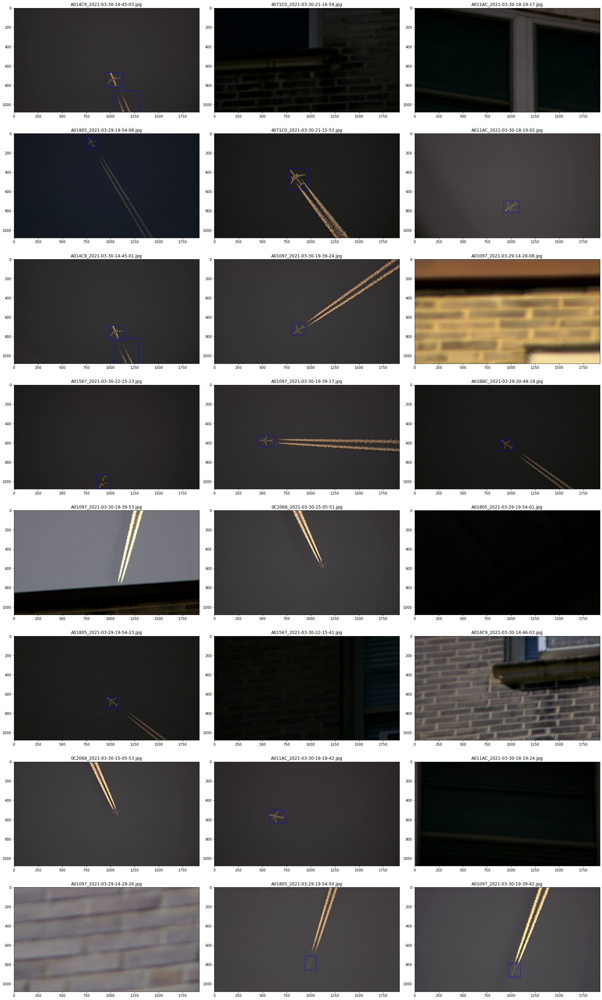

In [26]:
# view plots
outname = 'skyscan_23cat_phase1_test'
detection_thresh = 0.6
plot_dir = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 'pred_plots_' + str(detection_thresh).replace('.', 'p'))
out_path = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 'yoltv4_test_set_prediction_mosaic_thresh=' + str(detection_thresh).replace('.', 'p') + '.jpg')
print('plot_dir:', plot_dir)
print("output plot file:", out_path)
# visualize some of the yolt labels
dir_tmp = plot_dir
rows, cols = 8, 3
figsize = 8, 5
paths_tmp = sorted([os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)])
# rand_selection = paths_tmp[:rows*cols] 
rand_selection = random.sample(paths_tmp, rows*cols)
# prepend specific files to selection
prepend_selection = [
    os.path.join(dir_tmp, 'A014C9_2021-03-30-14-45-03.jpg')
    # os.path.join(dir_tmp, 'a17063_228_72_10804_2021-05-13-19-24-12.jpg'),
    # os.path.join(dir_tmp, 'a11eb7_323_67_8535_2021-05-13-18-31-12.jpg')
    ]
rand_selection = prepend_selection + rand_selection 
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize[0]*cols, figsize[1]*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = rand_selection[i]
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.set_title(im_name_tmp)

plt.tight_layout()
plt.savefig(out_path, dpi=250)
plt.show()

In [27]:
# copy results to dir_phase

dir_phase = os.path.join(data_root, 'phase1')
dir_res = os.path.join(dir_phase, 'phase1_results')
os.makedirs(dir_res, exist_ok=True)

outname = 'skyscan_23cat_phase1_test'
res_yolt_dir = os.path.join(yoltv4_path, 'darknet', 'results', outname)

!cp -r {res_yolt_dir} {dir_res}


--------
# Phase2

#### We've now established bounding boxes for the images.  Let us create labels with the bounding boxes from phase1, using the csv with aircraft type. 

### Let's split the data into train and test. 

Each aircraft is obseved in a low-hertz video, so random shuffling of train/test does not work.  Instead reserve unique aircraft for train/test.   For example, in the image: a1a3a9_211_71_11522_2021-05-13-23-23-45.jpg, I assume "a1a3a9" is unique to that aircraft and so all files that start with "a1a3a9" are part of that observation track.

In [29]:
# Get the csv of the category labels  for each image in the new, larger dataset
df_cats_path = os.path.join(data_root, 'phase1', 'csvs', 'df_image_cats.csv')
df_cats = pd.read_csv(df_cats_path)

# remove training ims
df_cats = df_cats[~df['file'].isin(list(df_phase0_train_set))]
df_cats

,file,category,prefix,category_str
0,0C2068_2021-03-30-15-04-19,5,0C2068,737-800
1,0C2068_2021-03-30-15-04-20,5,0C2068,737-800
2,0C2068_2021-03-30-15-04-21,5,0C2068,737-800
3,0C2068_2021-03-30-15-04-22,5,0C2068,737-800
4,0C2068_2021-03-30-15-04-23,5,0C2068,737-800
...,...,...,...,...
24591,ac79c7_343_54_11860_2021-05-13-23-15-35,13,ac79c7,A319
24592,ac79c7_343_55_11747_2021-05-13-23-15-36,13,ac79c7,A319
24593,ac79c7_344_53_12119_2021-05-13-23-15-33,13,ac79c7,A319
24594,ac79c7_344_54_12006_2021-05-13-23-15-34,13,ac79c7,A319


In [30]:
# Split into train and test

# For now let's just assign the first or last quarter as test for each sequence (group by prefix)

test_frac = 0.25
im_ext = '.jpg'
input_dir = os.path.join(data_root, 'raw_init', 'data')

dir_phase = os.path.join(data_root, 'phase2')
print("dir_phase:", dir_phase)
dir_txt = os.path.join(dir_phase, 'txt')
dir_train = os.path.join(dir_phase, 'train')
dir_test = os.path.join(dir_phase, 'test')

# group by seqence (prefix)
train_list, test_list = [], []
grouped = df_cats.groupby('prefix')
for name, group in grouped:
    # print("prefix:", name)
    # sort by file name, which means it's sorted by time
    # group_sort = group.sort_values('file')

    # split the files into train and test
    # sort by file name, which means it's sorted by time
    files = sorted(group['file'].values)

    # randomly decide if first or last portion is train
    rand = random.randint(0,1)
    if rand == 0:
        # train is first portion
        N_split = int( len(files) * (1 - test_frac) )
        train_list.extend(files[:N_split])
        test_list.extend(files[N_split:])
    else:
        # test is first portion
        N_split = int( len(files) * test_frac) 
        test_list.extend(files[:N_split])
        train_list.extend(files[N_split:])

# save splits, but don't overwrite!
if not os.path.exists(dir_train):
    # make directories
    for d in [dir_train, dir_test]:
        os.makedirs(os.path.join(d, 'images'))
        os.makedirs(os.path.join(d, 'labels'))
        os.makedirs(os.path.join(d, 'txt'))
    # move to approriate dirs
    for im_name in train_list:
        im_path = os.path.join(input_dir, im_name + im_ext)
        shutil.copy(im_path, os.path.join(dir_train, 'images'))
    for im_name in test_list:
        im_path = os.path.join(input_dir, im_name + im_ext)
        shutil.copy(im_path, os.path.join(dir_test, 'images'))

else:
    print("Data already randomly split between test and train, re-splitting would corrupt models")

dir_phase: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2
Data already randomly split between test and train, re-splitting would corrupt models


In [31]:
# explore how to create dicts from dfs
df_cats_path = os.path.join(data_root, 'phase1', 'csvs', 'df_image_cats.csv')
df_cats = pd.read_csv(df_cats_path, index_col=0) 
# dict of type: {'category': {'a06bd3_192_49_14384_2021-05-13-12-30-04': 5, ...}}
type_dict = df_cats['category'].to_dict()
type_dict

{'0C2068_2021-03-30-15-04-19': 5,
 '0C2068_2021-03-30-15-04-20': 5,
 '0C2068_2021-03-30-15-04-21': 5,
 '0C2068_2021-03-30-15-04-22': 5,
 '0C2068_2021-03-30-15-04-23': 5,
 '0C2068_2021-03-30-15-04-24': 5,
 '0C2068_2021-03-30-15-04-25': 5,
 '0C2068_2021-03-30-15-04-26': 5,
 '0C2068_2021-03-30-15-04-27': 5,
 '0C2068_2021-03-30-15-04-28': 5,
 '0C2068_2021-03-30-15-04-29': 5,
 '0C2068_2021-03-30-15-04-30': 5,
 '0C2068_2021-03-30-15-04-31': 5,
 '0C2068_2021-03-30-15-04-32': 5,
 '0C2068_2021-03-30-15-04-33': 5,
 '0C2068_2021-03-30-15-04-34': 5,
 '0C2068_2021-03-30-15-04-36': 5,
 '0C2068_2021-03-30-15-04-37': 5,
 '0C2068_2021-03-30-15-04-38': 5,
 '0C2068_2021-03-30-15-04-39': 5,
 '0C2068_2021-03-30-15-04-40': 5,
 '0C2068_2021-03-30-15-04-41': 5,
 '0C2068_2021-03-30-15-04-42': 5,
 '0C2068_2021-03-30-15-04-43': 5,
 '0C2068_2021-03-30-15-04-44': 5,
 '0C2068_2021-03-30-15-04-45': 5,
 '0C2068_2021-03-30-15-04-46': 5,
 '0C2068_2021-03-30-15-04-47': 5,
 '0C2068_2021-03-30-15-04-48': 5,
 '0C2068_2021-

In [35]:
# Now build up labels 
# Assume a single aircraft per image!

# read in label csv
df_cats_path = os.path.join(data_root, 'phase1', 'csvs', 'df_image_cats.csv')
df_cats = pd.read_csv(df_cats_path, index_col=0) 
# dict of type: {'category': {'a06bd3_192_49_14384_2021-05-13-12-30-04': 5, ...}}
type_dict = df_cats['category'].to_dict()
# type_dict = df_cats.to_dict()

# read in bounding box predictions 
dir_res = os.path.join(data_root, 'phase1', 'phase1_results', 'skyscan_23cat_phase1_test')
bbox_path = os.path.join(dir_res, 'preds_refine_0p6.csv')
df_bbox = pd.read_csv(bbox_path, index_col=['im_name'])
good_ims = set(df_bbox.index)  # images with a detected airplane

dir_phase = os.path.join(data_root, 'phase2')

# make yolt coords and a total csv 
im_ext = '.jpg'
pops = ['train', 'test']
for pop in pops:
    print("\n{}\n".format(pop))
    dir_tmp = os.path.join(dir_phase, pop)
    im_dir_tmp = os.path.join(dir_tmp, 'images')
    label_dir_tmp = os.path.join(dir_tmp, 'labels')
    txt_dir_tmp = os.path.join(dir_tmp, 'txt')
    empty_dir_tmp = os.path.join(dir_tmp, 'images_empty')
    for d in [label_dir_tmp, txt_dir_tmp, empty_dir_tmp]:
        os.makedirs(d, exist_ok=True)
    df_tot_path = os.path.join(txt_dir_tmp, 'binary_preds_refine_0p6+cats.csv')

    if not os.path.exists(df_tot_path):
        
        im_list = sorted([z for z in os.listdir(im_dir_tmp) if z.endswith(im_ext)])
        new_arr = []
        for i, im in enumerate(im_list):
            if (i % 100) == 0:
                print(i, "/", len(im_list), pop, im)

            im_root = im.split('.')[0]
            label_path = os.path.join(label_dir_tmp, im_root + '.txt')

            # get image
            im_path = os.path.join(im_dir_tmp, im)
            im = skimage.io.imread(im_path)
            h,w = im.shape[:2]

            # make sure image is in good_ims (has a detected aircraft)
            if im_root in good_ims:
                # if not os.path.exists(label_path):

                # get pixel coords
                row = df_bbox.loc[im_root]

                # Expect 22 columns. If not, it's because we have multiple entries, so take one with highest prob
                if len(row) != 22:
                    print(i, "Multiple entries for row {}, picking best one!".format(im_root))
                    # raise ValueError("Multiple entries for row, breaking! {}".format(row))
                    idx_best = np.argmax(row['prob'])
                    # print("idx_best", idx_best)
                    best_row = row.iloc[idx_best]
                    row = best_row.copy()
                    # print("best_row:", row)
                    # # need unique indexes
                    # df_tmp = row
                    # df_tmp.index = range(len(df_tmp))
                    # best_row = df_tmp.loc[df_tmp['prob'].idxmax()]
                    # print("best_row:", best_row)
                    # # reassign row
                    # break

                # get category
                cat = int(type_dict[im_root])
                # cat = int(type_dict['category'][im_root])

                box = [row['Xmin_Glob'], row['Xmax_Glob'], row['Ymin_Glob'], row['Ymax_Glob']]
                yolt_coords = prep_train.convert((w,h), box)    

                new_row = np.append(row.values, [cat])
                # print("new_row:", new_row)
                if len(new_arr) == 0:
                    new_arr = [new_row]
                else:
                    new_arr = np.concatenate((new_arr, [new_row]), axis=0)

                # save label file
                txt_outfile = open(label_path, "w")
                outstring = str(cat) + " " + " ".join([str(a) for a in yolt_coords]) + '\n'
                # print("outstring:", outstring
                txt_outfile.write(outstring)
                txt_outfile.close()     

            else:
                # empty image, move to extra dir
                !mv {im_path} {empty_dir_tmp}

        # create a new dataframe with category appended
        new_cols = list(df_bbox.columns.values) + ['aircraft_type']
        print("new_cols:", new_cols)
        # z = np.array(new_arr)
        # print(z)
        df_new = pd.DataFrame(np.array(new_arr), columns=new_cols)
        df_new.to_csv(df_tot_path)



train


test



name_dict: {0: 'Cessna_Jet', 1: '737-700', 2: 'A321', 3: '737-900', 4: 'ERJ-170', 5: '737-800', 6: 'A320', 7: 'EMB-505', 8: 'CRJ900', 9: '757-200', 10: 'CRJ550', 11: 'EMB-135', 12: 'Gulfstream', 13: 'A319', 14: 'Bombardier_Challanger', 15: 'CRJ700', 16: 'Learjet_45slash60', 17: 'Pilatus_PC-12', 18: '787-800', 19: 'Hawker', 20: 'Falcon', 21: '777-200', 22: 'King_Air'}
show test geom...


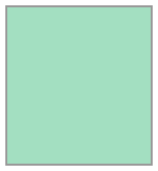

Show gdf.head()...


,Unnamed: 0.1,prob,Xmin,Ymin,Xmax,Ymax,category_phase1,im_name_root,image_path,Image_Root,...,Pad,Im_Width,Im_Height,Xmin_Glob,Xmax_Glob,Ymin_Glob,Ymax_Glob,aircraft_type,geometry,category
0,0,0.993834,835.098083,527.095642,981.040344,685.618347,aircraft,0C2068_2021-03-30-15-04-38,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,0C2068_2021-03-30-15-04-38.0C2068_2021-03-30-1...,...,0.0,0.0,0.0,835.098083,981.040344,527.095642,685.618347,5,"POLYGON ((981.040 527.096, 981.040 685.618, 83...",737-800
1,16,0.830155,909.780273,409.518738,1063.374146,569.880188,aircraft,0C2068_2021-03-30-15-04-40,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,0C2068_2021-03-30-15-04-40.0C2068_2021-03-30-1...,...,0.0,0.0,0.0,909.780273,1063.374146,409.518738,569.880188,5,"POLYGON ((1063.374 409.519, 1063.374 569.880, ...",737-800
2,27,0.875430,958.769226,385.259644,1097.986206,518.639832,aircraft,0C2068_2021-03-30-15-04-41,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,0C2068_2021-03-30-15-04-41.0C2068_2021-03-30-1...,...,0.0,0.0,0.0,958.769226,1097.986206,385.259644,518.639832,5,"POLYGON ((1097.986 385.260, 1097.986 518.640, ...",737-800
3,40,0.819065,931.143372,319.536804,1076.330566,492.847656,aircraft,0C2068_2021-03-30-15-04-42,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,0C2068_2021-03-30-15-04-42.0C2068_2021-03-30-1...,...,0.0,0.0,0.0,931.143372,1076.330566,319.536804,492.847656,5,"POLYGON ((1076.331 319.537, 1076.331 492.848, ...",737-800
4,51,0.851258,955.286865,282.359741,1101.602783,439.783325,aircraft,0C2068_2021-03-30-15-04-43,/local_data/cosmiq/wdata/avanetten/skyscan/dat...,0C2068_2021-03-30-15-04-43.0C2068_2021-03-30-1...,...,0.0,0.0,0.0,955.286865,1101.602783,282.359741,439.783325,5,"POLYGON ((1101.603 282.360, 1101.603 439.783, ...",737-800


Save to file /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/txt/binary_preds_refine_0p6+cats.geojson


In [36]:
# save testing csv to gdf in pixel coords

dir_phase = os.path.join(data_root, 'phase2')
dir_tmp = os.path.join(dir_phase, 'test')
txt_dir_tmp = os.path.join(dir_tmp, 'txt')
df_tot_path = os.path.join(txt_dir_tmp, 'binary_preds_refine_0p6+cats.csv')
outfile_gdf = os.path.join(txt_dir_tmp, 'binary_preds_refine_0p6+cats.geojson')

df = pd.read_csv(df_tot_path)
# print("Showing:", df_tot_path)
# display(df)
# rename 'category'
df.rename(columns={"category": "category_phase1"}, inplace=True)

# get category names
name_path = os.path.join(data_root, 'phase2', 'train', 'txt', 'skyscan_phase2_23cat.names')
# create dict of integer to names
name_dict = {}
with open(name_path) as f:
    for i,line in enumerate(f):
        name_dict[int(i)] = line.strip()
print("name_dict:", name_dict)

# create geometry col from pixel coords, also make column
# turn diamond into bbox
# shapely.geometry.box(minx, miny, maxx, maxy, ccw=True)
geoms = []
makes = []
for idx,row in df.iterrows():
    geom_tmp = shapely.geometry.box(row['Xmin_Glob'], row['Ymin_Glob'], row['Xmax_Glob'], row['Ymax_Glob'] )
    geoms.append(geom_tmp)
    makes.append(name_dict[row['aircraft_type']])
df['geometry'] = geoms
df['category'] = makes

# check that geom was created
print("show test geom...")
display(df.iloc[0]['geometry'])

# drop dumb unnamed col
df.drop(columns=['Unnamed: 0'], inplace=True)
# df.drop(columns=['Unnamed: 0.1'], inplace=True)

# make gdf
gdf_pix = gpd.GeoDataFrame(df)

print("Show gdf.head()...")
display(gdf_pix.head())

# df_test_fine_tune
print("Save to file {}".format(outfile_gdf))
gdf_pix.to_file(outfile_gdf, driver='GeoJSON')


In [38]:
# finally, make a gdf_pix for each image, necessary for eval

txt_dir_tmp = os.path.join(data_root, 'phase2', 'test', 'txt')
out_dir_gdf = os.path.join(txt_dir_tmp, 'geojsons_pix')
os.makedirs(out_dir_gdf, exist_ok=True)
im_names = sorted(np.unique(gdf_pix['im_name_root']))
for i, im_name in enumerate(im_names):
    outfile_gdf = os.path.join(out_dir_gdf, im_name + '.geojson')
    gdf_pix_tmp = gdf_pix[gdf_pix['im_name_root'] == im_name]
    print(i, "/", len(im_names), im_name, "len =", len(gdf_pix_tmp))
    # print("unique makes:", np.unique(gdf_pix_tmp['make']))
    gdf_pix_tmp.to_file(outfile_gdf, driver='GeoJSON')
  

0 / 2400 0C2068_2021-03-30-15-04-38 len = 1
1 / 2400 0C2068_2021-03-30-15-04-40 len = 1
2 / 2400 0C2068_2021-03-30-15-04-41 len = 1
3 / 2400 0C2068_2021-03-30-15-04-42 len = 1
4 / 2400 0C2068_2021-03-30-15-04-43 len = 1
5 / 2400 0C2068_2021-03-30-15-04-44 len = 1
6 / 2400 0C2068_2021-03-30-15-04-45 len = 1
7 / 2400 0C2068_2021-03-30-15-04-46 len = 1
8 / 2400 0C2068_2021-03-30-15-04-47 len = 1
9 / 2400 406F3B_2021-03-30-18-26-38 len = 1
10 / 2400 4071C0_2021-03-29-21-52-00 len = 1
11 / 2400 4071C0_2021-03-29-21-52-01 len = 1
12 / 2400 4071C0_2021-03-29-21-52-02 len = 1
13 / 2400 4071C0_2021-03-29-21-52-03 len = 1
14 / 2400 4071C0_2021-03-29-21-52-04 len = 1
15 / 2400 4071C0_2021-03-29-21-52-05 len = 1
16 / 2400 4071C0_2021-03-29-21-52-06 len = 1
17 / 2400 4071C0_2021-03-29-21-52-07 len = 1
18 / 2400 4071C0_2021-03-29-21-52-08 len = 1
19 / 2400 4071C0_2021-03-29-21-52-09 len = 1
20 / 2400 4071C0_2021-03-29-21-52-10 len = 1
21 / 2400 4071C0_2021-03-29-21-52-11 len = 1
22 / 2400 4071C0_202

192 / 2400 A060AE_2021-03-29-16-30-21 len = 1
193 / 2400 A060AE_2021-03-29-16-30-22 len = 1
194 / 2400 A060AE_2021-03-29-16-30-23 len = 1
195 / 2400 A060AE_2021-03-29-16-30-24 len = 1
196 / 2400 A0681C_2021-03-30-14-29-12 len = 1
197 / 2400 A0681C_2021-03-30-14-29-14 len = 1
198 / 2400 A0681C_2021-03-30-14-29-15 len = 1
199 / 2400 A0681C_2021-03-30-14-29-16 len = 1
200 / 2400 A0681C_2021-03-30-14-29-17 len = 1
201 / 2400 A0681C_2021-03-30-14-29-18 len = 1
202 / 2400 A0681C_2021-03-30-14-29-19 len = 1
203 / 2400 A0681C_2021-03-30-14-29-20 len = 1
204 / 2400 A0681C_2021-03-30-14-29-21 len = 1
205 / 2400 A0681C_2021-03-30-14-29-22 len = 1
206 / 2400 A0681C_2021-03-30-14-29-23 len = 1
207 / 2400 A0681C_2021-03-30-14-29-24 len = 1
208 / 2400 A0681C_2021-03-30-14-29-25 len = 1
209 / 2400 A06ABA_2021-03-29-22-54-53 len = 1
210 / 2400 A06ABA_2021-03-29-22-54-54 len = 1
211 / 2400 A06ABA_2021-03-29-22-54-55 len = 1
212 / 2400 A06ABA_2021-03-29-22-54-56 len = 1
213 / 2400 A06ABA_2021-03-29-22-54

383 / 2400 A27600_2021-03-30-18-36-44 len = 1
384 / 2400 A27600_2021-03-30-18-36-45 len = 1
385 / 2400 A27600_2021-03-30-18-36-46 len = 1
386 / 2400 A287AB_2021-03-29-16-10-28 len = 1
387 / 2400 A287AB_2021-03-29-16-10-29 len = 1
388 / 2400 A287AB_2021-03-29-16-10-30 len = 1
389 / 2400 A287AB_2021-03-29-16-10-31 len = 1
390 / 2400 A287AB_2021-03-29-16-10-32 len = 1
391 / 2400 A287AB_2021-03-29-16-10-33 len = 1
392 / 2400 A287AB_2021-03-29-16-10-34 len = 1
393 / 2400 A287AB_2021-03-29-16-10-35 len = 1
394 / 2400 A287AB_2021-03-29-16-10-36 len = 1
395 / 2400 A287AB_2021-03-29-16-10-37 len = 1
396 / 2400 A287AB_2021-03-29-16-10-38 len = 1
397 / 2400 A287AB_2021-03-29-16-10-39 len = 1
398 / 2400 A287AB_2021-03-29-16-10-40 len = 1
399 / 2400 A287AB_2021-03-29-16-10-41 len = 1
400 / 2400 A287AB_2021-03-29-16-10-42 len = 1
401 / 2400 A287AB_2021-03-29-16-10-43 len = 1
402 / 2400 A28928_2021-03-29-15-23-40 len = 1
403 / 2400 A28928_2021-03-29-15-23-41 len = 1
404 / 2400 A28928_2021-03-29-15-23

570 / 2400 A3DB93_2021-03-30-14-19-30 len = 1
571 / 2400 A3DB93_2021-03-30-14-19-31 len = 1
572 / 2400 A3F133_2021-03-30-21-14-58 len = 1
573 / 2400 A3F133_2021-03-30-21-14-59 len = 1
574 / 2400 A3F133_2021-03-30-21-15-00 len = 1
575 / 2400 A3F133_2021-03-30-21-15-01 len = 1
576 / 2400 A3F133_2021-03-30-21-15-02 len = 1
577 / 2400 A3F133_2021-03-30-21-15-03 len = 1
578 / 2400 A3F133_2021-03-30-21-15-04 len = 1
579 / 2400 A3F133_2021-03-30-21-15-05 len = 1
580 / 2400 A3F133_2021-03-30-21-15-06 len = 1
581 / 2400 A3F133_2021-03-30-21-15-07 len = 1
582 / 2400 A3F133_2021-03-30-21-15-08 len = 1
583 / 2400 A3F133_2021-03-30-21-15-09 len = 1
584 / 2400 A3F133_2021-03-30-21-15-10 len = 1
585 / 2400 A3F133_2021-03-30-21-15-12 len = 1
586 / 2400 A3F133_2021-03-30-21-15-20 len = 1
587 / 2400 A3F133_2021-03-30-21-15-21 len = 1
588 / 2400 A3F133_2021-03-30-21-15-22 len = 1
589 / 2400 A3F133_2021-03-30-21-15-23 len = 1
590 / 2400 A3F133_2021-03-30-21-15-24 len = 1
591 / 2400 A3F133_2021-03-30-21-15

759 / 2400 A6587B_2021-03-29-20-59-52 len = 1
760 / 2400 A6587B_2021-03-29-20-59-53 len = 1
761 / 2400 A6587B_2021-03-29-20-59-54 len = 1
762 / 2400 A6587B_2021-03-29-20-59-55 len = 1
763 / 2400 A6587B_2021-03-29-20-59-56 len = 1
764 / 2400 A6587B_2021-03-29-20-59-57 len = 1
765 / 2400 A6587B_2021-03-29-20-59-58 len = 1
766 / 2400 A6587B_2021-03-29-20-59-59 len = 1
767 / 2400 A6587B_2021-03-29-21-00-00 len = 1
768 / 2400 A6587B_2021-03-29-21-00-01 len = 1
769 / 2400 A66C99_2021-03-30-20-14-16 len = 1
770 / 2400 A67D7C_2021-03-30-16-34-50 len = 1
771 / 2400 A67D7C_2021-03-30-16-34-55 len = 1
772 / 2400 A67D7C_2021-03-30-16-34-56 len = 1
773 / 2400 A67D7C_2021-03-30-16-35-01 len = 1
774 / 2400 A69061_2021-03-29-19-42-55 len = 1
775 / 2400 A69061_2021-03-29-19-42-56 len = 1
776 / 2400 A69061_2021-03-29-19-42-57 len = 1
777 / 2400 A69061_2021-03-29-19-42-58 len = 1
778 / 2400 A69061_2021-03-29-19-42-59 len = 1
779 / 2400 A69061_2021-03-29-19-43-00 len = 1
780 / 2400 A69061_2021-03-29-19-43

938 / 2400 A72C10_2021-03-30-16-04-27 len = 1
939 / 2400 A72C10_2021-03-30-16-04-28 len = 1
940 / 2400 A72C10_2021-03-30-16-04-29 len = 1
941 / 2400 A72C10_2021-03-30-16-04-30 len = 1
942 / 2400 A72C10_2021-03-30-16-04-31 len = 1
943 / 2400 A72C10_2021-03-30-16-04-32 len = 1
944 / 2400 A72C10_2021-03-30-16-04-33 len = 1
945 / 2400 A72C10_2021-03-30-16-04-34 len = 1
946 / 2400 A72C10_2021-03-30-16-04-35 len = 1
947 / 2400 A72C10_2021-03-30-16-04-36 len = 1
948 / 2400 A72F22_2021-03-29-19-57-45 len = 1
949 / 2400 A72F22_2021-03-29-19-57-52 len = 1
950 / 2400 A74992_2021-03-29-21-41-54 len = 1
951 / 2400 A74992_2021-03-29-21-41-55 len = 1
952 / 2400 A74992_2021-03-29-21-41-56 len = 1
953 / 2400 A74992_2021-03-29-21-41-57 len = 1
954 / 2400 A74992_2021-03-29-21-41-58 len = 1
955 / 2400 A74992_2021-03-29-21-41-59 len = 1
956 / 2400 A74992_2021-03-29-21-42-00 len = 1
957 / 2400 A74992_2021-03-29-21-42-01 len = 1
958 / 2400 A74992_2021-03-29-21-42-02 len = 1
959 / 2400 A74992_2021-03-29-21-42

1126 / 2400 A81006_2021-03-30-14-48-35 len = 1
1127 / 2400 A81006_2021-03-30-14-48-36 len = 1
1128 / 2400 A81006_2021-03-30-14-48-37 len = 1
1129 / 2400 A81006_2021-03-30-14-48-38 len = 1
1130 / 2400 A81006_2021-03-30-14-48-39 len = 1
1131 / 2400 A81006_2021-03-30-14-48-40 len = 1
1132 / 2400 A81006_2021-03-30-14-48-41 len = 1
1133 / 2400 A81006_2021-03-30-14-48-42 len = 1
1134 / 2400 A81006_2021-03-30-14-48-43 len = 1
1135 / 2400 A81006_2021-03-30-14-48-44 len = 1
1136 / 2400 A81006_2021-03-30-14-48-45 len = 1
1137 / 2400 A81006_2021-03-30-14-48-46 len = 1
1138 / 2400 A81006_2021-03-30-14-48-47 len = 1
1139 / 2400 A81006_2021-03-30-14-48-48 len = 1
1140 / 2400 A81006_2021-03-30-14-48-49 len = 1
1141 / 2400 A8222C_2021-03-30-16-13-04 len = 1
1142 / 2400 A8222C_2021-03-30-16-13-06 len = 1
1143 / 2400 A8222C_2021-03-30-16-13-07 len = 1
1144 / 2400 A8222C_2021-03-30-16-13-08 len = 1
1145 / 2400 A8222C_2021-03-30-16-13-09 len = 1
1146 / 2400 A825E3_2021-03-30-17-51-26 len = 1
1147 / 2400 A

1321 / 2400 A8943D_2021-03-30-12-49-50 len = 1
1322 / 2400 A8943D_2021-03-30-12-49-51 len = 1
1323 / 2400 A8943D_2021-03-30-12-49-52 len = 1
1324 / 2400 A8943D_2021-03-30-12-49-53 len = 1
1325 / 2400 A8943D_2021-03-30-12-49-54 len = 1
1326 / 2400 A8996B_2021-03-30-13-57-22 len = 1
1327 / 2400 A8996B_2021-03-30-13-57-23 len = 1
1328 / 2400 A8996B_2021-03-30-13-57-24 len = 1
1329 / 2400 A89D22_2021-03-29-15-53-05 len = 1
1330 / 2400 A89D22_2021-03-29-15-53-06 len = 1
1331 / 2400 A89D22_2021-03-29-15-53-07 len = 1
1332 / 2400 A89D22_2021-03-29-15-53-08 len = 1
1333 / 2400 A89D22_2021-03-29-15-53-09 len = 1
1334 / 2400 A89D22_2021-03-29-15-53-10 len = 1
1335 / 2400 A89D22_2021-03-29-15-53-11 len = 1
1336 / 2400 A89D22_2021-03-29-15-53-12 len = 1
1337 / 2400 A89D22_2021-03-29-15-53-13 len = 1
1338 / 2400 A89D22_2021-03-29-15-53-14 len = 1
1339 / 2400 A89D22_2021-03-29-15-53-15 len = 1
1340 / 2400 A89D22_2021-03-29-15-53-16 len = 1
1341 / 2400 A89D22_2021-03-29-15-53-17 len = 1
1342 / 2400 A

1509 / 2400 A967AE_2021-03-29-22-21-01 len = 1
1510 / 2400 A967AE_2021-03-29-22-21-02 len = 1
1511 / 2400 A967AE_2021-03-29-22-21-03 len = 1
1512 / 2400 A967AE_2021-03-29-22-21-06 len = 1
1513 / 2400 A967AE_2021-03-29-22-21-07 len = 1
1514 / 2400 A967AE_2021-03-29-22-21-09 len = 1
1515 / 2400 A967AE_2021-03-29-22-21-11 len = 1
1516 / 2400 A967AE_2021-03-29-22-21-12 len = 1
1517 / 2400 A967AE_2021-03-29-22-21-13 len = 1
1518 / 2400 A967AE_2021-03-29-22-21-14 len = 1
1519 / 2400 A967AE_2021-03-29-22-21-15 len = 1
1520 / 2400 A967AE_2021-03-29-22-21-16 len = 1
1521 / 2400 A967AE_2021-03-29-22-21-17 len = 1
1522 / 2400 A967AE_2021-03-29-22-21-18 len = 1
1523 / 2400 A967AE_2021-03-29-22-21-19 len = 1
1524 / 2400 A967AE_2021-03-29-22-21-20 len = 1
1525 / 2400 A967AE_2021-03-29-22-21-21 len = 1
1526 / 2400 A967AE_2021-03-29-22-21-22 len = 1
1527 / 2400 A967AE_2021-03-29-22-21-23 len = 1
1528 / 2400 A967AE_2021-03-29-22-21-24 len = 1
1529 / 2400 A967AE_2021-03-29-22-21-25 len = 1
1530 / 2400 A

1685 / 2400 AA3226_2021-03-29-22-15-32 len = 1
1686 / 2400 AA3226_2021-03-29-22-15-33 len = 1
1687 / 2400 AA3226_2021-03-29-22-15-34 len = 1
1688 / 2400 AA3226_2021-03-29-22-15-35 len = 1
1689 / 2400 AA3226_2021-03-29-22-15-36 len = 1
1690 / 2400 AA3226_2021-03-29-22-15-37 len = 1
1691 / 2400 AA3226_2021-03-29-22-15-38 len = 1
1692 / 2400 AA3226_2021-03-29-22-15-39 len = 1
1693 / 2400 AA3226_2021-03-29-22-15-40 len = 1
1694 / 2400 AA3226_2021-03-29-22-15-41 len = 1
1695 / 2400 AA3226_2021-03-29-22-15-42 len = 1
1696 / 2400 AA3226_2021-03-29-22-15-43 len = 1
1697 / 2400 AA3226_2021-03-29-22-15-44 len = 1
1698 / 2400 AA3226_2021-03-29-22-15-45 len = 1
1699 / 2400 AA3226_2021-03-29-22-15-46 len = 1
1700 / 2400 AA3226_2021-03-29-22-15-47 len = 1
1701 / 2400 AA3226_2021-03-29-22-15-48 len = 1
1702 / 2400 AA3226_2021-03-29-22-15-49 len = 1
1703 / 2400 AA3226_2021-03-29-22-15-50 len = 1
1704 / 2400 AA3226_2021-03-29-22-15-51 len = 1
1705 / 2400 AA3226_2021-03-29-22-15-52 len = 1
1706 / 2400 A

1869 / 2400 ABFB99_2021-03-30-14-07-34 len = 1
1870 / 2400 ABFB99_2021-03-30-14-07-35 len = 1
1871 / 2400 ABFB99_2021-03-30-14-07-36 len = 1
1872 / 2400 ABFB99_2021-03-30-14-07-37 len = 1
1873 / 2400 ABFB99_2021-03-30-14-07-38 len = 1
1874 / 2400 ABFB99_2021-03-30-14-07-39 len = 1
1875 / 2400 ABFB99_2021-03-30-14-07-40 len = 1
1876 / 2400 ABFB99_2021-03-30-14-07-41 len = 1
1877 / 2400 ABFB99_2021-03-30-14-07-42 len = 1
1878 / 2400 ABFB99_2021-03-30-14-07-43 len = 1
1879 / 2400 ABFB99_2021-03-30-14-07-44 len = 1
1880 / 2400 ABFB99_2021-03-30-14-07-45 len = 1
1881 / 2400 AC2ACA_2021-03-30-18-36-19 len = 1
1882 / 2400 AC2ACA_2021-03-30-18-36-20 len = 1
1883 / 2400 AC2ACA_2021-03-30-18-36-21 len = 1
1884 / 2400 AC2ACA_2021-03-30-18-36-22 len = 1
1885 / 2400 AC2ACA_2021-03-30-18-36-23 len = 1
1886 / 2400 AC2ACA_2021-03-30-18-36-24 len = 1
1887 / 2400 AC2ACA_2021-03-30-18-36-25 len = 1
1888 / 2400 AC2ACA_2021-03-30-18-36-26 len = 1
1889 / 2400 AC2ACA_2021-03-30-18-36-27 len = 1
1890 / 2400 A

2035 / 2400 a186ad_209_67_10499_2021-05-13-14-32-29 len = 1
2036 / 2400 a186ad_210_68_10433_2021-05-13-14-32-28 len = 1
2037 / 2400 a186ad_211_69_10377_2021-05-13-14-32-27 len = 1
2038 / 2400 a186ad_213_69_10317_2021-05-13-14-32-26 len = 1
2039 / 2400 a186ad_215_70_10259_2021-05-13-14-32-25 len = 1
2040 / 2400 a186ad_217_71_10212_2021-05-13-14-32-24 len = 1
2041 / 2400 a186ad_219_72_10165_2021-05-13-14-32-23 len = 1
2042 / 2400 a186ad_222_73_10118_2021-05-13-14-32-22 len = 1
2043 / 2400 a186ad_225_74_10077_2021-05-13-14-32-21 len = 1
2044 / 2400 a19df2_331_65_10004_2021-05-13-15-27-09 len = 1
2045 / 2400 a19df2_332_64_10074_2021-05-13-15-27-08 len = 1
2046 / 2400 a19df2_334_63_10156_2021-05-13-15-27-07 len = 1
2047 / 2400 a19df2_335_62_10239_2021-05-13-15-27-06 len = 1
2048 / 2400 a19df2_336_61_10331_2021-05-13-15-27-05 len = 1
2049 / 2400 a19df2_337_60_10414_2021-05-13-15-27-04 len = 1
2050 / 2400 a19df2_338_58_10611_2021-05-13-15-27-02 len = 1
2051 / 2400 a19df2_338_59_10514_2021-05-

2184 / 2400 a66239_337_63_11523_2021-05-13-12-45-53 len = 1
2185 / 2400 a66239_338_62_11688_2021-05-13-12-45-51 len = 1
2186 / 2400 a66239_338_63_11602_2021-05-13-12-45-52 len = 1
2187 / 2400 a66239_339_61_11777_2021-05-13-12-45-50 len = 1
2188 / 2400 a66239_340_60_11863_2021-05-13-12-45-49 len = 1
2189 / 2400 a6a3c2_340_62_12388_2021-05-13-20-59-55 len = 1
2190 / 2400 a6a3c2_341_60_12580_2021-05-13-20-59-53 len = 1
2191 / 2400 a6a3c2_341_61_12487_2021-05-13-20-59-54 len = 1
2192 / 2400 a75ae5_244_70_12950_2021-05-13-13-57-23 len = 1
2193 / 2400 a75ae5_246_70_12919_2021-05-13-13-57-22 len = 1
2194 / 2400 a75ae5_249_71_12896_2021-05-13-13-57-21 len = 1
2195 / 2400 a75ae5_252_71_12873_2021-05-13-13-57-20 len = 1
2196 / 2400 a75ae5_254_71_12855_2021-05-13-13-57-19 len = 1
2197 / 2400 a75d7f_335_67_12503_2021-05-13-20-39-56 len = 1
2198 / 2400 a75d7f_336_66_12578_2021-05-13-20-39-55 len = 1
2199 / 2400 a75d7f_337_66_12650_2021-05-13-20-39-54 len = 1
2200 / 2400 a75d7f_338_65_12726_2021-05-

2338 / 2400 aac7ba_267_80_12366_2021-05-13-14-04-33 len = 1
2339 / 2400 aac7ba_272_80_12366_2021-05-13-14-04-32 len = 1
2340 / 2400 aac7ba_277_80_12368_2021-05-13-14-04-31 len = 1
2341 / 2400 aac7ba_282_80_12374_2021-05-13-14-04-30 len = 1
2342 / 2400 aac7ba_287_80_12381_2021-05-13-14-04-29 len = 1
2343 / 2400 aac7ba_292_80_12392_2021-05-13-14-04-28 len = 1
2344 / 2400 aac7ba_296_79_12404_2021-05-13-14-04-27 len = 1
2345 / 2400 aac7ba_300_79_12420_2021-05-13-14-04-26 len = 1
2346 / 2400 aac7ba_304_78_12438_2021-05-13-14-04-25 len = 1
2347 / 2400 aac7ba_310_77_12482_2021-05-13-14-04-23 len = 1
2348 / 2400 aac7ba_313_77_12506_2021-05-13-14-04-22 len = 1
2349 / 2400 aac7ba_315_76_12533_2021-05-13-14-04-21 len = 1
2350 / 2400 aac7ba_318_76_12565_2021-05-13-14-04-20 len = 1
2351 / 2400 aac7ba_320_75_12598_2021-05-13-14-04-19 len = 1
2352 / 2400 aac7ba_322_75_12633_2021-05-13-14-04-18 len = 1
2353 / 2400 aac7ba_324_74_12671_2021-05-13-14-04-17 len = 1
2354 / 2400 aac7ba_326_73_12711_2021-05-

In [39]:
# make plots of some of the training_bboxes
outdir_ims = os.path.join(data_root, 'phase2', 'train', 'images')
outdir_labels = os.path.join(data_root, 'phase2', 'train', 'labels')
outdir_yolt_plots = os.path.join(data_root, 'phase2', 'train', 'yolt_plot_bboxes')
max_plots = 36
shuffle = False

prep_train.plot_training_bboxes(outdir_labels, outdir_ims, 
                 ignore_augment=True,
                 figsize=(10,10), color=(0,0,255), thickness=2, 
                 max_plots=max_plots, sample_label_vis_dir=outdir_yolt_plots,
                 ext='.jpg', show_plot=False, 
                 specific_labels=[], label_dic=[], output_width=500,
                 shuffle=shuffle, verbose=False) 

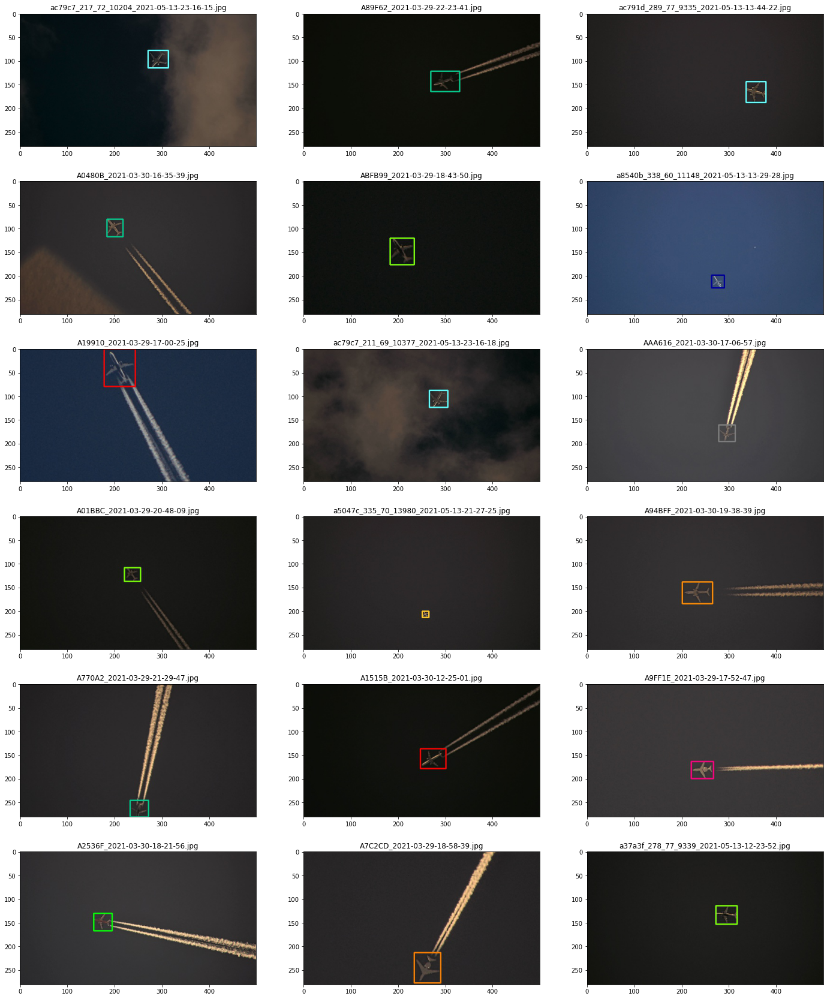

In [40]:
# visualize some of plots created in the previous cell
dir_tmp = outdir_yolt_plots
rows, cols = 6, 3
figsize = 8, 5
paths_tmp = [os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)]
rand_selection = paths_tmp[:rows*cols] #random.sample(paths_tmp, rows*cols)
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize[0]*cols, figsize[1]*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = rand_selection[i]
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.set_title(im_name_tmp)

----------
## Prep data for yoltv4 training, see:

    https://github.com/AlexeyAB/darknet
       
Put .names and .data in: 

    /local_data/cosmiq/src/avanetten/yoltv4/darknet/data
   

### Make .names (list of names for each category, in a file, in darknet/data)

In [41]:
d1 = os.path.join(data_root, 'phase2', 'train', 'txt')
outpath0 = os.path.join(d0, 'skyscan_phase2_23cat.names')
!cat {outpath0}

Cessna_Jet
737-700
A321
737-900
ERJ-170
737-800
A320
EMB-505
CRJ900
757-200
CRJ550
EMB-135
Gulfstream
A319
Bombardier_Challanger
CRJ700
Learjet_45slash60
Pilatus_PC-12
787-800
Hawker
Falcon
777-200
King_Air


### Create list of training, validation images (for use in .data file)

In [42]:
valid_iter = 5   # means every nth item is in valid set
im_ext = '.jpg'

outdir_txt = os.path.join(data_root, 'phase2', 'train', 'txt')
os.makedirs(outdir_txt, exist_ok=True)

outpath_train_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_train.txt')
outpath_valid_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_valid.txt')

if not os.path.exists(outpath_train_list):
    # yolt outputs
    outdir_ims = os.path.join(data_root, 'phase2', 'train', 'images')
    outdir_labels = os.path.join(data_root, 'phase2', 'train', 'labels')
    print("outdir_ims:", outdir_ims)

    im_list_tot = sorted([os.path.join(outdir_ims, z) for z in os.listdir(outdir_ims) if z.endswith(im_ext)])
    # shuffle!
    random.shuffle(im_list_tot)
    print("len im_list_tot:", len(im_list_tot))
    print("im_list_tot[:5]:", im_list_tot[:5])

    # make train and valid_list
    im_list_train, im_list_valid = [], []
    for i, im_path in enumerate(im_list_tot):
        if (i % valid_iter) == 0:
            im_list_valid.append(im_path)
        else:
            im_list_train.append(im_path)
    print("len im_list_train:", len(im_list_train))
    print("len im_list_valid:", len(im_list_valid))

    # create txt files of image paths
    for list_tmp, outpath_tmp in [[im_list_train, outpath_train_list], [im_list_valid, outpath_valid_list]]:
        df_tmp = pd.DataFrame({'image': list_tmp})
        df_tmp.to_csv(outpath_tmp, header=False, index=False)

    print("head", outpath_tmp, "...")
    !head {outpath_tmp}

outdir_ims: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images
len im_list_tot: 11668
im_list_tot[:5]: ['/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images/a1a3a9_338_64_12164_2021-05-13-23-23-07.jpg', '/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images/A3FBA4_2021-03-30-12-23-55.jpg', '/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images/A69061_2021-03-29-19-42-22.jpg', '/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images/AB4F5D_2021-03-29-15-27-17.jpg', '/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/images/A4C8DE_2021-03-29-19-12-35.jpg']
len im_list_train: 9334
len im_list_valid: 2334
head /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/txt/skyscan_phase2_23cat_valid.txt ...
/local_data/cosmiq/wdata/avanetten/skyscan

### Create .data files

Create file _.data in the directory build\darknet\x64\data\

Should look something like:

    classes = 1
    train  = /wdata/train.txt
    valid  = /wdata/valid.txt
    names = data/fun.names
    backup = backup/

In [43]:
#################
# create .data file
outdir_txt = os.path.join(data_root, 'phase2', 'train', 'txt')
namefile = os.path.join(outdir_txt, 'skyscan_phase2_23cat.names')
outfile = os.path.join(outdir_txt, 'skyscan_phase2_23cat_train.data')

class_num = 23
outpath_train_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_train.txt')
outpath_valid_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_valid.txt')

!echo 'classes = ' {class_num} > {outfile}
!echo 'train = ' {outpath_train_list} >> {outfile}
!echo 'valid = ' {outpath_valid_list} >> {outfile}
!echo 'names = ' {namefile} >> {outfile}
!echo 'backup = backup/' >> {outfile}

# print("\nhead:", outfile)
!cat {outfile}

# copy to yolt data dir
yolt_data_dir = os.path.join(yoltv4_path, 'darknet', 'data')
!cp {outfile} {yolt_data_dir}


classes =  23
train =  /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/txt/skyscan_phase2_23cat_train.txt
valid =  /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/txt/skyscan_phase2_23cat_valid.txt
names =  /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/train/txt/skyscan_phase2_23cat.names
backup = backup/


### Copy labels to image dir

For yolov4, images need to be in the same folder as images for training

In [44]:
outdir_ims = os.path.join(data_root, 'phase2', 'train', 'images')
outdir_labels = os.path.join(data_root, 'phase2', 'train', 'labels')
# copy
for f in os.listdir(outdir_labels):
    if f.endswith('.txt'):
        shutil.copy(os.path.join(outdir_labels, f), outdir_ims)

## Prepare testing data...

In [45]:
outdir_txt = os.path.join(data_root, 'phase2', 'test', 'txt')
outdir_ims = os.path.join(data_root, 'phase2', 'test', 'images')
outpath_test_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_test.txt')
im_ext = '.jpg'

#################
# make list of test files
im_list_test = []
for f in sorted([z for z in os.listdir(outdir_ims) if z.endswith(im_ext)]):
    im_list_test.append(os.path.join(outdir_ims, f))
df_tmp = pd.DataFrame({'image': im_list_test})
df_tmp.to_csv(outpath_test_list, header=False, index=False)
print("N test ims:", len(df_tmp))
!head {outpath_test_list}

#################
# create .data file
outdir_txt = os.path.join(data_root, 'phase2', 'test', 'txt')
namefile = os.path.join(outdir_txt, 'skyscan_phase2_23cat.names')
outfile = os.path.join(outdir_txt, 'skyscan_phase2_23cat_test.data')

class_num = 23
outpath_train_list = ''
outpath_valid_list = os.path.join(outdir_txt, 'skyscan_phase2_23cat_test.txt')

!echo 'classes = ' {class_num} > {outfile}
!echo 'train = ' {outpath_train_list} >> {outfile}
!echo 'valid = ' {outpath_valid_list} >> {outfile}
!echo 'names = ' {namefile} >> {outfile}
!echo 'backup = backup/' >> {outfile}

# print("\nhead:", outfile)
!cat {outfile}

# copy to yolt data dir
yolt_data_dir = os.path.join(yoltv4_path, 'darknet', 'data')
!cp {outfile} {yolt_data_dir}

N test ims: 2400
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-38.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-40.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-41.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-42.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-43.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-44.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-45.jpg
/local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/images/0C2068_2021-03-30-15-04-46.jpg
/local_data/cos

-----
## Data is now prepped, so proceed with setting up the cfg file and launching training

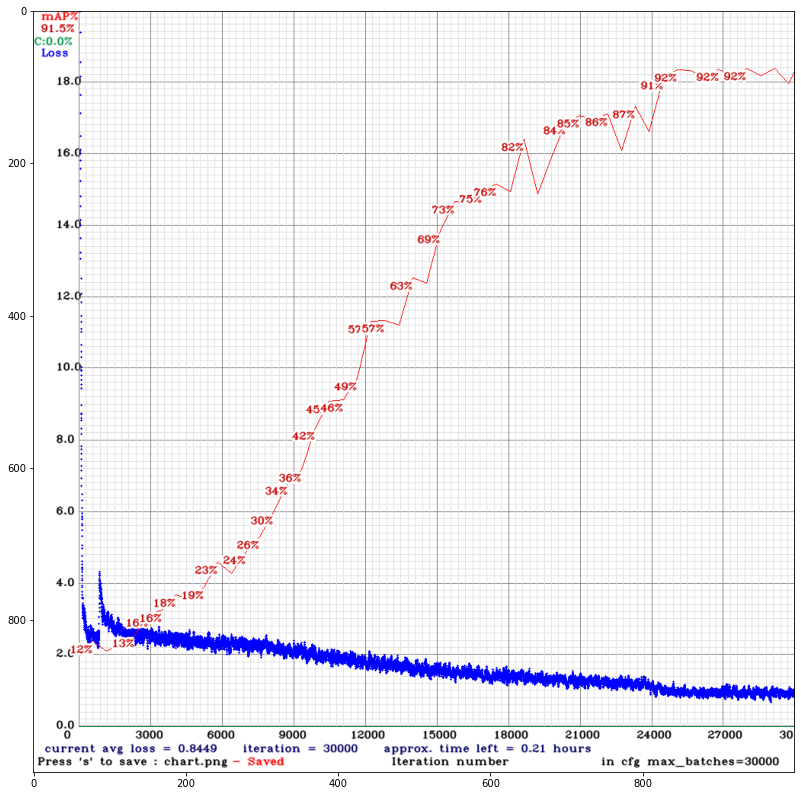

In [78]:
# view progress
f = os.path.join(yoltv4_path, 'darknet', 'chart_yoltv4_skyscan_23cat.png')
fig, ax = plt.subplots(figsize=(14,14))
_ = ax.imshow(skimage.io.imread(f))

------
------
## Test

See src/detector.c lines 1943+ for testing options

In [14]:
# post_process

reload(post_process)

raw_im_dir = os.path.join(data_root, 'phase2', 'test', 'images')
sliced_im_dir = ''  # os.path.join(data_root, 'test/yoltv4/images_slice')
truth_file = os.path.join(data_root, 'phase2', 'test', 'txt', 'binary_preds_refine_0p6+cats.geojson')

detection_threshes = [0.25]
slice_size = 0
n_plots = 2400
im_ext='.jpg'
show_labels = True
allow_nested_detections = False
outnames = [
            'skyscan_phase2_23cat' 
           ]
print("N test images:", len([z for z in os.listdir(raw_im_dir) if z.endswith(im_ext)]))
for outname in outnames:
    for detection_thresh in detection_threshes:
        out_csv = 'preds_refine_' + str(detection_thresh).replace('.', 'p') + '.csv'
        out_geojson_geo_dir = 'geojsons_geo_' + str(detection_thresh).replace('.', 'p')
        out_geojson_pix_dir = 'geojsons_pix_' + str(detection_thresh).replace('.', 'p')
        plot_dir = 'pred_plots_' + str(detection_thresh).replace('.', 'p')
        pred_txt_prefix = outname + '_'
        out_dir_root = os.path.join(yoltv4_path, 'darknet', 'results', outname)
        pred_dir = os.path.join(out_dir_root, 'orig_txt')

        # move raw predictions to output dir
        os.makedirs(os.path.join(out_dir_root, 'orig_txt'), exist_ok=True)
        !mv {yoltv4_path}/darknet/results/{outname}*.txt {out_dir_root}/orig_txt/

        # post_process
        post_process.execute(
            pred_dir=pred_dir,
            truth_file=truth_file,
            raw_im_dir=raw_im_dir,
            sliced_im_dir=sliced_im_dir,
            out_dir_root=out_dir_root,
            im_ext=im_ext,
            show_labels=show_labels,
            out_csv=out_csv,
            out_geojson_geo_dir=out_geojson_geo_dir,
            out_geojson_pix_dir=out_geojson_pix_dir,
            plot_dir=plot_dir,
            allow_nested_detections=allow_nested_detections,
            slice_size=slice_size,
            sep='__',
            pred_txt_prefix=pred_txt_prefix,
            n_plots=n_plots,
            detection_thresh=detection_thresh)

N test images: 2400
mv: cannot stat '/local_data/cosmiq/src/avanetten/yoltv4//darknet/results/skyscan_phase2_23cat*.txt': No such file or directory
df_raw.head:                       im_name      prob        Xmin        Ymin         Xmax  \
0  0C2068_2021-03-30-15-04-38  0.005076  837.475769  516.550903   969.894836   
1  0C2068_2021-03-30-15-04-40  0.108868  911.108765  409.925262  1057.050537   
2  0C2068_2021-03-30-15-04-41  0.136076  942.670471  384.118317  1093.204590   
3  0C2068_2021-03-30-15-04-42  0.119761  934.190308  312.389038  1076.266357   
4  0C2068_2021-03-30-15-04-43  0.044549  947.607727  274.862183  1086.791870   

         Ymax category  
0  699.019775  737-700  
1  556.196411  737-700  
2  541.054626  737-700  
3  483.622437  737-700  
4  419.152527  737-700  
Augmenting dataframe of initial length: 3078 ...
0
Time to augment dataframe of length: 3078 = 0.034030914306640625 seconds
Running refine_df()...
Executing non-max suppression...
  non-max suppression init b

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max 

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 3
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 2
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 3
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 2
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max sup

  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Executing non-max suppression...
  non-max suppression init boxes: 1
  non-max suppression final boxes: 1
Initial length: 3078 Final length: 2363
Time to run refine_df(): 3.5667009353637695 seconds
df_refine.columns: Index(['im_name', 'prob', 'Xmin', 'Ymin', 'Xmax', 'Ymax', 'category',
       'im_name_root', 'image_path', 'Image_Root', 'Slice_XY', 'Upper', 'Left',
       'Height', 'Width', 'Pad', 'Im_Width', 'Im_Height', 'Xmin_Glob',
       'Xmax_Glob', 'Ymin_Glob', 'Ymax_Glob'],
      dtype='object')
df_refine.head:                         im_name      prob        Xmin        Ymin  \
139  A24BF9_2021-03-29-14-03-00  0.550997  763.231079  352.304871   
141  A24BF9_2021-03-29-14-03-01  0.464045  766.380615  350.965729   
143  A24BF9_2021-03-29-14-03-03  0.377346  814.451111  421.899719   
144  A24BF9_2021-03-29

/opt/conda/envs/yoltv4/lib/python3.7/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


1 / 2400 0C2068_2021-03-30-15-04-40
 n boxes: 1
Making output plot...
2 / 2400 0C2068_2021-03-30-15-04-41
 n boxes: 1
Making output plot...
3 / 2400 0C2068_2021-03-30-15-04-42
 n boxes: 1
Making output plot...
4 / 2400 0C2068_2021-03-30-15-04-43
 n boxes: 1
Making output plot...
5 / 2400 0C2068_2021-03-30-15-04-44
 n boxes: 1
Making output plot...
6 / 2400 0C2068_2021-03-30-15-04-45
 n boxes: 1
Making output plot...
7 / 2400 0C2068_2021-03-30-15-04-46
 n boxes: 1
Making output plot...
8 / 2400 0C2068_2021-03-30-15-04-47
 n boxes: 1
Making output plot...
9 / 2400 406F3B_2021-03-30-18-26-38
 n boxes: 1
Making output plot...
10 / 2400 4071C0_2021-03-29-21-52-00
 n boxes: 2
Making output plot...
11 / 2400 4071C0_2021-03-29-21-52-01
 n boxes: 1
Making output plot...
12 / 2400 4071C0_2021-03-29-21-52-02
 n boxes: 1
Making output plot...
13 / 2400 4071C0_2021-03-29-21-52-03
 n boxes: 1
Making output plot...
14 / 2400 4071C0_2021-03-29-21-52-04
 n boxes: 1
Making output plot...
15 / 2400 4071C

118 / 2400 A027FA_2021-03-30-12-23-13
 n boxes: 1
Making output plot...
119 / 2400 A027FA_2021-03-30-12-23-14
 n boxes: 1
Making output plot...
120 / 2400 A027FA_2021-03-30-12-23-15
 n boxes: 1
Making output plot...
121 / 2400 A027FA_2021-03-30-12-23-17
 n boxes: 1
Making output plot...
122 / 2400 A02E0A_2021-03-30-16-31-01
 n boxes: 1
Making output plot...
123 / 2400 A02E0A_2021-03-30-16-31-02
 n boxes: 1
Making output plot...
124 / 2400 A02E0A_2021-03-30-16-31-03
 n boxes: 1
Making output plot...
125 / 2400 A02E0A_2021-03-30-16-31-04
 n boxes: 1
Making output plot...
126 / 2400 A02E0A_2021-03-30-16-31-05
 n boxes: 1
Making output plot...
127 / 2400 A02E0A_2021-03-30-16-31-06
 n boxes: 1
Making output plot...
128 / 2400 A02E0A_2021-03-30-16-31-07
 n boxes: 1
Making output plot...
129 / 2400 A02E0A_2021-03-30-16-31-08
 n boxes: 1
Making output plot...
130 / 2400 A02E0A_2021-03-30-16-31-09
 n boxes: 1
Making output plot...
131 / 2400 A02E0A_2021-03-30-16-31-10
 n boxes: 1
Making output 

234 / 2400 A07FA6_2021-03-30-20-11-37
 n boxes: 1
Making output plot...
235 / 2400 A07FA6_2021-03-30-20-11-38
 n boxes: 1
Making output plot...
236 / 2400 A07FA6_2021-03-30-20-11-39
 n boxes: 1
Making output plot...
237 / 2400 A07FA6_2021-03-30-20-11-40
 n boxes: 1
Making output plot...
238 / 2400 A07FA6_2021-03-30-20-11-41
 n boxes: 1
Making output plot...
239 / 2400 A07FA6_2021-03-30-20-11-42
 n boxes: 1
Making output plot...
240 / 2400 A07FA6_2021-03-30-20-11-43
 n boxes: 1
Making output plot...
241 / 2400 A07FA6_2021-03-30-20-11-44
 n boxes: 1
Making output plot...
242 / 2400 A07FA6_2021-03-30-20-11-45
 n boxes: 1
Making output plot...
243 / 2400 A07FA6_2021-03-30-20-11-46
 n boxes: 1
Making output plot...
244 / 2400 A09737_2021-03-30-19-47-25
 n boxes: 1
Making output plot...
245 / 2400 A09737_2021-03-30-19-47-26
 n boxes: 1
Making output plot...
246 / 2400 A09737_2021-03-30-19-47-27
 n boxes: 1
Making output plot...
247 / 2400 A09737_2021-03-30-19-47-28
 n boxes: 1
Making output 

348 / 2400 A21BEA_2021-03-29-23-14-31
 n boxes: 1
Making output plot...
349 / 2400 A21BEA_2021-03-29-23-14-32
 n boxes: 1
Making output plot...
350 / 2400 A21BEA_2021-03-29-23-14-33
 n boxes: 1
Making output plot...
351 / 2400 A21BEA_2021-03-29-23-14-34
 n boxes: 1
Making output plot...
352 / 2400 A21FA1_2021-03-30-14-53-52
 n boxes: 1
Making output plot...
353 / 2400 A21FA1_2021-03-30-14-53-53
 n boxes: 1
Making output plot...
354 / 2400 A21FA1_2021-03-30-14-53-54
 n boxes: 1
Making output plot...
355 / 2400 A21FA1_2021-03-30-14-53-55
 n boxes: 1
Making output plot...
356 / 2400 A21FA1_2021-03-30-14-53-56
 n boxes: 1
Making output plot...
357 / 2400 A21FA1_2021-03-30-14-53-57
 n boxes: 1
Making output plot...
358 / 2400 A21FA1_2021-03-30-14-53-58
 n boxes: 1
Making output plot...
359 / 2400 A22702_2021-03-29-20-08-12
 n boxes: 1
Making output plot...
360 / 2400 A24BF9_2021-03-29-14-02-55
 n boxes: 1
Making output plot...
361 / 2400 A24BF9_2021-03-29-14-02-58
 n boxes: 1
Making output 

 n boxes: 1
Making output plot...
464 / 2400 A302A0_2021-03-30-19-30-16
 n boxes: 1
Making output plot...
465 / 2400 A302A0_2021-03-30-19-30-17
 n boxes: 1
Making output plot...
466 / 2400 A302A0_2021-03-30-19-30-18
 n boxes: 1
Making output plot...
467 / 2400 A302A0_2021-03-30-19-30-19
 n boxes: 1
Making output plot...
468 / 2400 A302A0_2021-03-30-19-30-20
 n boxes: 1
Making output plot...
469 / 2400 A302A0_2021-03-30-19-30-21
 n boxes: 1
Making output plot...
470 / 2400 A302A0_2021-03-30-19-30-22
 n boxes: 1
Making output plot...
471 / 2400 A302A0_2021-03-30-19-30-23
 n boxes: 1
Making output plot...
472 / 2400 A302A0_2021-03-30-19-30-24
 n boxes: 1
Making output plot...
473 / 2400 A302A0_2021-03-30-19-30-25
 n boxes: 1
Making output plot...
474 / 2400 A302A0_2021-03-30-19-30-26
 n boxes: 1
Making output plot...
475 / 2400 A302A0_2021-03-30-19-30-27
 n boxes: 1
Making output plot...
476 / 2400 A302A0_2021-03-30-19-30-28
 n boxes: 1
Making output plot...
477 / 2400 A302A0_2021-03-30-1

579 / 2400 A3F133_2021-03-30-21-15-05
 n boxes: 1
Making output plot...
580 / 2400 A3F133_2021-03-30-21-15-06
 n boxes: 1
Making output plot...
581 / 2400 A3F133_2021-03-30-21-15-07
 n boxes: 1
Making output plot...
582 / 2400 A3F133_2021-03-30-21-15-08
 n boxes: 1
Making output plot...
583 / 2400 A3F133_2021-03-30-21-15-09
 n boxes: 2
Making output plot...
584 / 2400 A3F133_2021-03-30-21-15-10
 n boxes: 1
Making output plot...
585 / 2400 A3F133_2021-03-30-21-15-12
 n boxes: 1
Making output plot...
586 / 2400 A3F133_2021-03-30-21-15-20
 n boxes: 1
Making output plot...
587 / 2400 A3F133_2021-03-30-21-15-21
 n boxes: 1
Making output plot...
588 / 2400 A3F133_2021-03-30-21-15-22
 n boxes: 1
Making output plot...
589 / 2400 A3F133_2021-03-30-21-15-23
 n boxes: 1
Making output plot...
590 / 2400 A3F133_2021-03-30-21-15-24
 n boxes: 1
Making output plot...
591 / 2400 A3F133_2021-03-30-21-15-27
 n boxes: 1
Making output plot...
592 / 2400 A3F133_2021-03-30-21-15-28
 n boxes: 1
Making output 

694 / 2400 A53BA4_2021-03-30-16-46-01
 n boxes: 1
Making output plot...
695 / 2400 A53BA4_2021-03-30-16-46-02
 n boxes: 1
Making output plot...
696 / 2400 A53BA4_2021-03-30-16-46-03
 n boxes: 1
Making output plot...
697 / 2400 A53BA4_2021-03-30-16-46-04
 n boxes: 1
Making output plot...
698 / 2400 A53BA4_2021-03-30-16-46-05
 n boxes: 1
Making output plot...
699 / 2400 A53BA4_2021-03-30-16-46-06
 n boxes: 1
Making output plot...
700 / 2400 A53F5B_2021-03-29-16-53-17
 n boxes: 1
Making output plot...
701 / 2400 A53F5B_2021-03-29-16-53-18
 n boxes: 1
Making output plot...
702 / 2400 A53F5B_2021-03-29-16-53-19
 n boxes: 1
Making output plot...
703 / 2400 A53F5B_2021-03-29-16-53-20
 n boxes: 1
Making output plot...
704 / 2400 A53F5B_2021-03-29-16-53-21
 n boxes: 1
Making output plot...
705 / 2400 A53F5B_2021-03-29-16-53-22
 n boxes: 1
Making output plot...
706 / 2400 A53F5B_2021-03-29-16-53-23
 n boxes: 1
Making output plot...
707 / 2400 A53F5B_2021-03-29-16-53-24
 n boxes: 1
Making output 

810 / 2400 A6A429_2021-03-29-22-27-00
 n boxes: 1
Making output plot...
811 / 2400 A6A429_2021-03-29-22-27-01
 n boxes: 1
Making output plot...
812 / 2400 A6A429_2021-03-29-22-27-02
 n boxes: 1
Making output plot...
813 / 2400 A6A429_2021-03-29-22-27-03
 n boxes: 1
Making output plot...
814 / 2400 A6A429_2021-03-29-22-27-04
 n boxes: 1
Making output plot...
815 / 2400 A6A429_2021-03-29-22-27-05
 n boxes: 1
Making output plot...
816 / 2400 A6C39F_2021-03-30-13-52-15
 n boxes: 1
Making output plot...
817 / 2400 A6C39F_2021-03-30-13-52-16
 n boxes: 1
Making output plot...
818 / 2400 A6C39F_2021-03-30-13-52-17
 n boxes: 1
Making output plot...
819 / 2400 A6C39F_2021-03-30-13-52-18
 n boxes: 1
Making output plot...
820 / 2400 A6C39F_2021-03-30-13-52-19
 n boxes: 1
Making output plot...
821 / 2400 A6C39F_2021-03-30-13-52-20
 n boxes: 1
Making output plot...
822 / 2400 A6C39F_2021-03-30-13-52-21
 n boxes: 1
Making output plot...
823 / 2400 A6C39F_2021-03-30-13-52-22
 n boxes: 1
Making output 

925 / 2400 A72B6B_2021-03-30-21-31-30
 n boxes: 1
Making output plot...
926 / 2400 A72B6B_2021-03-30-21-31-32
 n boxes: 1
Making output plot...
927 / 2400 A72B6B_2021-03-30-21-31-33
 n boxes: 1
Making output plot...
928 / 2400 A72B6B_2021-03-30-21-31-34
 n boxes: 1
Making output plot...
929 / 2400 A72B6B_2021-03-30-21-31-35
 n boxes: 1
Making output plot...
930 / 2400 A72B6B_2021-03-30-21-31-36
 n boxes: 1
Making output plot...
931 / 2400 A72B6B_2021-03-30-21-31-37
 n boxes: 1
Making output plot...
932 / 2400 A72B6B_2021-03-30-21-31-39
 n boxes: 1
Making output plot...
933 / 2400 A72B6B_2021-03-30-21-31-40
 n boxes: 1
Making output plot...
934 / 2400 A72C10_2021-03-30-16-04-23
 n boxes: 1
Making output plot...
935 / 2400 A72C10_2021-03-30-16-04-24
 n boxes: 1
Making output plot...
936 / 2400 A72C10_2021-03-30-16-04-25
 n boxes: 1
Making output plot...
937 / 2400 A72C10_2021-03-30-16-04-26
 n boxes: 1
Making output plot...
938 / 2400 A72C10_2021-03-30-16-04-27
 n boxes: 1
Making output 

Making output plot...
1040 / 2400 A7C766_2021-03-30-17-24-57
 n boxes: 1
Making output plot...
1041 / 2400 A7C766_2021-03-30-17-24-58
 n boxes: 1
Making output plot...
1042 / 2400 A7C766_2021-03-30-17-24-59
 n boxes: 1
Making output plot...
1043 / 2400 A7C766_2021-03-30-17-25-00
 n boxes: 1
Making output plot...
1044 / 2400 A7DEF8_2021-03-29-20-50-29
 n boxes: 1
Making output plot...
1045 / 2400 A7DEF8_2021-03-29-20-50-30
 n boxes: 1
Making output plot...
1046 / 2400 A7DEF8_2021-03-29-20-50-31
 n boxes: 1
Making output plot...
1047 / 2400 A7DEF8_2021-03-29-20-50-32
 n boxes: 1
Making output plot...
1048 / 2400 A7DEF8_2021-03-29-20-50-33
 n boxes: 1
Making output plot...
1049 / 2400 A7DEF8_2021-03-29-20-50-34
 n boxes: 1
Making output plot...
1050 / 2400 A7DEF8_2021-03-29-20-50-35
 n boxes: 1
Making output plot...
1051 / 2400 A7DEF8_2021-03-29-20-50-36
 n boxes: 1
Making output plot...
1052 / 2400 A7DEF8_2021-03-29-20-50-37
 n boxes: 1
Making output plot...
1053 / 2400 A7DEF8_2021-03-29

Making output plot...
1154 / 2400 A842FF_2021-03-29-15-27-35
 n boxes: 1
Making output plot...
1155 / 2400 A842FF_2021-03-29-15-27-36
 n boxes: 1
Making output plot...
1156 / 2400 A842FF_2021-03-29-15-27-37
 n boxes: 1
Making output plot...
1157 / 2400 A842FF_2021-03-29-15-27-38
 n boxes: 1
Making output plot...
1158 / 2400 A842FF_2021-03-29-15-27-39
 n boxes: 1
Making output plot...
1159 / 2400 A842FF_2021-03-29-15-27-40
 n boxes: 1
Making output plot...
1160 / 2400 A842FF_2021-03-29-15-27-41
 n boxes: 1
Making output plot...
1161 / 2400 A842FF_2021-03-29-15-27-42
 n boxes: 1
Making output plot...
1162 / 2400 A842FF_2021-03-29-15-27-43
 n boxes: 1
Making output plot...
1163 / 2400 A842FF_2021-03-29-15-27-44
 n boxes: 1
Making output plot...
1164 / 2400 A842FF_2021-03-29-15-27-45
 n boxes: 1
Making output plot...
1165 / 2400 A842FF_2021-03-29-15-27-46
 n boxes: 1
Making output plot...
1166 / 2400 A842FF_2021-03-29-15-27-47
 n boxes: 1
Making output plot...
1167 / 2400 A842FF_2021-03-29

Making output plot...
1268 / 2400 A8847F_2021-03-29-14-06-59
 n boxes: 1
Making output plot...
1269 / 2400 A8847F_2021-03-29-14-07-00
 n boxes: 1
Making output plot...
1270 / 2400 A8847F_2021-03-29-14-07-01
 n boxes: 1
Making output plot...
1271 / 2400 A8847F_2021-03-29-14-07-02
 n boxes: 1
Making output plot...
1272 / 2400 A8847F_2021-03-29-14-07-03
 n boxes: 1
Making output plot...
1273 / 2400 A8847F_2021-03-29-14-07-04
 n boxes: 1
Making output plot...
1274 / 2400 A8847F_2021-03-29-14-07-05
 n boxes: 1
Making output plot...
1275 / 2400 A8847F_2021-03-29-14-07-06
 n boxes: 1
Making output plot...
1276 / 2400 A8847F_2021-03-29-14-07-07
 n boxes: 1
Making output plot...
1277 / 2400 A8847F_2021-03-29-14-07-08
 n boxes: 1
Making output plot...
1278 / 2400 A8847F_2021-03-29-14-07-09
 n boxes: 1
Making output plot...
1279 / 2400 A8913B_2021-03-30-13-22-22
 n boxes: 1
Making output plot...
1280 / 2400 A8913B_2021-03-30-13-22-23
 n boxes: 1
Making output plot...
1281 / 2400 A8913B_2021-03-30

1380 / 2400 A8A3CE_2021-03-30-19-27-42
 n boxes: 1
Making output plot...
1381 / 2400 A8A3CE_2021-03-30-19-27-43
 n boxes: 2
Making output plot...
1382 / 2400 A8A3CE_2021-03-30-19-27-45
 n boxes: 1
Making output plot...
1383 / 2400 A8A3CE_2021-03-30-19-27-46
 n boxes: 1
Making output plot...
1384 / 2400 A8A3CE_2021-03-30-19-27-47
 n boxes: 1
Making output plot...
1385 / 2400 A8A3CE_2021-03-30-19-27-49
 n boxes: 1
Making output plot...
1386 / 2400 A8A3CE_2021-03-30-19-27-52
 n boxes: 1
Making output plot...
1387 / 2400 A8A3CE_2021-03-30-19-27-53
 n boxes: 1
Making output plot...
1388 / 2400 A8AD4E_2021-03-30-13-00-11
 n boxes: 2
Making output plot...
1389 / 2400 A8AD4E_2021-03-30-13-00-12
 n boxes: 1
Making output plot...
1390 / 2400 A8AD4E_2021-03-30-13-00-14
 n boxes: 1
Making output plot...
1391 / 2400 A8AD4E_2021-03-30-13-00-16
 n boxes: 1
Making output plot...
1392 / 2400 A8AD4E_2021-03-30-13-00-17
 n boxes: 1
Making output plot...
1393 / 2400 A8AD4E_2021-03-30-13-00-18
 n boxes: 1


1494 / 2400 A96002_2021-03-29-15-40-30
 n boxes: 1
Making output plot...
1495 / 2400 A96002_2021-03-29-15-40-31
 n boxes: 1
Making output plot...
1496 / 2400 A96002_2021-03-29-15-40-32
 n boxes: 1
Making output plot...
1497 / 2400 A9653D_2021-03-30-22-07-59
 n boxes: 1
Making output plot...
1498 / 2400 A9653D_2021-03-30-22-08-00
 n boxes: 1
Making output plot...
1499 / 2400 A9653D_2021-03-30-22-08-01
 n boxes: 1
Making output plot...
1500 / 2400 A9653D_2021-03-30-22-08-02
 n boxes: 1
Making output plot...
1501 / 2400 A9653D_2021-03-30-22-08-03
 n boxes: 1
Making output plot...
1502 / 2400 A9653D_2021-03-30-22-08-04
 n boxes: 1
Making output plot...
1503 / 2400 A9653D_2021-03-30-22-08-07
 n boxes: 1
Making output plot...
1504 / 2400 A9653D_2021-03-30-22-08-08
 n boxes: 1
Making output plot...
1505 / 2400 A9653D_2021-03-30-22-08-10
 n boxes: 1
Making output plot...
1506 / 2400 A967AE_2021-03-29-22-20-53
 n boxes: 1
Making output plot...
1507 / 2400 A967AE_2021-03-29-22-20-57
 n boxes: 1


1608 / 2400 A9D44C_2021-03-29-21-31-29
 n boxes: 1
Making output plot...
1609 / 2400 A9D44C_2021-03-29-21-31-30
 n boxes: 1
Making output plot...
1610 / 2400 A9D44C_2021-03-29-21-31-31
 n boxes: 1
Making output plot...
1611 / 2400 A9D44C_2021-03-29-21-31-32
 n boxes: 1
Making output plot...
1612 / 2400 A9D44C_2021-03-29-21-31-33
 n boxes: 1
Making output plot...
1613 / 2400 A9D44C_2021-03-29-21-31-34
 n boxes: 1
Making output plot...
1614 / 2400 A9D44C_2021-03-29-21-31-35
 n boxes: 1
Making output plot...
1615 / 2400 A9D44C_2021-03-29-21-31-36
 n boxes: 1
Making output plot...
1616 / 2400 A9D44C_2021-03-29-21-31-37
 n boxes: 1
Making output plot...
1617 / 2400 A9D44C_2021-03-29-21-31-38
 n boxes: 1
Making output plot...
1618 / 2400 A9D44C_2021-03-29-21-31-40
 n boxes: 1
Making output plot...
1619 / 2400 A9FC34_2021-03-29-23-24-51
 n boxes: 1
Making output plot...
1620 / 2400 A9FC34_2021-03-29-23-24-52
 n boxes: 1
Making output plot...
1621 / 2400 A9FC34_2021-03-29-23-24-53
 n boxes: 1


Making output plot...
1721 / 2400 AA8A83_2021-03-29-16-09-23
 n boxes: 1
Making output plot...
1722 / 2400 AA8A83_2021-03-29-16-09-24
 n boxes: 1
Making output plot...
1723 / 2400 AA8A83_2021-03-29-16-09-25
 n boxes: 1
Making output plot...
1724 / 2400 AA8A83_2021-03-29-16-09-26
 n boxes: 1
Making output plot...
1725 / 2400 AA9801_2021-03-30-15-54-25
 n boxes: 1
Making output plot...
1726 / 2400 AA9801_2021-03-30-15-54-26
 n boxes: 1
Making output plot...
1727 / 2400 AA9801_2021-03-30-15-54-27
 n boxes: 1
Making output plot...
1728 / 2400 AA9801_2021-03-30-15-54-28
 n boxes: 1
Making output plot...
1729 / 2400 AA9801_2021-03-30-15-54-29
 n boxes: 1
Making output plot...
1730 / 2400 AA9801_2021-03-30-15-54-30
 n boxes: 1
Making output plot...
1731 / 2400 AA9801_2021-03-30-15-54-31
 n boxes: 1
Making output plot...
1732 / 2400 AA9801_2021-03-30-15-54-32
 n boxes: 1
Making output plot...
1733 / 2400 AA9801_2021-03-30-15-54-33
 n boxes: 1
Making output plot...
1734 / 2400 AAA616_2021-03-30

1834 / 2400 ABD063_2021-03-29-20-22-14
 n boxes: 1
Making output plot...
1835 / 2400 ABD063_2021-03-29-20-22-15
 n boxes: 1
Making output plot...
1836 / 2400 ABD063_2021-03-29-20-22-16
 n boxes: 1
Making output plot...
1837 / 2400 ABD063_2021-03-29-20-22-17
 n boxes: 1
Making output plot...
1838 / 2400 ABD063_2021-03-29-20-22-18
 n boxes: 1
Making output plot...
1839 / 2400 ABD063_2021-03-29-20-22-19
 n boxes: 1
Making output plot...
1840 / 2400 ABD063_2021-03-29-20-22-20
 n boxes: 1
Making output plot...
1841 / 2400 ABEE1B_2021-03-29-16-15-48
 n boxes: 1
Making output plot...
1842 / 2400 ABEE1B_2021-03-29-16-15-49
 n boxes: 1
Making output plot...
1843 / 2400 ABEE1B_2021-03-29-16-15-50
 n boxes: 1
Making output plot...
1844 / 2400 ABEE1B_2021-03-29-16-15-51
 n boxes: 1
Making output plot...
1845 / 2400 ABEE1B_2021-03-29-16-15-52
 n boxes: 1
Making output plot...
1846 / 2400 ABEE1B_2021-03-29-16-15-53
 n boxes: 1
Making output plot...
1847 / 2400 ABEE1B_2021-03-29-16-15-54
 n boxes: 1


1948 / 2400 AD34B3_2021-03-29-20-46-40
 n boxes: 1
Making output plot...
1949 / 2400 AD34B3_2021-03-29-20-46-41
 n boxes: 1
Making output plot...
1950 / 2400 AD34B3_2021-03-29-20-46-42
 n boxes: 1
Making output plot...
1951 / 2400 AD34B3_2021-03-29-20-46-43
 n boxes: 1
Making output plot...
1952 / 2400 AD34B3_2021-03-29-20-46-44
 n boxes: 1
Making output plot...
1953 / 2400 AD34B3_2021-03-29-20-46-45
 n boxes: 1
Making output plot...
1954 / 2400 AD488B_2021-03-29-20-19-55
 n boxes: 1
Making output plot...
1955 / 2400 AD488B_2021-03-29-20-19-56
 n boxes: 1
Making output plot...
1956 / 2400 AD488B_2021-03-29-20-19-57
 n boxes: 1
Making output plot...
1957 / 2400 AD488B_2021-03-29-20-19-58
 n boxes: 1
Making output plot...
1958 / 2400 AD488B_2021-03-29-20-19-59
 n boxes: 1
Making output plot...
1959 / 2400 AD5817_2021-03-30-19-21-29
 n boxes: 1
Making output plot...
1960 / 2400 AD5817_2021-03-30-19-21-32
 n boxes: 1
Making output plot...
1961 / 2400 AD5817_2021-03-30-19-21-33
 n boxes: 1


 n boxes: 1
Making output plot...
2050 / 2400 a19df2_338_58_10611_2021-05-13-15-27-02
 n boxes: 1
Making output plot...
2051 / 2400 a19df2_338_59_10514_2021-05-13-15-27-03
 n boxes: 1
Making output plot...
2052 / 2400 a1a3a9_196_57_12957_2021-05-13-23-24-02
 n boxes: 1
Making output plot...
2053 / 2400 a1a3a9_196_58_12853_2021-05-13-23-24-01
 n boxes: 1
Making output plot...
2054 / 2400 a1a3a9_197_59_12648_2021-05-13-23-23-59
 n boxes: 1
Making output plot...
2055 / 2400 a1a3a9_197_59_12752_2021-05-13-23-24-00
 n boxes: 1
Making output plot...
2056 / 2400 a1a3a9_198_60_12541_2021-05-13-23-23-58
 n boxes: 1
Making output plot...
2057 / 2400 a1a3a9_198_61_12447_2021-05-13-23-23-57
 n boxes: 1
Making output plot...
2058 / 2400 a1a3a9_199_62_12351_2021-05-13-23-23-56
 n boxes: 1
Making output plot...
2059 / 2400 a1a3a9_200_63_12256_2021-05-13-23-23-55
 n boxes: 1
Making output plot...
2060 / 2400 a1ff83_334_67_11866_2021-05-13-16-04-38
 n boxes: 1
Making output plot...
2061 / 2400 a1ff83_3

2147 / 2400 a4417d_195_58_13682_2021-05-13-12-02-12
 n boxes: 1
Making output plot...
2148 / 2400 a4417d_196_58_13581_2021-05-13-12-02-11
 n boxes: 1
Making output plot...
2149 / 2400 a4417d_196_59_13483_2021-05-13-12-02-10
 n boxes: 1
Making output plot...
2150 / 2400 a4417d_197_60_13296_2021-05-13-12-02-08
 n boxes: 1
Making output plot...
2151 / 2400 a4417d_197_60_13385_2021-05-13-12-02-09
 n boxes: 1
Making output plot...
2152 / 2400 a4417d_198_61_13206_2021-05-13-12-02-07
 n boxes: 1
Making output plot...
2153 / 2400 a4417d_198_62_13114_2021-05-13-12-02-06
 n boxes: 1
Making output plot...
2154 / 2400 a4417d_199_62_13028_2021-05-13-12-02-05
 n boxes: 1
Making output plot...
2155 / 2400 a4417d_200_63_12944_2021-05-13-12-02-04
 n boxes: 1
Making output plot...
2156 / 2400 a4417d_200_64_12865_2021-05-13-12-02-03
 n boxes: 1
Making output plot...
2157 / 2400 a4417d_201_65_12787_2021-05-13-12-02-02
 n boxes: 1
Making output plot...
2158 / 2400 a48438_306_60_7697_2021-05-13-21-58-40
Mak

2244 / 2400 a875a3_202_71_10228_2021-05-13-16-08-30
 n boxes: 1
Making output plot...
2245 / 2400 a875a3_203_72_10172_2021-05-13-16-08-29
 n boxes: 1
Making output plot...
2246 / 2400 a875a3_205_73_10117_2021-05-13-16-08-28
 n boxes: 1
Making output plot...
2247 / 2400 a875a3_207_74_10062_2021-05-13-16-08-27
 n boxes: 1
Making output plot...
2248 / 2400 a895b4_331_65_10010_2021-05-13-13-57-42
 n boxes: 1
Making output plot...
2249 / 2400 a895b4_332_64_10082_2021-05-13-13-57-41
 n boxes: 1
Making output plot...
2250 / 2400 a895b4_333_63_10153_2021-05-13-13-57-40
 n boxes: 1
Making output plot...
2251 / 2400 a895b4_334_63_10230_2021-05-13-13-57-39
 n boxes: 1
Making output plot...
2252 / 2400 a895b4_335_62_10313_2021-05-13-13-57-38
 n boxes: 1
Making output plot...
2253 / 2400 a895b4_336_61_10395_2021-05-13-13-57-37
 n boxes: 1
Making output plot...
2254 / 2400 a895b4_337_60_10480_2021-05-13-13-57-36
 n boxes: 1
Making output plot...
2255 / 2400 a895b4_338_58_10653_2021-05-13-13-57-34
 n

2340 / 2400 aac7ba_277_80_12368_2021-05-13-14-04-31
 n boxes: 1
Making output plot...
2341 / 2400 aac7ba_282_80_12374_2021-05-13-14-04-30
 n boxes: 1
Making output plot...
2342 / 2400 aac7ba_287_80_12381_2021-05-13-14-04-29
 n boxes: 1
Making output plot...
2343 / 2400 aac7ba_292_80_12392_2021-05-13-14-04-28
 n boxes: 1
Making output plot...
2344 / 2400 aac7ba_296_79_12404_2021-05-13-14-04-27
 n boxes: 1
Making output plot...
2345 / 2400 aac7ba_300_79_12420_2021-05-13-14-04-26
 n boxes: 1
Making output plot...
2346 / 2400 aac7ba_304_78_12438_2021-05-13-14-04-25
 n boxes: 1
Making output plot...
2347 / 2400 aac7ba_310_77_12482_2021-05-13-14-04-23
 n boxes: 1
Making output plot...
2348 / 2400 aac7ba_313_77_12506_2021-05-13-14-04-22
 n boxes: 1
Making output plot...
2349 / 2400 aac7ba_315_76_12533_2021-05-13-14-04-21
 n boxes: 1
Making output plot...
2350 / 2400 aac7ba_318_76_12565_2021-05-13-14-04-20
 n boxes: 1
Making output plot...
2351 / 2400 aac7ba_320_75_12598_2021-05-13-14-04-19
 n

plot_dir: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25
output plot file: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/yoltv4_test_set_prediction_mosaic_thresh=0p25.jpg


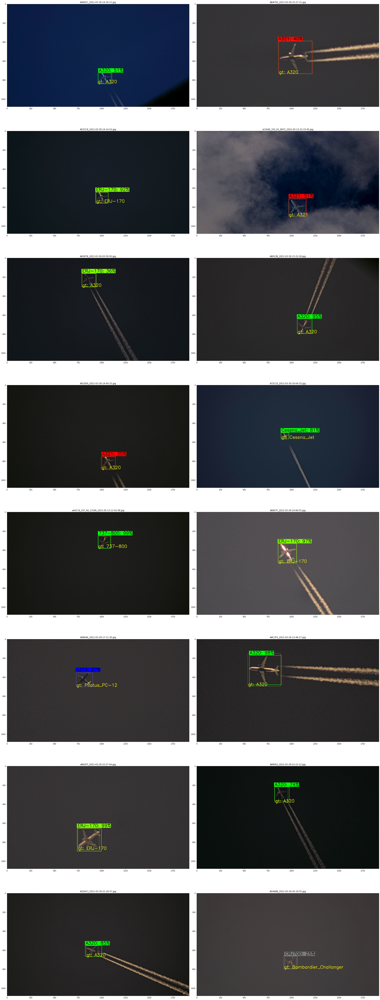

In [20]:
# view
outname = 'skyscan_phase2_23cat' 
detection_thresh = 0.25
plot_dir = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 'pred_plots_' + str(detection_thresh).replace('.', 'p'))
out_path = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 'yoltv4_test_set_prediction_mosaic_thresh=' + str(detection_thresh).replace('.', 'p') + '.jpg')
print('plot_dir:', plot_dir)
print("output plot file:", out_path)
# visualize some of the yolt labels
dir_tmp = plot_dir
rows, cols = 8, 2
figsize = 15, 10
paths_tmp = sorted([os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)])
# rand_selection = paths_tmp[:rows*cols] 
rand_selection = random.sample(paths_tmp, rows*cols)
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize[0]*cols, figsize[1]*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = rand_selection[i]
    
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.set_title(im_name_tmp)

plt.tight_layout()
plt.savefig(out_path, dpi=350)
plt.show()

## Score

In [81]:
txt_dir_tmp = os.path.join(data_root, 'phase2', 'test', 'txt')
out_dir_gdf = os.path.join(txt_dir_tmp, 'geojsons_pix')
detection_thresh = 0.25

'geojsons_pix_' + str(detection_thresh).replace('.', 'p')

# pre_train v1 (thresh=0.6 is best)
gt_polygons_dir = os.path.join(data_root, 'phase2', 'test', 'txt', 'geojsons_pix')
proposal_polygons_dir = os.path.join(yoltv4_path, 'darknet/results/skyscan_phase2_23cat/geojsons_pix_' + 
                                     str(detection_thresh).replace('.', 'p'))
print("Ground Truth:", gt_polygons_dir)
print("Prpposals:", proposal_polygons_dir, "\n")

eval.mAP_score(proposal_polygons_dir, gt_polygons_dir,
              prediction_cat_attrib="category", gt_cat_attrib='category',
              object_subset=[], threshold=0.5, confidence_attrib="prob",
              file_format="geojson")

# after 30K iterations:
# mF1: 0.4823667175854589
# mAP: 0.4163501131267369 @IOU: 0.5

# after 20K iterations:
# mF1: 0.44540982104298615
# mAP: 0.389792584867992 @IOU: 0.5

  0%|          | 2/2400 [00:00<03:22, 11.85it/s]

Ground Truth: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/txt/geojsons_pix
Prpposals: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/geojsons_pix_0p25 

getting unique objects...


  0%|          | 0/2480 [00:00<?, ?it/s]

calculating recall...


  0%|          | 0/2400 [00:00<?, ?it/s]

mRecall: 0.4589134561341387
calculating precision...


100%|██████████| 2400/2400 [09:50<00:00,  4.07it/s]

mPrecision: 0.5535753642634664
calculating F1 scores...
mF1: 0.4823667175854589
mAP: 0.4163501131267369 @IOU: 0.5



/local_data/cosmiq/src/avanetten/yoltv4/yoltv4/eval.py:514: RuntimeWarning: invalid value encountered in double_scalars
  f1 = 2 * precision * recall / (precision + recall)


(['737-700',
  '737-800',
  '737-900',
  '757-200',
  '777-200',
  '787-800',
  'A319',
  'A320',
  'A321',
  'Bombardier_Challanger',
  'CRJ550',
  'CRJ700',
  'CRJ900',
  'Cessna_Jet',
  'EMB-135',
  'EMB-505',
  'ERJ-170',
  'Falcon',
  'Gulfstream',
  'Hawker',
  'King_Air',
  'Learjet_45slash60',
  'Pilatus_PC-12'],
 0.4163501131267369,
 [0.3016423070878516,
  0.6103459190420997,
  0.2466988127384167,
  0.3564356435643564,
  0.8613861386138614,
  0.9337962367665336,
  0.514867773350842,
  0.7402870161938649,
  0.7245295471890434,
  0.13018402680604196,
  0.33663366336633666,
  0.031057391453431053,
  0.4260037580161153,
  0.37278645665390986,
  0.7219296397724879,
  0.06311881188118812,
  0.8646984581193435,
  0.0,
  0.32119827367352116,
  0.07920792079207921,
  0.25742574257425743,
  0.09900990099009901,
  0.582809163269268],
 0.4823667175854589,
 [0.35555555555555557,
  0.639080459770115,
  0.36842105263157887,
  0.48,
  0.9285714285714286,
  0.9299627020306673,
  0.614785992217

In [8]:
# bootstrap errors
txt_dir_tmp = os.path.join(data_root, 'phase2', 'test', 'txt')
out_dir_gdf = os.path.join(txt_dir_tmp, 'geojsons_pix')
detection_thresh = 0.25
N_bootstraps = 10
N_threads = 20
iou_threshold = 0.5
results_name = 'skyscan_phase2_23cat'

# pre_train v1 (thresh=0.6 is best)
gt_polygons_dir = os.path.join(data_root, 'phase2', 'test', 'txt', 'geojsons_pix')
proposal_polygons_dir = os.path.join(yoltv4_path, 'darknet', 'results', results_name, 'geojsons_pix_' + 
                                     str(detection_thresh).replace('.', 'p'))
print("Ground Truth:", gt_polygons_dir)
print("Proposals:", proposal_polygons_dir, "\n")

# bootstrap scores and stds (multi-threaded)
out_path_scores = os.path.join(yoltv4_path, 'darknet', 'results', results_name, 
                               'scores_stds_bootstrap_' + str(detection_thresh).replace('.', 'p') + '.csv')
print("out_path_scores:", out_path_scores)

t0 = time.time()
if not os.path.exists(out_path_scores):
    %timeit
    object_list, df_tot = eval_errors.mAP_bootstrap(proposal_polygons_dir, gt_polygons_dir,
                  geojson_names_subset=[],
                  prediction_cat_attrib="category", gt_cat_attrib='category',
                  object_subset=[], 
                  threshold=iou_threshold, 
                  confidence_attrib='prob',
                  file_format="geojson",
                  N_bootstraps=N_bootstraps,
                  N_threads=N_threads,
                  verbose=True)
    df_tot.to_csv(out_path_scores, index_label='idx')
    print("bootstraps saved to:", out_path_scores)
else:
    print("bootstraps already computed, located at:", out_path_scores)
    !head -1 {out_path_scores}
    !tail -2 {out_path_scores}
print("Execution time:", time.time() - t0, "seconds")

# for only 10 bootstraps:
# mF1: 0.47828520611743974
# mAP: 0.4191129920346798 
# @IOU: 0.5bootstraps saved to: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/scores_stds_bootstrap_0p25.csv
# Execution time: 4680.065406560898 seconds

Ground Truth: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/txt/geojsons_pix
Proposals: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/geojsons_pix_0p25 

out_path_scores: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/scores_stds_bootstrap_0p25.csv
bootstraps already computed, located at: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/scores_stds_bootstrap_0p25.csv
idx,mAP,mF1,737-700_AP,737-700_F1,737-800_AP,737-800_F1,737-900_AP,737-900_F1,757-200_AP,757-200_F1,777-200_AP,777-200_F1,787-800_AP,787-800_F1,A319_AP,A319_F1,A320_AP,A320_F1,A321_AP,A321_F1,Bombardier_Challanger_AP,Bombardier_Challanger_F1,CRJ550_AP,CRJ550_F1,CRJ700_AP,CRJ700_F1,CRJ900_AP,CRJ900_F1,Cessna_Jet_AP,Cessna_Jet_F1,EMB-135_AP,EMB-135_F1,EMB-505_AP,EMB-505_F1,ERJ-170_AP,ERJ-170_F1,Falcon_AP,Falcon_F1,Gulfstream_AP,Gulfstream_F1,Hawker_AP,Hawker_F1,King_Air_AP,King_Air_F1,Learjet_45slash6

In [9]:
# inspect bootstrap dataframes

results_names = ['skyscan_phase2_23cat'
                ]
thresh_strs = ['_0p25']

for results_name, thresh_str in zip(results_names, thresh_strs):
    print("\n")
    print(results_name)
    out_path_scores = os.path.join(yoltv4_path, 'darknet', 'results', 
                                   results_name, 'scores_stds_bootstrap' + thresh_str + '.csv')
    if os.path.exists(out_path_scores):
        df_tmp = pd.read_csv(out_path_scores)
        display(df_tmp.tail())
    else:
        print("  No results yet")
    print("\n")



skyscan_phase2_23cat


,idx,mAP,mF1,737-700_AP,737-700_F1,737-800_AP,737-800_F1,737-900_AP,737-900_F1,757-200_AP,...,Gulfstream_AP,Gulfstream_F1,Hawker_AP,Hawker_F1,King_Air_AP,King_Air_F1,Learjet_45slash60_AP,Learjet_45slash60_F1,Pilatus_PC-12_AP,Pilatus_PC-12_F1
7,7,0.406104,0.470469,0.325633,0.363636,0.566132,0.588235,0.267309,0.392157,0.168317,...,0.381975,0.491228,0.135314,0.285714,0.366337,0.538462,0.000000,0.000000,0.546126,0.653061
8,8,0.434187,0.485929,0.278171,0.344828,0.546343,0.594340,0.397084,0.491429,0.316832,...,0.381895,0.517241,0.039604,0.142857,0.356436,0.526316,0.336634,0.193548,0.595882,0.705882
9,9,0.425881,0.470777,0.174810,0.255814,0.669826,0.663657,0.213820,0.316667,0.257426,...,0.329703,0.439024,0.075248,0.177778,0.267327,0.416667,0.000000,0.000000,0.697332,0.792453
10,mean,0.423364,0.482838,0.300855,0.350413,0.611294,0.634935,0.245945,0.362968,0.363366,...,0.374641,0.473735,0.071403,0.171457,0.267327,0.410962,0.099010,0.079831,0.567847,0.701725
11,std,0.016747,0.017014,0.066105,0.054450,0.047398,0.038933,0.064479,0.059873,0.157315,...,0.052241,0.060534,0.039245,0.058232,0.088557,0.118735,0.126364,0.094611,0.095426,0.084453


In [10]:
# get stats for training size
im_ext = '.jpg'
train_label_path = os.path.join(data_root, 'phase2', 'train', 'images')
label_list = []
txt_files = sorted([z for z in os.listdir(train_label_path) if z.endswith('.txt')])
for i,txt_file in enumerate(txt_files):
    name_root = txt_file.split('.')[0]
    df_tmp = pd.read_csv(os.path.join(train_label_path, txt_file), sep=' ')
    # get category
    cat = int(df_tmp.columns[0])
    label_list.append([name_root, cat])

# save to csv
df = pd.DataFrame(label_list, columns=['file', 'category'])
prefixes = [z.split('_')[0] for z in df['file']]
df['prefix'] = prefixes
cat_str = [name_dict[z] for z in df['category']]
df['category_str'] = cat_str

print("categories_str")
display(df['category_str'].value_counts())

categories_str


A320                     2871
ERJ-170                  2691
A321                     1033
737-800                   976
A319                      573
737-900                   505
Cessna_Jet                468
CRJ900                    415
737-700                   322
Bombardier_Challanger     296
EMB-135                   232
Gulfstream                182
CRJ700                    180
787-800                   149
EMB-505                   128
Pilatus_PC-12             111
777-200                   110
CRJ550                    107
Learjet_45slash60         101
757-200                    74
Hawker                     73
King_Air                   37
Falcon                     34
Name: category_str, dtype: int64

Text(0.5, 1.0, 'Training Set Sizes')

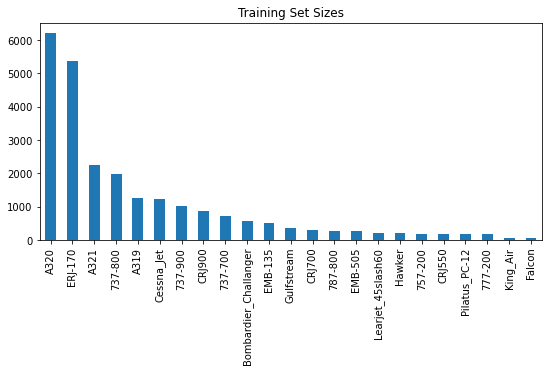

In [30]:
fig, ax = plt.subplots(figsize=(9,4))
df['category_str'].value_counts().plot(kind='bar', ax=ax)
# ax = df['category_str'].value_counts().plot(kind='bar')
ax.set_title('Training Set Sizes')

In [4]:
training_data_sizes_dict = {
'A320':                     2871,
'ERJ-170':                   2691,
'A321':                      1033,
'737-800':                    976,
'A319':                       573,
'737-900':                    505,
'Cessna_Jet':                 468,
'CRJ900':                     415,
'737-700':                    322,
'Bombardier_Challanger':      296,
'EMB-135':                    232,
'Gulfstream':                 182,
'CRJ700':                     180,
'787-800':                    149,
'EMB-505':                    128,
'Pilatus_PC-12':              111,
'777-200':                    110,
'CRJ550':                     107,
'Learjet_45slash60':          101,
'757-200':                     74,
'Hawker':                      73,
'King_Air':                    37,
'Falcon':                      34    }
# order
sorted_x = sorted(training_data_sizes_dict.items(), key=operator.itemgetter(1))
display(sorted_x)

[('Falcon', 34),
 ('King_Air', 37),
 ('Hawker', 73),
 ('757-200', 74),
 ('Learjet_45slash60', 101),
 ('CRJ550', 107),
 ('777-200', 110),
 ('Pilatus_PC-12', 111),
 ('EMB-505', 128),
 ('787-800', 149),
 ('CRJ700', 180),
 ('Gulfstream', 182),
 ('EMB-135', 232),
 ('Bombardier_Challanger', 296),
 ('737-700', 322),
 ('CRJ900', 415),
 ('Cessna_Jet', 468),
 ('737-900', 505),
 ('A319', 573),
 ('737-800', 976),
 ('A321', 1033),
 ('ERJ-170', 2691),
 ('A320', 2871)]

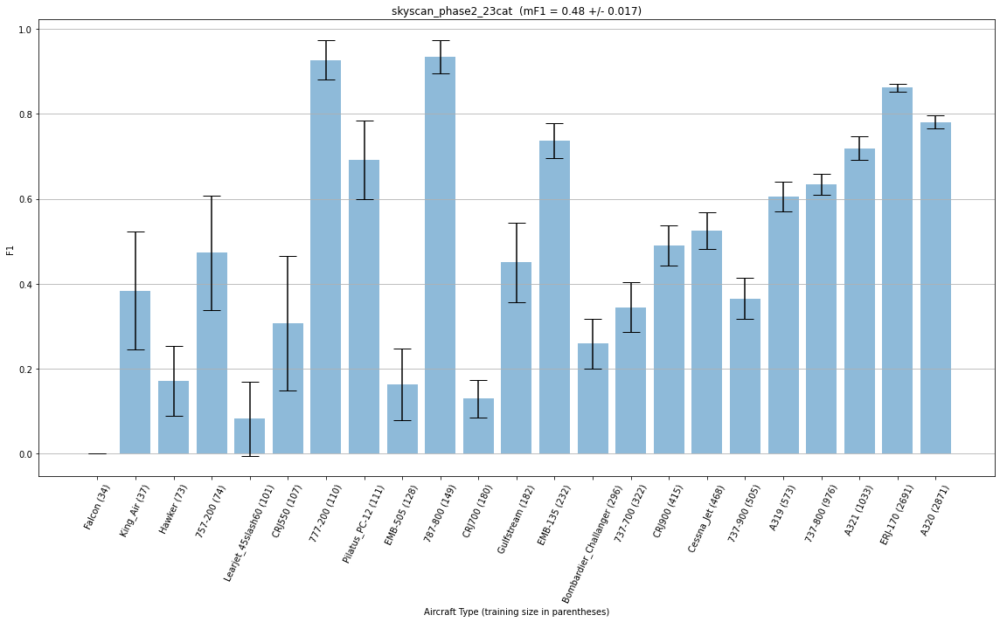

In [5]:
# Plot some results according to training set size

results_names = ['skyscan_phase2_23cat'
                ]

thresh_strs = ['_0p25']

for results_name, thresh_str in zip(results_names, thresh_strs):

    out_path_scores = os.path.join(yoltv4_path, 'darknet', 'results', 
                                   results_name, 'scores_stds_bootstrap' + thresh_str + '.csv')
    out_path_plot = os.path.join(yoltv4_path, 'darknet', 'results', results_name, 
                                 'f1s_per_class' + thresh_str + '.png')
    df_scores = pd.read_csv(out_path_scores)
    df_means = df_scores[df_scores['idx'] == 'mean'] 
    df_stds = df_scores[df_scores['idx'] == 'std'] 
    title = results_name + '  (mF1 = ' + str(np.round(df_means['mF1'].values[0], 3)) \
                + ' +/- ' + str(np.round(df_stds['mF1'].values[0], 3)) + ')'

    plot_arr = []
    for name, count in sorted_x:
        f1_tmp = df_means[name+'_F1'].values[0]
        std_tmp = df_stds[name+'_F1'].values[0]
        # print(name, count, f1_tmp, std_tmp)
        tot_name = name + ' (' + str(count) + ')'
        plot_arr.append([name, count, tot_name, f1_tmp, std_tmp])
    # display(plot_arr)

    x_pos = np.arange(len(plot_arr))
    xs = [row[2] for row in plot_arr]
    ys = [row[3] for row in plot_arr]
    err = [row[4] for row in plot_arr]

    # Build the plot
    fig, ax = plt.subplots(figsize=(16, 10))
    ax.bar(x_pos, ys, yerr=err, align='center', alpha=0.5, ecolor='black', capsize=10)
    ax.set_ylabel('F1')
    ax.set_xlabel("Aircraft Type (training size in parentheses)")
    ax.set_xticks(x_pos)
    ax.set_xticklabels(xs, rotation=65)
    ax.set_title(title)
    ax.yaxis.grid(True)

    # Save the figure and show
    plt.tight_layout()
    plt.savefig(out_path_plot, dpi=300)
    plt.show()

In [44]:
# inspect confusion matrix

reload(eval)
txt_dir_tmp = os.path.join(data_root, 'phase2', 'test', 'txt')
out_dir_gdf = os.path.join(txt_dir_tmp, 'geojsons_pix')
iou_threshold = 0.5
detection_thresh = 0.25
results_name = 'skyscan_phase2_23cat'
gt_polygons_dir = os.path.join(data_root, 'phase2', 'test', 'txt', 'geojsons_pix')
proposal_polygons_dir = os.path.join(yoltv4_path, 'darknet/results', results_name, 'geojsons_pix_' + 
                                     str(detection_thresh).replace('.', 'p'))
out_path_gdf = os.path.join(yoltv4_path, 'darknet/results', results_name, 'obj_confusion_matrix_' + 
                                     str(detection_thresh).replace('.', 'p') + '.csv')
out_path_summary = os.path.join(yoltv4_path, 'darknet/results', results_name, 'image_aggregate_stats' + 
                                     str(detection_thresh).replace('.', 'p') + '.csv')
print("Ground Truth:", gt_polygons_dir)
print("Proposals:", proposal_polygons_dir, "\n")

# # names alphabetically
# object_subset = ['737-700', '737-800', '737-900', '757-200', '777-200', 
#                  '787-800', 'A319', 'A320', 'A321', 'Bombardier_Challanger', 
#                  'CRJ550', 'CRJ700', 'CRJ900', 'Cessna_Jet', 'EMB-135', 
#                  'EMB-505', 'ERJ-170', 'Falcon', 'Gulfstream', 'Hawker', 
#                  'King_Air', 'Learjet_45slash60', 'Pilatus_PC-12']
# names by training size (least to most)
object_subset = ['Falcon', 'King_Air', 'Hawker', '757-200', 'Learjet_45slash60',
                 'CRJ550', '777-200', 'Pilatus_PC-12', 'EMB-505', '787-800',
                 'CRJ700', 'Gulfstream', 'EMB-135', 'Bombardier_Challanger',
                 '737-700', 'CRJ900', 'Cessna_Jet', '737-900', 'A319',
                 '737-800', 'A321', 'ERJ-170', 'A320']

if not os.path.exists(out_path_gdf):
    out_gdf, summary_df = eval.obj_confusion_matrix(proposal_polygons_dir, gt_polygons_dir,
                   geojson_names_subset=[],
                   prediction_cat_attrib='category', gt_cat_attrib='category', confidence_attrib='prob',
                   object_subset=object_subset, threshold=iou_threshold, file_format="geojson",
                   verbose=False)
    out_gdf.to_csv(out_path_gdf)
    summary_df.to_csv(out_path_summary)
else:
    out_gdf = gpd.read_file(out_path_gdf)
    summary_df = pd.read_csv(out_path_summary)

  0%|          | 0/2400 [00:00<?, ?it/s]

Ground Truth: /local_data/cosmiq/wdata/avanetten/skyscan/data/24596images-norm-model/phase2/test/txt/geojsons_pix
Proposals: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/geojsons_pix_0p25 

object_subset for obj_confusion_matrix(): ['Falcon', 'King_Air', 'Hawker', '757-200', 'Learjet_45slash60', 'CRJ550', '777-200', 'Pilatus_PC-12', 'EMB-505', '787-800', 'CRJ700', 'Gulfstream', 'EMB-135', 'Bombardier_Challanger', '737-700', 'CRJ900', 'Cessna_Jet', '737-900', 'A319', '737-800', 'A321', 'ERJ-170', 'A320']


100%|██████████| 2400/2400 [16:39<00:00,  2.40it/s]


labels: ['737-700', '737-800', '737-900', '757-200', '777-200', '787-800', 'A319', 'A320', 'A321', 'Bombardier_Challanger', 'CRJ550', 'CRJ700', 'CRJ900', 'Cessna_Jet', 'EMB-135', 'EMB-505', 'ERJ-170', 'Falcon', 'Gulfstream', 'Hawker', 'King_Air', 'Learjet_45slash60', 'Pilatus_PC-12', 'FP', 'FN']


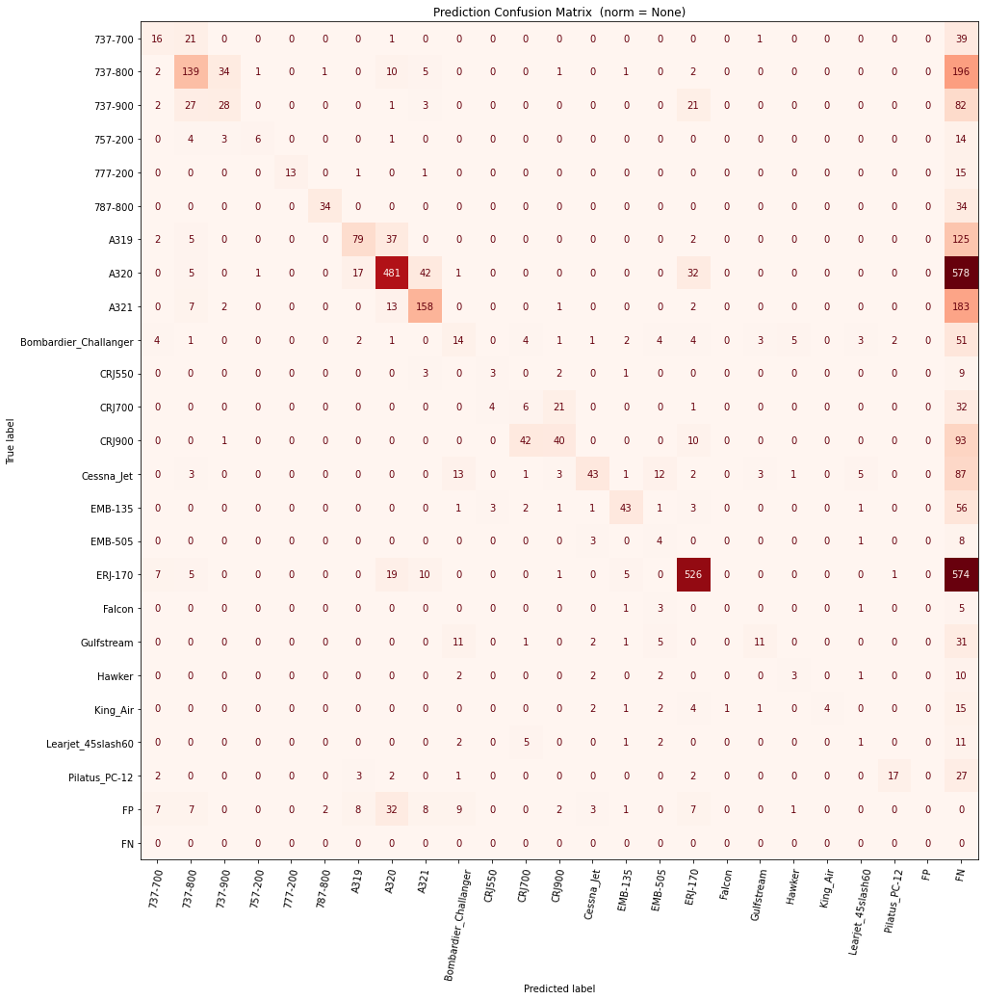

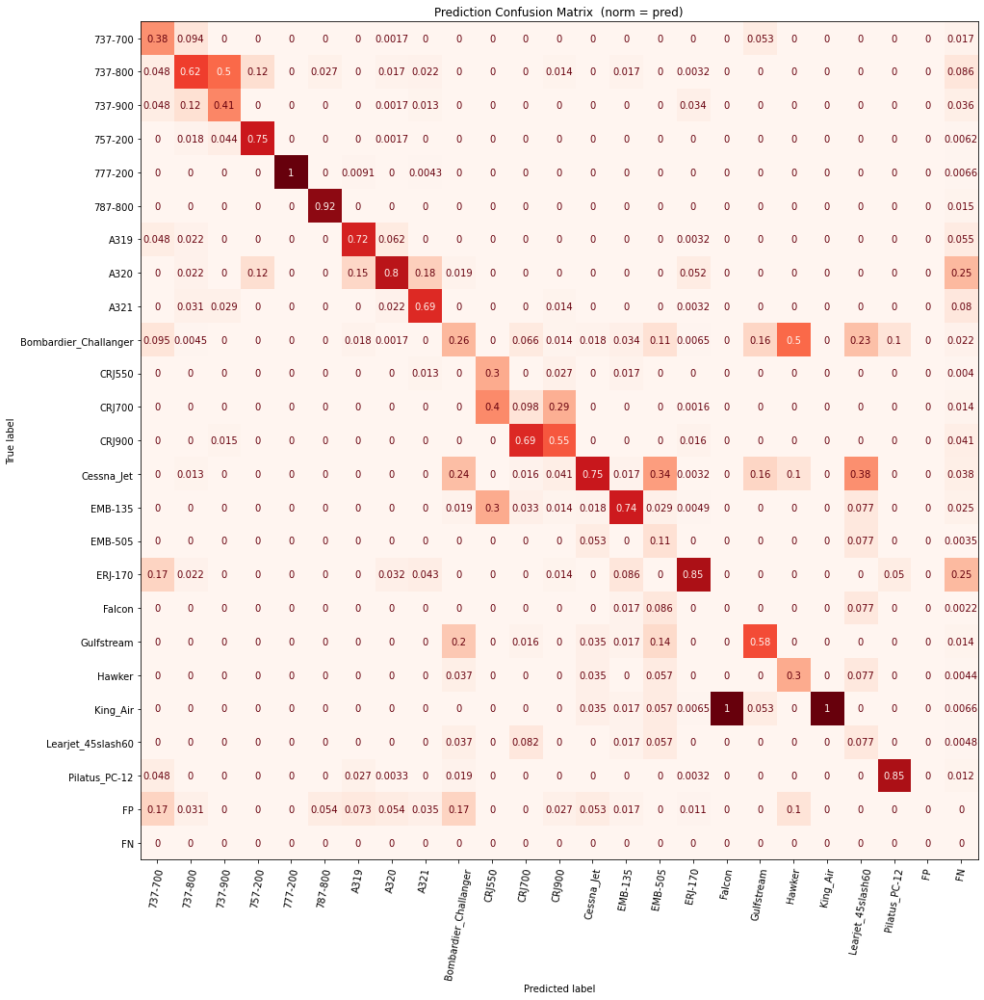

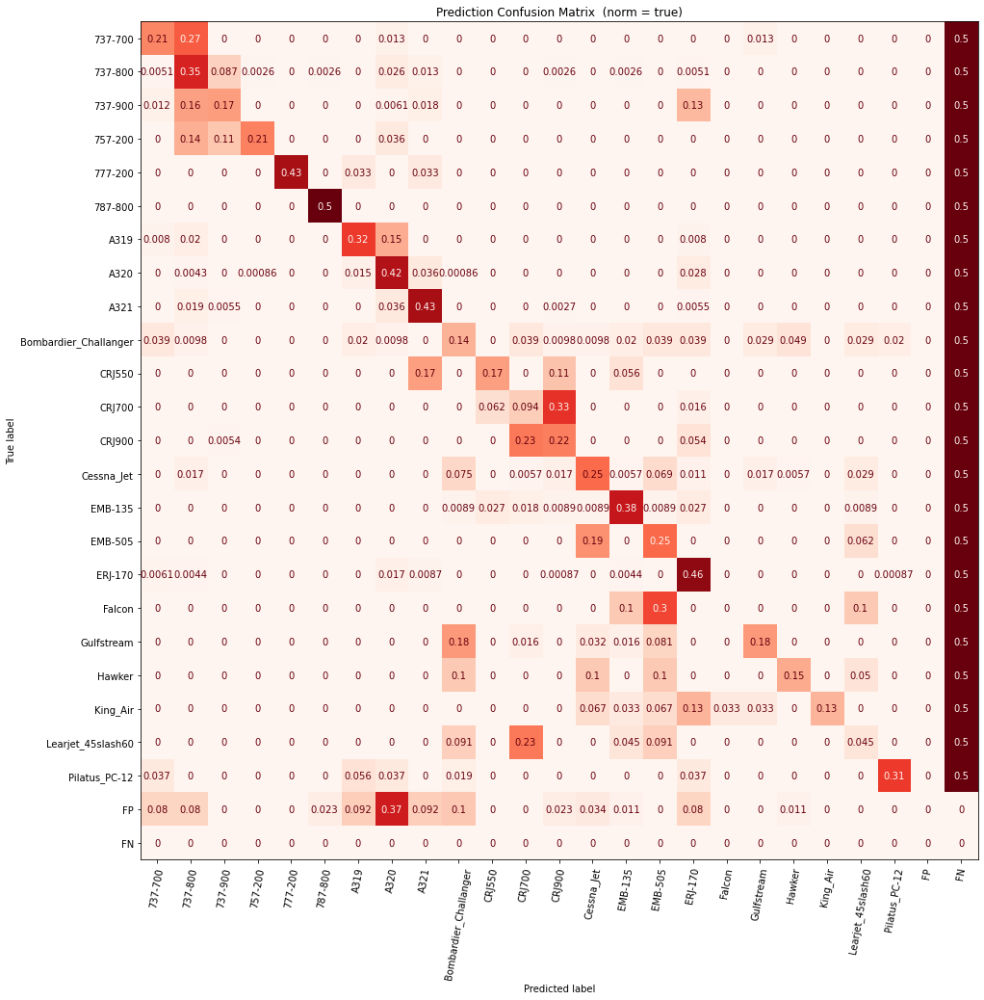

In [45]:
# view confusion matrix
eval.plot_obj_cm(out_gdf, prop_cat_col='prop_cat', gt_cat_col='gt_cat', colorbar=False, use_seaborn=False)

plot_dir: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25
output plot file: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/yoltv4_test_set_prediction_mosaic_thresh=0p25_CRJ700.jpg
path_selection: ['/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25/A66C99_2021-03-30-20-14-16.jpg', '/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25/A69061_2021-03-29-19-42-55.jpg', '/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25/A69061_2021-03-29-19-42-56.jpg', '/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25/A69061_2021-03-29-19-42-57.jpg', '/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25/A69061_2021-03-29-19-42-58.jpg', '/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/skyscan_phase2_23cat/pred_plots_0p25

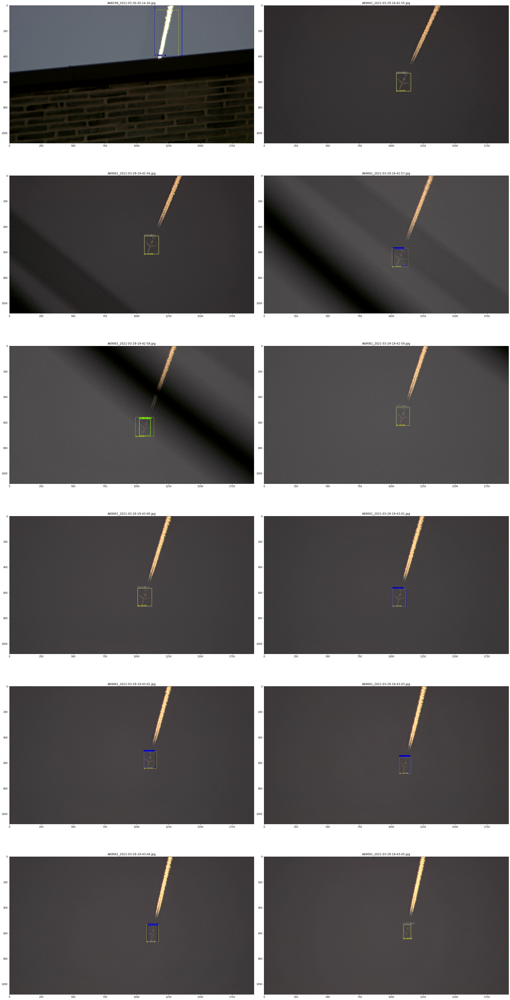

In [41]:
# now take a look at some of the classes that get confused frequently

# ['737-700', '737-800', '737-900', '757-200', '777-200', '787-800',
#        'A319', 'A320', 'A321', 'Bombardier_Challanger', 'CRJ550',
#        'CRJ700', 'CRJ900', 'Cessna_Jet', 'EMB-135', 'EMB-505', 'ERJ-170',
#        'Falcon', 'Gulfstream', 'Hawker', 'King_Air', 'Learjet_45slash60',
#        'Pilatus_PC-12']
cat_focus = 'CRJ700'

gt_label_df_loc =  os.path.join(data_root, 'phase1', 'csvs', 'df_image_cats.csv')
df_gt_labels = pd.read_csv(gt_label_df_loc, index_col=0)
# file,category,prefix,category_str
# 0C2068_2021-03-30-15-04-19,5,0C2068,737-800


# view
outname = 'skyscan_phase2_23cat' 
detection_thresh = 0.25
plot_dir = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 'pred_plots_' + str(detection_thresh).replace('.', 'p'))
out_path = os.path.join(yoltv4_path, 'darknet', 'results', 
                        outname, 
                        'yoltv4_test_set_prediction_mosaic_thresh=' + str(detection_thresh).replace('.', 'p') 
                        + '_' + cat_focus + '.jpg')
print('plot_dir:', plot_dir)
print("output plot file:", out_path)
# visualize some of the yolt labels
dir_tmp = plot_dir
rows, cols = 6, 2
figsize = 15, 10
n_plots = rows * cols

# get images with the desired ground truth category
paths_tmp = sorted([os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)])
# path_selection = paths_tmp[:rows*cols] 
# path_selection = random.sample(paths_tmp, rows*cols)

count = 0
path_selection = []
for i,p in enumerate(paths_tmp):
    root = p.split('/')[-1].split('.')[0]
    gt_cat = df_gt_labels.loc[root]['category_str']
    if gt_cat == cat_focus:
        #print(i, gt_cat)
        path_selection.append(p)
        count += 1
        if count >= n_plots:
            break
        
print("path_selection:", path_selection)
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize[0]*cols, figsize[1]*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = path_selection[i]
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.set_title(im_name_tmp)

plt.tight_layout()
plt.savefig(out_path, dpi=350)
plt.show()